In [1]:
import os
import bye_cycle
import tensorflow as tf
from tqdm import tqdm
import numpy as np
import pickle
import matplotlib.pyplot as plt

In [2]:
# Disabling tf warnings
tf.get_logger().setLevel('INFO')
# Disabling GPU
RUN_ON_GPU = True
if not RUN_ON_GPU:
    os.environ["CUDA_VISIBLE_DEVICES"] = "-1"

In [3]:
def drop_increasing_column(cycle_dataframe, column='discharge_capacity'):
    cycle_data = cycle_dataframe.copy()
#     print(len(cycle_data))
    diff = cycle_data[column] - cycle_data[column].shift(1)
    drop_indices = np.where(diff > 0)[0]
#     print(len(drop_indices))
    drop_cycle_indices = list(cycle_data['cycle_index'].iloc[drop_indices])
    cycle_data.drop(cycle_data.index[drop_indices], axis=0, inplace=True)
    return cycle_data, drop_cycle_indices

# drop_increasing_column(summary_data[0])['discharge_capacity'].is_monotonic_decreasing 
# test = summary_data[0]
def decrease_monotonically(cycle_dataframe, column='discharge_capacity', renumber_cycle_index=True):
    cycle_indices_dropped = []
    while not cycle_dataframe[column].is_monotonic_decreasing:
        cycle_dataframe, _ = drop_increasing_column(cycle_dataframe, column=column)
#         print(len(cycle_dataframe))
        cycle_indices_dropped.append(_)
    cycle_indices_dropped = [x for xs in cycle_indices_dropped for x in xs]
    if renumber_cycle_index:
        cycle_dataframe['cycle_index'] = cycle_dataframe.reset_index(drop=True).index
    return cycle_dataframe, cycle_indices_dropped



In [4]:
# read CACHED data 
# excluding all diagnostic cycles and those with increase in discharge cap, renumber based on EFC
cycle_window_size = 100
skip_window_after_diagnostic = 50
structured_data_list = []
summary_data_list = []
nominal_cell_capacity = 4.83
for i,cell_file in enumerate(tqdm(os.listdir('CACHED_DATA/pre_processed_pandas/'))):
    print(i, cell_file)
    if cell_file.startswith("Pre"):
        with open(f'CACHED_DATA/pre_processed_pandas/{cell_file}', 'rb') as f:
            structured_data, summary_data = pickle.load(f)
#         a = find_renumbedred_index(structured_data)
#         print(len(summary_data[0]))
#         break
#         equivalent_cycle_index = summary_data[0]['charge_throughput']/nominal_cell_capacity
#         summary_data[0]['cycle_index'] = equivalent_cycle_index
#         print(summary_data[0]['cycle_index'])
#         print(len(summary_data[0]))
        summary_data[0], cycle_indices_dropped = decrease_monotonically(summary_data[0])
#         print(len(summary_data[0]))
        # getting equivalent cycle index

#         break
#         print(len(summary_data[0]))
#         skipped_cycles = [list(range(m+1,m+skip_window_after_diagnostic+1)) for m in a]
#         flatten_skipped_cycles = [x for xs in skipped_cycles for x in xs]
        # check if the cell has enough cycles based on the $window_cycles_size
        if len(summary_data[0]) >= cycle_window_size * 2:
            cycle_list = []
            new_cycle_indices = []
            j = 0
            for cycle in structured_data:
                if len(cycle) > 2:
                    cycle_index_value = np.unique(cycle['cycle_index'])[0]
                    if  cycle_index_value not in cycle_indices_dropped:
                        cycle.loc[:,'cycle_index'] = j
                        cycle_list.append(cycle)
                        new_cycle_indices.append(j)
                        j += 1
#                 else:
#                     print(f'TIME-SERIES THRESHOLD ALEERT FOR {i, cell_file}')
            structured_data_list.append(cycle_list)
#             summary_data[0][summary_data[0]['summary_data[0]'] != flatten_skipped_cycles]
#             summary_data[0] = summary_data[0][~summary_data[0]['cycle_index'].isin(flatten_skipped_cycles)]
#             summary_data[0]['cycle_index'] = new_cycle_indices
            summary_data_list.append(summary_data[0])
#             print(len(summary_data_list[i]), len(structured_data_list[i]))
        else:
            print(f'NUMBER OF CYCLES THRESHOLD ALEERT FOR {i, cell_file}')
#         dat.append(cell_data)
#     if i ==2:
#         break
print('CACHED data is loaded.')

  0%|          | 0/338 [00:00<?, ?it/s]

0 PreDiag_000333_000180_structured.pkl


  0%|          | 1/338 [00:03<16:51,  3.00s/it]

1 PredictionDiagnostics_000131_00004B_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (1, 'PredictionDiagnostics_000131_00004B_structured.pkl')
2 PreDiag_000314_000196_structured.pkl


  1%|          | 3/338 [00:04<06:29,  1.16s/it]

3 PreDiag_000317_000193_structured.pkl


  1%|          | 4/338 [00:04<05:20,  1.04it/s]

4 PreDiag_000272_0000C5_structured.pkl


  1%|▏         | 5/338 [00:07<08:01,  1.45s/it]

5 PredictionDiagnostics_000170_000256_structured.pkl


  2%|▏         | 7/338 [00:07<04:13,  1.31it/s]

NUMBER OF CYCLES THRESHOLD ALEERT FOR (5, 'PredictionDiagnostics_000170_000256_structured.pkl')
6 PredictionDiagnostics_000142_000031_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (6, 'PredictionDiagnostics_000142_000031_structured.pkl')
7 PreDiag_000251_00020D_structured.pkl


  2%|▏         | 8/338 [00:11<10:27,  1.90s/it]

8 PreDiag_000374_0001D9_structured.pkl


  3%|▎         | 9/338 [00:12<07:46,  1.42s/it]

9 PreDiag_000335_00017E_structured.pkl


  3%|▎         | 10/338 [00:13<07:24,  1.35s/it]

10 PreDiag_000340_000178_structured.pkl


  3%|▎         | 11/338 [00:18<14:25,  2.65s/it]

11 PreDiag_000407_00008A_structured.pkl


  4%|▎         | 12/338 [00:19<11:18,  2.08s/it]

12 PredictionDiagnostics_000151_00001E_structured.pkl


  4%|▍         | 13/338 [00:20<08:47,  1.62s/it]

13 PredictionDiagnostics_000174_00023E_structured.pkl


  4%|▍         | 14/338 [00:20<06:57,  1.29s/it]

14 PreDiag_000234_00021D_structured.pkl


  4%|▍         | 15/338 [00:25<12:07,  2.25s/it]

15 PreDiag_000246_000217_structured.pkl


  5%|▍         | 16/338 [00:27<11:38,  2.17s/it]

16 PreDiag_000456_0001E1_structured.pkl


  5%|▌         | 17/338 [00:29<12:11,  2.28s/it]

17 PreDiag_000387_0001F1_structured.pkl


  5%|▌         | 18/338 [00:30<09:40,  1.81s/it]

18 PreDiag_000436_0000F8_structured.pkl


  6%|▌         | 19/338 [00:31<07:59,  1.50s/it]

19 PredictionDiagnostics_000181_00023A_structured.pkl


  6%|▌         | 20/338 [00:32<06:51,  1.29s/it]

20 PredictionDiagnostics_000148_000038_structured.pkl


  6%|▌         | 21/338 [00:33<06:18,  1.19s/it]

21 PreDiag_000446_000101_structured.pkl


  7%|▋         | 22/338 [00:34<07:17,  1.38s/it]

22 PreDiag_000362_000161_structured.pkl


  7%|▋         | 23/338 [00:37<08:39,  1.65s/it]

23 PreDiag_000405_000088_structured.pkl


  7%|▋         | 24/338 [00:38<08:36,  1.64s/it]

24 PredictionDiagnostics_000161_000252_structured.pkl


  7%|▋         | 25/338 [00:39<06:46,  1.30s/it]

25 PredictionDiagnostics_000162_000021_structured.pkl


  8%|▊         | 26/338 [00:39<05:11,  1.00it/s]

26 PreDiag_000420_000097_structured.pkl


  8%|▊         | 27/338 [00:40<04:27,  1.16it/s]

27 PreDiag_000375_0001F7_structured.pkl


  8%|▊         | 28/338 [00:40<03:28,  1.48it/s]

28 PreDiag_000211_000209_structured.pkl


  9%|▊         | 29/338 [00:51<19:41,  3.82s/it]

29 PredictionDiagnostics_000140_000033_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (29, 'PredictionDiagnostics_000140_000033_structured.pkl')
30 PreDiag_000400_000084_structured.pkl


  9%|▉         | 31/338 [00:51<10:56,  2.14s/it]

31 PreDiag_000199_0000DA_structured.pkl


  9%|▉         | 32/338 [00:55<12:24,  2.43s/it]

32 PreDiag_000482_0000E9_structured.pkl


 10%|▉         | 33/338 [00:57<11:44,  2.31s/it]

33 PredictionDiagnostics_000116_00003D_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (33, 'PredictionDiagnostics_000116_00003D_structured.pkl')
34 PreDiag_000477_0000EF_structured.pkl


 10%|█         | 35/338 [00:59<09:03,  1.79s/it]

35 PredictionDiagnostics_000185_000243_structured.pkl


 11%|█         | 36/338 [01:00<08:26,  1.68s/it]

36 .ipynb_checkpoints
37 PredictionDiagnostics_000110_0001BD_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (37, 'PredictionDiagnostics_000110_0001BD_structured.pkl')
38 PreDiag_000311_000199_structured.pkl


 12%|█▏        | 39/338 [01:01<04:31,  1.10it/s]

39 PreDiag_000401_000086_structured.pkl


 12%|█▏        | 40/338 [01:02<05:20,  1.08s/it]

40 PreDiag_000377_00009F_structured.pkl


 12%|█▏        | 41/338 [01:03<04:39,  1.06it/s]

41 PreDiag_000226_0001D0_structured.pkl


 12%|█▏        | 42/338 [01:05<05:30,  1.12s/it]

42 PredictionDiagnostics_000135_00002C_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (42, 'PredictionDiagnostics_000135_00002C_structured.pkl')
43 PredictionDiagnostics_000134_00002B_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (43, 'PredictionDiagnostics_000134_00002B_structured.pkl')
44 PreDiag_000223_0001A2_structured.pkl


 13%|█▎        | 45/338 [01:06<03:40,  1.33it/s]

45 PreDiag_000412_00008F_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (45, 'PreDiag_000412_00008F_structured.pkl')
46 PreDiag_000356_000167_structured.pkl


 14%|█▍        | 47/338 [01:12<07:33,  1.56s/it]

47 PreDiag_000465_0001C3_structured.pkl


 14%|█▍        | 48/338 [01:14<07:55,  1.64s/it]

48 PreDiag_000245_00021A_structured.pkl


 14%|█▍        | 49/338 [01:15<07:17,  1.51s/it]

49 PreDiag_000198_000207_structured.pkl


 15%|█▍        | 50/338 [01:18<08:44,  1.82s/it]

50 PreDiag_000324_00018A_structured.pkl


 15%|█▌        | 51/338 [01:19<07:35,  1.59s/it]

51 PreDiag_000217_00019C_structured.pkl


 16%|█▌        | 54/338 [01:32<12:09,  2.57s/it]

52 PredictionDiagnostics_000125_0001AF_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (52, 'PredictionDiagnostics_000125_0001AF_structured.pkl')
53 PredictionDiagnostics_000138_000039_structured.pkl
54 PredictionDiagnostics_000115_0001BB_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (54, 'PredictionDiagnostics_000115_0001BB_structured.pkl')
55 PreDiag_000205_00005A_structured.pkl


 17%|█▋        | 59/338 [01:32<04:32,  1.03it/s]

NUMBER OF CYCLES THRESHOLD ALEERT FOR (55, 'PreDiag_000205_00005A_structured.pkl')
56 PredictionDiagnostics_000109_0001BC_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (56, 'PredictionDiagnostics_000109_0001BC_structured.pkl')
57 PreDiag_000370_0001C9_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (57, 'PreDiag_000370_0001C9_structured.pkl')
58 PreDiag_000368_0001DE_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (58, 'PreDiag_000368_0001DE_structured.pkl')
59 PreDiag_000455_0001E0_structured.pkl


 18%|█▊        | 60/338 [01:35<05:27,  1.18s/it]

60 PreDiag_000355_000168_structured.pkl


 18%|█▊        | 61/338 [01:40<09:36,  2.08s/it]

61 PreDiag_000453_000108_structured.pkl


 18%|█▊        | 62/338 [01:43<09:49,  2.13s/it]

62 PreDiag_000261_0000C8_structured.pkl


 19%|█▊        | 63/338 [01:55<21:09,  4.62s/it]

63 PredictionDiagnostics_000175_000247_structured.pkl


 19%|█▉        | 64/338 [01:56<17:05,  3.74s/it]

64 PreDiag_000336_00017C_structured.pkl


 19%|█▉        | 65/338 [01:57<13:35,  2.99s/it]

65 PredictionDiagnostics_000154_000024_structured.pkl


 20%|█▉        | 66/338 [01:57<10:18,  2.27s/it]

66 PredictionDiagnostics_000160_000251_structured.pkl


 20%|█▉        | 67/338 [01:59<09:13,  2.04s/it]

67 PreDiag_000445_000100_structured.pkl


 20%|██        | 68/338 [02:00<07:30,  1.67s/it]

68 PreDiag_000471_00006B_structured.pkl


 20%|██        | 69/338 [02:02<07:58,  1.78s/it]

69 PreDiag_000276_0000C2_structured.pkl


 21%|██        | 70/338 [02:16<24:53,  5.57s/it]

70 PreDiag_000452_000107_structured.pkl


 21%|██        | 71/338 [02:19<20:25,  4.59s/it]

71 PreDiag_000413_000090_structured.pkl


 21%|██▏       | 72/338 [02:20<15:28,  3.49s/it]

72 PreDiag_000380_000063_structured.pkl


 22%|██▏       | 73/338 [02:20<11:16,  2.55s/it]

73 PreDiag_000473_00006D_structured.pkl


 22%|██▏       | 74/338 [02:22<10:10,  2.31s/it]

74 PreDiag_000366_0001EF_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (74, 'PreDiag_000366_0001EF_structured.pkl')
75 PredictionDiagnostics_000164_000239_structured.pkl


 22%|██▏       | 76/338 [02:22<05:41,  1.30s/it]

76 PredictionDiagnostics_000100_0001B0_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (76, 'PredictionDiagnostics_000100_0001B0_structured.pkl')
77 PreDiag_000263_0000C6_structured.pkl


 23%|██▎       | 78/338 [02:33<12:37,  2.91s/it]

78 PredictionDiagnostics_000193_00024B_structured.pkl


 23%|██▎       | 79/338 [02:37<14:14,  3.30s/it]

79 PredictionDiagnostics_000166_000246_structured.pkl


 24%|██▎       | 80/338 [02:38<11:27,  2.67s/it]

80 PredictionDiagnostics_000178_00023B_structured.pkl


 24%|██▍       | 81/338 [02:42<12:34,  2.93s/it]

81 PreDiag_000392_00010B_structured.pkl


 24%|██▍       | 82/338 [02:42<09:37,  2.26s/it]

82 PreDiag_000397_000110_structured.pkl


 25%|██▍       | 83/338 [02:43<07:46,  1.83s/it]

83 PreDiag_000334_00017F_structured.pkl


 25%|██▍       | 84/338 [02:46<09:19,  2.20s/it]

84 PreDiag_000472_00006E_structured.pkl


 25%|██▌       | 85/338 [02:47<08:30,  2.02s/it]

85 PreDiag_000418_000095_structured.pkl


 25%|██▌       | 86/338 [02:48<06:40,  1.59s/it]

86 PreDiag_000415_000092_structured.pkl


 26%|██▌       | 87/338 [02:49<05:32,  1.32s/it]

87 PredictionDiagnostics_000122_000043_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (87, 'PredictionDiagnostics_000122_000043_structured.pkl')
88 PreDiag_000322_0001D5_structured.pkl


 26%|██▋       | 89/338 [02:53<06:42,  1.62s/it]

89 PredictionDiagnostics_000137_00002F_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (89, 'PredictionDiagnostics_000137_00002F_structured.pkl')
90 PreDiag_000213_0001CF_structured.pkl


 27%|██▋       | 91/338 [03:06<15:05,  3.67s/it]

91 PreDiag_000271_0000C4_structured.pkl


 27%|██▋       | 92/338 [03:07<12:36,  3.08s/it]

92 PredictionDiagnostics_000163_000022_structured.pkl


 28%|██▊       | 93/338 [03:09<10:59,  2.69s/it]

93 PredictionDiagnostics_000177_00002A_structured.pkl


 28%|██▊       | 94/338 [03:09<08:36,  2.12s/it]

94 PreDiag_000463_0001C5_structured.pkl


 28%|██▊       | 95/338 [03:10<07:03,  1.74s/it]

95 PreDiag_000244_00021C_structured.pkl


 28%|██▊       | 96/338 [03:10<05:32,  1.37s/it]

96 PredictionDiagnostics_000188_00024A_structured.pkl


 29%|██▊       | 97/338 [03:12<05:55,  1.48s/it]

97 PreDiag_000315_000195_structured.pkl


 29%|██▉       | 98/338 [03:13<05:04,  1.27s/it]

98 PreDiag_000350_00016D_structured.pkl


 29%|██▉       | 99/338 [03:14<04:51,  1.22s/it]

99 PreDiag_000229_000229_structured.pkl


 30%|██▉       | 100/338 [03:16<06:21,  1.60s/it]

100 PreDiag_000232_000221_structured.pkl


 30%|███       | 102/338 [03:17<03:47,  1.04it/s]

101 PredictionDiagnostics_000152_000026_structured.pkl
102 PreDiag_000396_00010F_structured.pkl


 30%|███       | 103/338 [03:17<02:54,  1.35it/s]

103 PreDiag_000320_00019F_structured.pkl


 31%|███       | 104/338 [03:20<05:10,  1.33s/it]

104 PreDiag_000332_000182_structured.pkl


 31%|███       | 105/338 [03:23<07:35,  1.96s/it]

105 PreDiag_000411_00008E_structured.pkl


 31%|███▏      | 106/338 [03:24<06:01,  1.56s/it]

106 PreDiag_000425_0000E3_structured.pkl


 32%|███▏      | 107/338 [03:25<04:57,  1.29s/it]

107 PreDiag_000388_0001F3_structured.pkl


 32%|███▏      | 108/338 [03:26<04:20,  1.13s/it]

108 PreDiag_000238_000223_structured.pkl


 32%|███▏      | 109/338 [03:28<05:19,  1.40s/it]

109 PreDiag_000270_0001EA_structured.pkl


 33%|███▎      | 110/338 [03:29<05:02,  1.33s/it]

110 PreDiag_000273_0000C3_structured.pkl


 33%|███▎      | 112/338 [03:33<05:59,  1.59s/it]

111 PreDiag_000371_0001E8_structured.pkl
112 PreDiag_000394_00010D_structured.pkl


 33%|███▎      | 113/338 [03:33<04:32,  1.21s/it]

113 PredictionDiagnostics_000149_00003A_structured.pkl


 34%|███▎      | 114/338 [03:34<03:38,  1.02it/s]

114 PreDiag_000278_000237_structured.pkl


 34%|███▍      | 115/338 [03:47<17:16,  4.65s/it]

115 PredictionDiagnostics_000147_000035_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (115, 'PredictionDiagnostics_000147_000035_structured.pkl')
116 PreDiag_000409_00008C_structured.pkl


 35%|███▍      | 117/338 [03:48<09:55,  2.69s/it]

117 PreDiag_000363_000160_structured.pkl


 35%|███▍      | 118/338 [03:49<08:51,  2.42s/it]

118 PreDiag_000330_000184_structured.pkl


 35%|███▌      | 119/338 [03:52<08:56,  2.45s/it]

119 PreDiag_000288_000234_structured.pkl


 36%|███▌      | 120/338 [04:10<24:43,  6.80s/it]

120 PreDiag_000227_00005D_structured.pkl


 36%|███▌      | 121/338 [04:17<24:38,  6.81s/it]

121 PreDiag_000319_000191_structured.pkl


 36%|███▌      | 122/338 [04:18<18:08,  5.04s/it]

122 PredictionDiagnostics_000158_00024F_structured.pkl


 36%|███▋      | 123/338 [04:18<13:08,  3.67s/it]

123 PreDiag_000259_00021B_structured.pkl


 37%|███▋      | 124/338 [04:23<13:45,  3.86s/it]

124 PredictionDiagnostics_000103_0001B3_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (124, 'PredictionDiagnostics_000103_0001B3_structured.pkl')
125 PredictionDiagnostics_000123_00004A_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (125, 'PredictionDiagnostics_000123_00004A_structured.pkl')
126 PreDiag_000404_000082_structured.pkl


 38%|███▊      | 127/338 [04:24<07:00,  1.99s/it]

127 PreDiag_000254_000213_structured.pkl


 38%|███▊      | 128/338 [04:34<12:50,  3.67s/it]

128 PredictionDiagnostics_000129_000045_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (128, 'PredictionDiagnostics_000129_000045_structured.pkl')
129 PreDiag_000440_0000FB_structured.pkl


 38%|███▊      | 130/338 [04:36<09:13,  2.66s/it]

130 PredictionDiagnostics_000132_00004C_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (130, 'PredictionDiagnostics_000132_00004C_structured.pkl')
131 PreDiag_000339_000179_structured.pkl


 39%|███▉      | 132/338 [04:43<10:22,  3.02s/it]

132 PredictionDiagnostics_000111_0001BE_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (132, 'PredictionDiagnostics_000111_0001BE_structured.pkl')
133 PreDiag_000346_000171_structured.pkl


 40%|███▉      | 134/338 [04:48<09:15,  2.72s/it]

134 PreDiag_000210_0001E9_structured.pkl


 40%|███▉      | 135/338 [04:52<10:33,  3.12s/it]

135 PreDiag_000457_0001E2_structured.pkl


 40%|████      | 136/338 [04:55<10:22,  3.08s/it]

136 PredictionDiagnostics_000194_000242_structured.pkl


 41%|████      | 137/338 [04:57<08:52,  2.65s/it]

137 PreDiag_000384_0001CC_structured.pkl


 41%|████      | 138/338 [04:57<06:51,  2.06s/it]

138 PreDiag_000359_000164_structured.pkl


 41%|████      | 139/338 [04:58<05:34,  1.68s/it]

139 PreDiag_000257_000218_structured.pkl


 41%|████▏     | 140/338 [04:59<05:34,  1.69s/it]

140 PredictionDiagnostics_000145_000037_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (140, 'PredictionDiagnostics_000145_000037_structured.pkl')
141 PreDiag_000249_000211_structured.pkl


 42%|████▏     | 142/338 [05:04<06:47,  2.08s/it]

142 PreDiag_000224_0001D3_structured.pkl


 43%|████▎     | 144/338 [05:09<06:25,  1.99s/it]

143 PreDiag_000367_0001ED_structured.pkl
144 PreDiag_000328_000186_structured.pkl


 43%|████▎     | 145/338 [05:10<05:17,  1.65s/it]

145 PreDiag_000220_00005E_structured.pkl


 43%|████▎     | 146/338 [05:10<04:09,  1.30s/it]

146 PredictionDiagnostics_000127_000047_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (146, 'PredictionDiagnostics_000127_000047_structured.pkl')
147 PreDiag_000447_000102_structured.pkl


 44%|████▍     | 148/338 [05:13<04:34,  1.45s/it]

148 PreDiag_000393_00010C_structured.pkl


 44%|████▍     | 149/338 [05:14<03:40,  1.17s/it]

149 PreDiag_000434_0000F6_structured.pkl


 44%|████▍     | 150/338 [05:14<03:21,  1.07s/it]

150 PredictionDiagnostics_000157_000020_structured.pkl


 45%|████▍     | 151/338 [05:15<02:49,  1.10it/s]

151 PreDiag_000461_000064_structured.pkl


 45%|████▌     | 153/338 [05:16<02:28,  1.25it/s]

152 PredictionDiagnostics_000141_000032_structured.pkl
153 PreDiag_000202_00005B_structured.pkl


 46%|████▌     | 154/338 [05:20<05:07,  1.67s/it]

154 PreDiag_000372_0001DF_structured.pkl


 46%|████▌     | 155/338 [05:20<03:52,  1.27s/it]

155 PreDiag_000448_000103_structured.pkl


 46%|████▌     | 156/338 [05:22<04:16,  1.41s/it]

156 PreDiag_000449_000104_structured.pkl


 46%|████▋     | 157/338 [05:24<04:50,  1.61s/it]

157 PreDiag_000443_0000FE_structured.pkl


 47%|████▋     | 158/338 [05:26<04:58,  1.66s/it]

158 PreDiag_000214_0001A3_structured.pkl


 47%|████▋     | 159/338 [05:39<14:32,  4.87s/it]

159 PreDiag_000462_000065_structured.pkl


 47%|████▋     | 160/338 [05:40<11:03,  3.73s/it]

160 PredictionDiagnostics_000176_000028_structured.pkl


 48%|████▊     | 161/338 [05:40<08:04,  2.74s/it]

161 PredictionDiagnostics_000126_000048_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (161, 'PredictionDiagnostics_000126_000048_structured.pkl')
162 PreDiag_000329_000185_structured.pkl


 48%|████▊     | 163/338 [05:44<07:15,  2.49s/it]

163 PreDiag_000423_0000F0_structured.pkl


 49%|████▊     | 164/338 [05:45<05:52,  2.03s/it]

164 PreDiag_000308_0001A0_structured.pkl


 49%|████▉     | 165/338 [05:45<04:39,  1.62s/it]

165 PreDiag_000265_0000D0_structured.pkl


 49%|████▉     | 166/338 [05:48<05:40,  1.98s/it]

166 PreDiag_000258_000219_structured.pkl


 50%|█████     | 169/338 [05:52<03:43,  1.32s/it]

167 PredictionDiagnostics_000121_000042_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (167, 'PredictionDiagnostics_000121_000042_structured.pkl')
168 PredictionDiagnostics_000168_000253_structured.pkl
169 PredictionDiagnostics_000183_000018_structured.pkl


 50%|█████     | 170/338 [05:52<02:59,  1.07s/it]

170 PreDiag_000282_00022F_structured.pkl


 51%|█████     | 171/338 [05:54<03:42,  1.33s/it]

171 PredictionDiagnostics_000128_000046_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (171, 'PredictionDiagnostics_000128_000046_structured.pkl')
172 PreDiag_000284_00022D_structured.pkl


 51%|█████     | 173/338 [06:00<05:46,  2.10s/it]

173 PreDiag_000421_000098_structured.pkl


 51%|█████▏    | 174/338 [06:01<04:34,  1.67s/it]

174 PredictionDiagnostics_000195_00024C_structured.pkl


 52%|█████▏    | 175/338 [06:02<04:35,  1.69s/it]

175 PreDiag_000281_000231_structured.pkl


 52%|█████▏    | 177/338 [06:04<03:19,  1.24s/it]

176 PredictionDiagnostics_000155_00001F_structured.pkl
177 PreDiag_000435_0000F7_structured.pkl


 53%|█████▎    | 178/338 [06:07<04:15,  1.60s/it]

178 PredictionDiagnostics_000114_00003C_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (178, 'PredictionDiagnostics_000114_00003C_structured.pkl')
179 PreDiag_000289_000235_structured.pkl


 53%|█████▎    | 180/338 [06:09<03:41,  1.40s/it]

180 PreDiag_000343_000175_structured.pkl


 54%|█████▎    | 181/338 [06:13<05:06,  1.95s/it]

181 PreDiag_000378_0001F9_structured.pkl


 54%|█████▍    | 182/338 [06:13<04:05,  1.57s/it]

182 PreDiag_000253_000212_structured.pkl


 54%|█████▍    | 183/338 [06:15<04:37,  1.79s/it]

183 PredictionDiagnostics_000133_00004D_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (183, 'PredictionDiagnostics_000133_00004D_structured.pkl')
184 PreDiag_000468_000068_structured.pkl


 55%|█████▍    | 185/338 [06:18<04:13,  1.66s/it]

185 PreDiag_000248_000202_structured.pkl


 55%|█████▌    | 186/338 [06:22<05:06,  2.01s/it]

186 PreDiag_000361_000162_structured.pkl


 55%|█████▌    | 187/338 [06:22<04:19,  1.72s/it]

187 PreDiag_000417_000094_structured.pkl


 56%|█████▌    | 189/338 [06:23<02:43,  1.10s/it]

188 PreDiag_000390_0001F4_structured.pkl
189 PreDiag_000414_000091_structured.pkl


 56%|█████▌    | 190/338 [06:24<02:30,  1.01s/it]

190 PreDiag_000352_00016B_structured.pkl


 57%|█████▋    | 192/338 [06:26<02:04,  1.18it/s]

191 PreDiag_000383_0001CB_structured.pkl
192 PreDiag_000347_000170_structured.pkl


 57%|█████▋    | 193/338 [06:28<03:07,  1.30s/it]

193 PreDiag_000247_000215_structured.pkl


 58%|█████▊    | 195/338 [06:29<02:09,  1.10it/s]

194 PreDiag_000398_0000C1_structured.pkl
195 PreDiag_000316_000194_structured.pkl


 58%|█████▊    | 196/338 [06:30<02:13,  1.07it/s]

196 PredictionDiagnostics_000113_0001C0_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (196, 'PredictionDiagnostics_000113_0001C0_structured.pkl')
197 PreDiag_000341_000177_structured.pkl


 59%|█████▊    | 198/338 [06:33<02:39,  1.14s/it]

198 PreDiag_000419_000096_structured.pkl


 59%|█████▉    | 199/338 [06:33<02:15,  1.03it/s]

199 PredictionDiagnostics_000108_0001BA_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (199, 'PredictionDiagnostics_000108_0001BA_structured.pkl')
200 PreDiag_000287_000128_structured.pkl


 59%|█████▉    | 201/338 [06:45<06:41,  2.93s/it]

201 PreDiag_000438_0000F9_structured.pkl


 60%|██████    | 203/338 [06:47<04:49,  2.15s/it]

202 PredictionDiagnostics_000144_00002E_structured.pkl
203 PreDiag_000345_000173_structured.pkl


 60%|██████    | 204/338 [06:52<06:32,  2.93s/it]

204 PreDiag_000444_0000FF_structured.pkl


 61%|██████    | 205/338 [06:55<06:09,  2.78s/it]

205 PredictionDiagnostics_000101_0001B2_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (205, 'PredictionDiagnostics_000101_0001B2_structured.pkl')
206 PreDiag_000485_0000E6_structured.pkl


 61%|██████    | 207/338 [06:57<04:26,  2.03s/it]

207 PreDiag_000389_0001F2_structured.pkl


 62%|██████▏   | 208/338 [06:58<03:44,  1.73s/it]

208 PreDiag_000344_000174_structured.pkl


 62%|██████▏   | 209/338 [07:03<05:34,  2.59s/it]

209 PreDiag_000260_0000C9_structured.pkl


 62%|██████▏   | 210/338 [07:11<08:30,  3.99s/it]

210 PreDiag_000325_000189_structured.pkl


 62%|██████▏   | 211/338 [07:11<06:22,  3.01s/it]

211 PredictionDiagnostics_000153_000025_structured.pkl


 63%|██████▎   | 212/338 [07:11<04:44,  2.25s/it]

212 PredictionDiagnostics_000192_000241_structured.pkl


 63%|██████▎   | 213/338 [07:13<04:29,  2.16s/it]

213 PredictionDiagnostics_000172_000257_structured.pkl


 63%|██████▎   | 214/338 [07:19<06:21,  3.07s/it]

214 PreDiag_000295_00015A_structured.pkl


 64%|██████▎   | 215/338 [07:21<05:38,  2.75s/it]

215 PreDiag_000427_0000E0_structured.pkl


 64%|██████▍   | 216/338 [07:22<04:34,  2.25s/it]

216 PreDiag_000464_0001C4_structured.pkl


 64%|██████▍   | 217/338 [07:23<04:03,  2.01s/it]

217 PreDiag_000351_00016C_structured.pkl


 64%|██████▍   | 218/338 [07:26<04:31,  2.26s/it]

218 PreDiag_000312_000198_structured.pkl


 65%|██████▍   | 219/338 [07:26<03:22,  1.70s/it]

219 PreDiag_000439_0000FA_structured.pkl


 65%|██████▌   | 221/338 [07:28<02:07,  1.09s/it]

220 PreDiag_000369_0001E7_structured.pkl
221 PreDiag_000241_000228_structured.pkl


 66%|██████▌   | 223/338 [07:31<02:34,  1.35s/it]

222 PreDiag_000382_0001CD_structured.pkl
223 PreDiag_000236_000220_structured.pkl


 66%|██████▋   | 224/338 [07:41<07:32,  3.97s/it]

224 PreDiag_000376_0001F8_structured.pkl


 67%|██████▋   | 225/338 [07:42<05:23,  2.86s/it]

225 PreDiag_000313_000197_structured.pkl


 67%|██████▋   | 226/338 [07:42<04:03,  2.18s/it]

226 PreDiag_000353_00016A_structured.pkl


 67%|██████▋   | 227/338 [07:49<06:48,  3.68s/it]

227 PreDiag_000327_000187_structured.pkl


 67%|██████▋   | 228/338 [07:50<04:58,  2.71s/it]

228 PreDiag_000399_000085_structured.pkl


 68%|██████▊   | 229/338 [07:50<03:37,  2.00s/it]

229 PreDiag_000221_00019D_structured.pkl


 68%|██████▊   | 231/338 [07:52<02:19,  1.30s/it]

230 PredictionDiagnostics_000169_000254_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (230, 'PredictionDiagnostics_000169_000254_structured.pkl')
231 PreDiag_000318_000192_structured.pkl


 69%|██████▊   | 232/338 [07:52<01:55,  1.09s/it]

232 PreDiag_000458_0001E3_structured.pkl


 69%|██████▉   | 233/338 [07:54<02:26,  1.40s/it]

233 PreDiag_000331_000183_structured.pkl


 69%|██████▉   | 234/338 [07:57<03:16,  1.89s/it]

234 PredictionDiagnostics_000130_000044_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (234, 'PredictionDiagnostics_000130_000044_structured.pkl')
235 PreDiag_000358_000165_structured.pkl


 70%|██████▉   | 236/338 [08:06<05:07,  3.02s/it]

236 PreDiag_000470_00006A_structured.pkl


 70%|███████   | 237/338 [08:08<04:25,  2.63s/it]

237 PreDiag_000424_0000E2_structured.pkl


 70%|███████   | 238/338 [08:08<03:36,  2.16s/it]

238 PreDiag_000484_0000E7_structured.pkl


 71%|███████   | 239/338 [08:12<04:17,  2.60s/it]

239 PreDiag_000395_00010E_structured.pkl


 71%|███████   | 240/338 [08:13<03:15,  2.00s/it]

240 PreDiag_000469_000069_structured.pkl


 71%|███████▏  | 241/338 [08:13<02:34,  1.59s/it]

241 PreDiag_000286_000232_structured.pkl


 72%|███████▏  | 242/338 [08:15<02:40,  1.67s/it]

242 PreDiag_000432_0000F3_structured.pkl


 72%|███████▏  | 243/338 [08:16<02:15,  1.43s/it]

243 PreDiag_000250_00020C_structured.pkl


 72%|███████▏  | 244/338 [08:17<02:06,  1.35s/it]

244 PredictionDiagnostics_000191_000249_structured.pkl


 72%|███████▏  | 245/338 [08:19<02:33,  1.65s/it]

245 PredictionDiagnostics_000182_00023C_structured.pkl


 73%|███████▎  | 246/338 [08:20<01:55,  1.26s/it]

246 PreDiag_000275_0000D6_structured.pkl


 73%|███████▎  | 247/338 [08:24<03:15,  2.15s/it]

247 PreDiag_000454_000109_structured.pkl


 73%|███████▎  | 248/338 [08:26<03:02,  2.03s/it]

248 PreDiag_000406_000089_structured.pkl


 74%|███████▎  | 249/338 [08:27<02:36,  1.76s/it]

249 PreDiag_000385_0001EC_structured.pkl


 74%|███████▍  | 250/338 [08:27<01:56,  1.33s/it]

250 PreDiag_000430_0000DD_structured.pkl


 74%|███████▍  | 251/338 [08:28<01:49,  1.26s/it]

251 PreDiag_000222_00019E_structured.pkl


 75%|███████▍  | 252/338 [08:31<02:32,  1.78s/it]

252 PredictionDiagnostics_000156_000023_structured.pkl


 75%|███████▍  | 253/338 [08:32<01:53,  1.33s/it]

253 PredictionDiagnostics_000124_000049_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (253, 'PredictionDiagnostics_000124_000049_structured.pkl')
254 PredictionDiagnostics_000184_000244_structured.pkl


 75%|███████▌  | 255/338 [08:37<02:42,  1.96s/it]

255 PreDiag_000431_0000DC_structured.pkl


 76%|███████▌  | 256/338 [08:39<02:46,  2.03s/it]

256 PreDiag_000467_000067_structured.pkl


 76%|███████▌  | 257/338 [08:41<02:32,  1.89s/it]

257 PreDiag_000403_000083_structured.pkl


 76%|███████▋  | 258/338 [08:42<02:18,  1.73s/it]

258 PreDiag_000422_000099_structured.pkl


 77%|███████▋  | 259/338 [08:42<01:46,  1.35s/it]

259 PreDiag_000235_00021E_structured.pkl


 77%|███████▋  | 260/338 [08:47<02:57,  2.28s/it]

260 PredictionDiagnostics_000180_00023D_structured.pkl


 77%|███████▋  | 261/338 [08:47<02:12,  1.72s/it]

261 PredictionDiagnostics_000143_000030_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (261, 'PredictionDiagnostics_000143_000030_structured.pkl')
262 PreDiag_000354_000169_structured.pkl


 78%|███████▊  | 263/338 [08:55<03:13,  2.58s/it]

263 PreDiag_000321_00018C_structured.pkl


 78%|███████▊  | 264/338 [08:57<03:02,  2.47s/it]

264 PreDiag_000481_0000EA_structured.pkl


 79%|███████▊  | 266/338 [08:58<01:51,  1.55s/it]

265 PreDiag_000381_0001CA_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (265, 'PreDiag_000381_0001CA_structured.pkl')
266 PreDiag_000441_0000FC_structured.pkl


 79%|███████▉  | 268/338 [09:00<01:33,  1.34s/it]

267 PreDiag_000365_0001F0_structured.pkl
268 PreDiag_000476_0000EE_structured.pkl


 80%|███████▉  | 269/338 [09:02<01:38,  1.43s/it]

269 PreDiag_000442_0000FD_structured.pkl


 80%|███████▉  | 270/338 [09:03<01:27,  1.29s/it]

270 PreDiag_000475_000070_structured.pkl


 80%|████████  | 271/338 [09:05<01:31,  1.37s/it]

271 PreDiag_000460_0001C7_structured.pkl


 80%|████████  | 272/338 [09:05<01:15,  1.14s/it]

272 PredictionDiagnostics_000146_000036_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (272, 'PredictionDiagnostics_000146_000036_structured.pkl')
273 PreDiag_000269_0000D9_structured.pkl


 81%|████████  | 274/338 [09:06<00:49,  1.28it/s]

274 PreDiag_000196_00020B_structured.pkl


 81%|████████▏ | 275/338 [09:07<00:55,  1.14it/s]

275 PreDiag_000479_0000ED_structured.pkl


 82%|████████▏ | 276/338 [09:10<01:31,  1.47s/it]

276 PredictionDiagnostics_000120_000041_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (276, 'PredictionDiagnostics_000120_000041_structured.pkl')
277 PreDiag_000428_0000DF_structured.pkl


 82%|████████▏ | 278/338 [09:12<01:07,  1.12s/it]

278 PredictionDiagnostics_000136_00002D_structured.pkl


 83%|████████▎ | 279/338 [09:12<01:01,  1.04s/it]

279 PreDiag_000408_00008B_structured.pkl


 83%|████████▎ | 280/338 [09:13<01:01,  1.05s/it]

280 PreDiag_000437_000071_structured.pkl


 83%|████████▎ | 281/338 [09:15<01:11,  1.25s/it]

281 PreDiag_000285_000230_structured.pkl


 83%|████████▎ | 282/338 [09:25<03:18,  3.54s/it]

282 PreDiag_000326_000188_structured.pkl


 84%|████████▎ | 283/338 [09:25<02:27,  2.68s/it]

283 PreDiag_000402_000087_structured.pkl


 84%|████████▍ | 284/338 [09:27<02:05,  2.33s/it]

284 PreDiag_000360_000163_structured.pkl


 84%|████████▍ | 285/338 [09:28<01:42,  1.93s/it]

285 PreDiag_000450_000105_structured.pkl


 85%|████████▍ | 286/338 [09:30<01:46,  2.05s/it]

286 PreDiag_000483_0000E8_structured.pkl


 85%|████████▍ | 287/338 [09:32<01:46,  2.08s/it]

287 PredictionDiagnostics_000107_0001B9_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (287, 'PredictionDiagnostics_000107_0001B9_structured.pkl')
288 PreDiag_000451_000106_structured.pkl


 86%|████████▌ | 289/338 [09:34<01:18,  1.61s/it]

289 PredictionDiagnostics_000139_000034_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (289, 'PredictionDiagnostics_000139_000034_structured.pkl')
290 PreDiag_000262_0000C7_structured.pkl


 86%|████████▌ | 291/338 [09:39<01:27,  1.87s/it]

291 PredictionDiagnostics_000150_00003B_structured.pkl


 86%|████████▋ | 292/338 [09:39<01:10,  1.54s/it]

292 PreDiag_000256_000216_structured.pkl


 87%|████████▋ | 294/338 [09:40<00:44,  1.01s/it]

293 PredictionDiagnostics_000165_000245_structured.pkl
294 PredictionDiagnostics_000167_000255_structured.pkl


 87%|████████▋ | 295/338 [09:40<00:34,  1.25it/s]

295 PreDiag_000268_0000D8_structured.pkl


 88%|████████▊ | 296/338 [09:40<00:28,  1.50it/s]

296 PredictionDiagnostics_000173_000248_structured.pkl


 88%|████████▊ | 297/338 [09:43<00:46,  1.12s/it]

297 PreDiag_000323_00018B_structured.pkl


 88%|████████▊ | 298/338 [09:43<00:37,  1.06it/s]

298 PreDiag_000410_00008D_structured.pkl


 88%|████████▊ | 299/338 [09:44<00:33,  1.18it/s]

299 PreDiag_000239_000224_structured.pkl


 89%|████████▉ | 300/338 [09:57<02:48,  4.43s/it]

300 notes.txt
301 PreDiag_000373_0001DA_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (301, 'PreDiag_000373_0001DA_structured.pkl')
302 PreDiag_000233_00021F_structured.pkl


 90%|████████▉ | 303/338 [09:59<01:23,  2.38s/it]

303 PreDiag_000478_000200_structured.pkl


 90%|████████▉ | 304/338 [10:01<01:14,  2.20s/it]

304 PredictionDiagnostics_000105_0001B5_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (304, 'PredictionDiagnostics_000105_0001B5_structured.pkl')
305 PreDiag_000296_00270E_structured.pkl


 91%|█████████ | 306/338 [10:01<00:48,  1.50s/it]

306 PreDiag_000310_00019A_structured.pkl


 91%|█████████ | 308/338 [10:02<00:29,  1.00it/s]

307 PreDiag_000379_000061_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (307, 'PreDiag_000379_000061_structured.pkl')
308 PredictionDiagnostics_000104_0001B4_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (308, 'PredictionDiagnostics_000104_0001B4_structured.pkl')
309 PreDiag_000349_00016E_structured.pkl


 92%|█████████▏| 311/338 [10:03<00:16,  1.65it/s]

310 PredictionDiagnostics_000171_000027_structured.pkl
311 PredictionDiagnostics_000112_0001BF_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (311, 'PredictionDiagnostics_000112_0001BF_structured.pkl')
312 PreDiag_000459_0001C8_structured.pkl


 93%|█████████▎| 313/338 [10:05<00:21,  1.18it/s]

313 PreDiag_000357_000166_structured.pkl


 93%|█████████▎| 314/338 [10:16<01:12,  3.00s/it]

314 PreDiag_000307_000150_structured.pkl


 93%|█████████▎| 315/338 [10:16<00:55,  2.42s/it]

315 PreDiag_000474_00006F_structured.pkl


 93%|█████████▎| 316/338 [10:19<00:52,  2.40s/it]

316 PreDiag_000348_00016F_structured.pkl


 94%|█████████▍| 317/338 [10:20<00:46,  2.21s/it]

317 PreDiag_000364_00015F_structured.pkl


 95%|█████████▍| 320/338 [10:22<00:20,  1.17s/it]

318 PredictionDiagnostics_000118_00003F_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (318, 'PredictionDiagnostics_000118_00003F_structured.pkl')
319 PreDiag_000386_0001EE_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (319, 'PreDiag_000386_0001EE_structured.pkl')
320 PredictionDiagnostics_000117_00003E_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (320, 'PredictionDiagnostics_000117_00003E_structured.pkl')
321 PredictionDiagnostics_000102_0001B1_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (321, 'PredictionDiagnostics_000102_0001B1_structured.pkl')
322 PreDiag_000338_00017A_structured.pkl


 96%|█████████▌| 323/338 [10:29<00:26,  1.74s/it]

323 PredictionDiagnostics_000189_00023F_structured.pkl


 96%|█████████▌| 324/338 [10:30<00:22,  1.58s/it]

324 PreDiag_000426_0000E1_structured.pkl


 96%|█████████▌| 325/338 [10:31<00:18,  1.42s/it]

325 PreDiag_000274_0000D7_structured.pkl


 96%|█████████▋| 326/338 [10:32<00:16,  1.37s/it]

326 PreDiag_000208_000206_structured.pkl


 97%|█████████▋| 327/338 [10:34<00:16,  1.49s/it]

327 PreDiag_000416_000093_structured.pkl


 97%|█████████▋| 328/338 [10:35<00:12,  1.26s/it]

328 PreDiag_000480_0000EC_structured.pkl


 97%|█████████▋| 329/338 [10:37<00:13,  1.51s/it]

329 PreDiag_000337_00017B_structured.pkl


 98%|█████████▊| 330/338 [10:39<00:14,  1.82s/it]

330 PreDiag_000429_0000DE_structured.pkl


 98%|█████████▊| 331/338 [10:41<00:11,  1.66s/it]

331 PredictionDiagnostics_000159_000250_structured.pkl


 98%|█████████▊| 332/338 [10:41<00:07,  1.25s/it]

332 PreDiag_000280_000233_structured.pkl


 99%|█████████▊| 333/338 [10:41<00:04,  1.02it/s]

333 PreDiag_000466_000066_structured.pkl


 99%|█████████▉| 334/338 [10:42<00:03,  1.15it/s]

334 PreDiag_000309_00019B_structured.pkl


 99%|█████████▉| 335/338 [10:42<00:02,  1.41it/s]

335 PreDiag_000277_0000D3_structured.pkl


 99%|█████████▉| 336/338 [10:44<00:01,  1.06it/s]

336 PredictionDiagnostics_000119_000040_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (336, 'PredictionDiagnostics_000119_000040_structured.pkl')
337 PreDiag_000391_00010A_structured.pkl


100%|██████████| 338/338 [10:44<00:00,  1.91s/it]

CACHED data is loaded.


In [566]:
# read CACHED data 
# excluding all diagnostic cycles and few cycles after them then renumbering cycle_index.
cycle_window_size = 40
skip_window_after_diagnostic = 50
structured_data_list = []
summary_data_list = []
for i,cell_file in enumerate(tqdm(os.listdir('CACHED_DATA/pre_processed_pandas/'))):
    print(i, cell_file)
    if cell_file.startswith("Pre"):
        with open(f'CACHED_DATA/pre_processed_pandas/{cell_file}', 'rb') as f:
            structured_data, summary_data = pickle.load(f)
        a = find_renumbedred_index(structured_data)
        print(a)
        skipped_cycles = [list(range(m+1,m+skip_window_after_diagnostic+1)) for m in a]
        flatten_skipped_cycles = [x for xs in skipped_cycles for x in xs]
        # check if the cell has enough cycles based on the $window_cycles_size
        if len(summary_data[0]) >= cycle_window_size * 2:
            cycle_list = []
            new_cycle_indices = []
            j = 0
            for cycle in structured_data:
                cycle_index_value = np.unique(cycle['cycle_index'])[0]
                if len(cycle) > 2 and cycle_index_value not in flatten_skipped_cycles:
                    cycle.loc[:,'cycle_index'] = j
                    cycle_list.append(cycle)
                    new_cycle_indices.append(j)
                    j += 1
#                 else:
#                     print(f'TIME-SERIES THRESHOLD ALEERT FOR {i, cell_file}')
            structured_data_list.append(cycle_list)
#             summary_data[0][summary_data[0]['summary_data[0]'] != flatten_skipped_cycles]
            summary_data[0] = summary_data[0][~summary_data[0]['cycle_index'].isin(flatten_skipped_cycles)]
            summary_data[0]['cycle_index'] = new_cycle_indices
            summary_data_list.append(summary_data[0])
        else:
            print(f'NUMBER OF CYCLES THRESHOLD ALEERT FOR {i, cell_file}')
#         dat.append(cell_data)
    if i ==2:
        break
print('CACHED data is loaded.')

  0%|          | 0/338 [00:00<?, ?it/s]

0 PreDiag_000333_000180_structured.pkl
[0, 30, 230, 430, 630, 830, 1030, 1230, 1430, 1630, 1830, 1982]


  0%|          | 1/338 [00:02<13:47,  2.45s/it]

1 PredictionDiagnostics_000131_00004B_structured.pkl
[0, 30, 130, 132]
2 PreDiag_000314_000196_structured.pkl
[0, 30, 130, 230, 330, 430, 530, 630, 730, 830, 930, 1030, 1032]


  1%|          | 2/338 [00:03<10:20,  1.85s/it]

CACHED data is loaded.


In [1133]:
# read CACHED data 
# excluding all diagnostic cycles and those with increase in discharge cap
cycle_window_size = 100
skip_window_after_diagnostic = 50
structured_data_list = []
summary_data_list = []
for i,cell_file in enumerate(tqdm(os.listdir('CACHED_DATA/pre_processed_pandas/'))):
    print(i, cell_file)
    if cell_file.startswith("Pre"):
        with open(f'CACHED_DATA/pre_processed_pandas/{cell_file}', 'rb') as f:
            structured_data, summary_data = pickle.load(f)
#         a = find_renumbedred_index(structured_data)
#         print(len(summary_data[0]))
        summary_data[0], cycle_indices_dropped = decrease_monotonically(summary_data[0])
#         print(len(summary_data[0]))
#         skipped_cycles = [list(range(m+1,m+skip_window_after_diagnostic+1)) for m in a]
#         flatten_skipped_cycles = [x for xs in skipped_cycles for x in xs]
        # check if the cell has enough cycles based on the $window_cycles_size
        if len(summary_data[0]) >= cycle_window_size * 2:
            cycle_list = []
            new_cycle_indices = []
            j = 0
            for cycle in structured_data:
                if len(cycle) > 2:
                    cycle_index_value = np.unique(cycle['cycle_index'])[0]
                    if  cycle_index_value not in cycle_indices_dropped:
                        cycle.loc[:,'cycle_index'] = j
                        cycle_list.append(cycle)
                        new_cycle_indices.append(j)
                        j += 1
#                 else:
#                     print(f'TIME-SERIES THRESHOLD ALEERT FOR {i, cell_file}')
            structured_data_list.append(cycle_list)
#             summary_data[0][summary_data[0]['summary_data[0]'] != flatten_skipped_cycles]
#             summary_data[0] = summary_data[0][~summary_data[0]['cycle_index'].isin(flatten_skipped_cycles)]
#             summary_data[0]['cycle_index'] = new_cycle_indices
            summary_data_list.append(summary_data[0])
        else:
            print(f'NUMBER OF CYCLES THRESHOLD ALEERT FOR {i, cell_file}')
#         dat.append(cell_data)
    if i ==2:
        break
print('CACHED data is loaded.')

  0%|          | 0/338 [00:00<?, ?it/s]

0 PreDiag_000333_000180_structured.pkl


  0%|          | 1/338 [00:03<18:46,  3.34s/it]

1 PredictionDiagnostics_000131_00004B_structured.pkl
NUMBER OF CYCLES THRESHOLD ALEERT FOR (1, 'PredictionDiagnostics_000131_00004B_structured.pkl')
2 PreDiag_000314_000196_structured.pkl


  1%|          | 2/338 [00:04<12:05,  2.16s/it]

CACHED data is loaded.


In [77]:
summary_data_list[-1]

,cycle_index,discharge_capacity,charge_capacity,discharge_energy,charge_energy,charge_throughput,energy_throughput
0,0,4.735778,4.534594,17.373621,17.351986,4.534595,17.351986
1,1,4.418770,4.292343,15.932717,16.700058,8.826938,34.052044
2,2,4.414213,4.412000,15.915223,17.147264,13.238937,51.199306
3,3,4.411719,4.410510,15.905056,17.140506,17.649448,68.339813
4,4,4.406859,4.407058,15.884789,17.126206,22.056505,85.466019
...,...,...,...,...,...,...,...
422,308,0.140919,0.142851,0.477259,0.599984,710.446533,2842.571289
423,309,0.139951,0.142027,0.474333,0.596522,710.588562,2843.167725
426,310,0.138042,0.140872,0.468451,0.591672,711.012268,2844.947510
428,311,0.137813,0.139228,0.467678,0.584768,711.290955,2846.118164


In [757]:
structured_data_list[-1][-1]

,voltage,current,cycle_index,discharge_capacity,charge_capacity
429118,2.700801,-2.419913,312,0.137183,0.138872
429119,2.702502,-2.419886,312,0.136992,0.138872
429120,2.704204,-2.419752,312,0.136809,0.138872
429121,2.705906,-2.419617,312,0.136625,0.138872
429122,2.707608,-2.419547,312,0.136440,0.138872
...,...,...,...,...,...
429877,3.992392,-2.424505,312,0.000037,0.138872
429878,3.994094,-2.424723,312,0.000033,0.138872
429879,3.995796,-2.424941,312,0.000029,0.138872
429880,3.997498,-2.425158,312,0.000025,0.138872


Text(0, 0.5, 'Discharge capacity (Ah/Wh)')

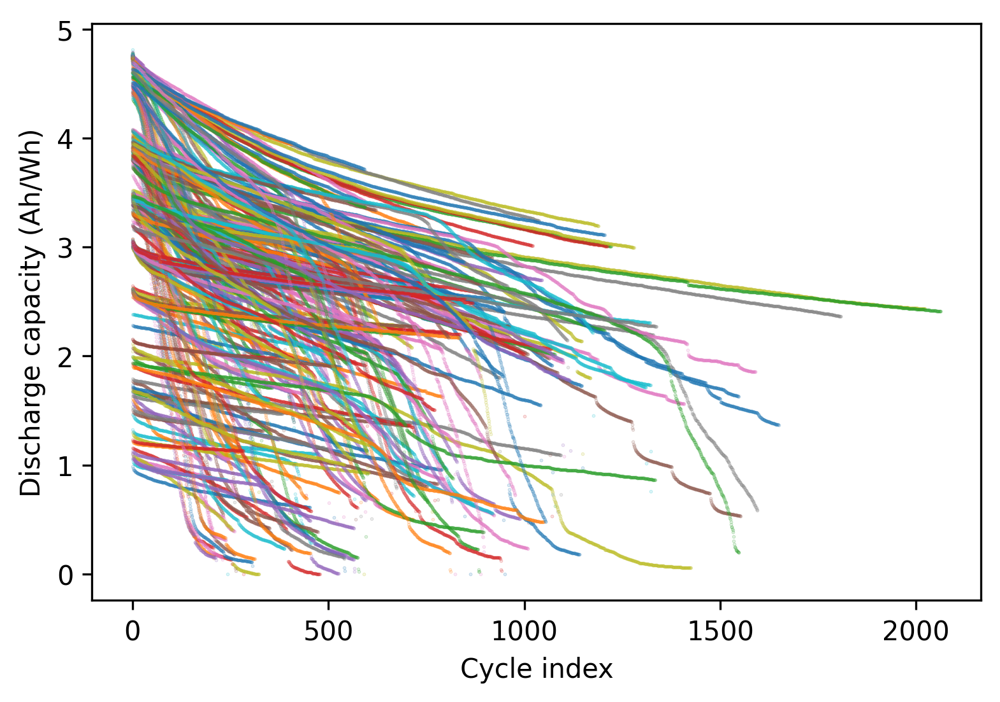

In [1162]:
plt.figure(dpi=300, facecolor='white')
for i,c in enumerate(summary_data_list):
    plt.scatter(c['cycle_index'], c['discharge_capacity'], 
                s=0.1, color=f'C{i}', label='actual cycle_index', alpha=0.3)
plt.xlabel('Cycle index')
plt.ylabel('Discharge capacity (Ah/Wh)')
# plt.savefig(f'dc_vs_cycle_index_dropped.png', dpi=400, transparent=False)


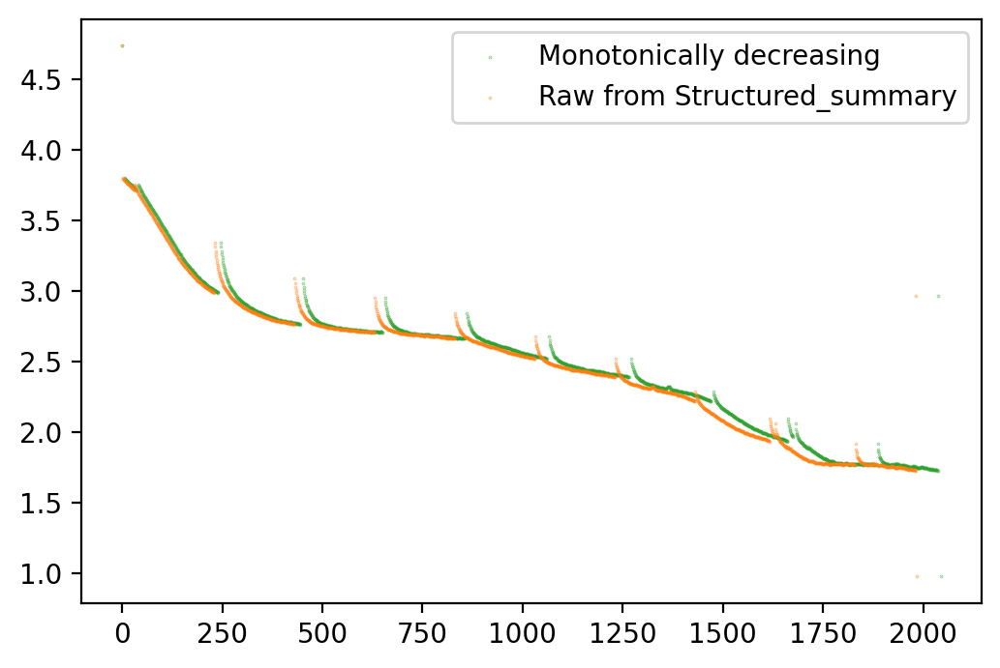

In [1163]:
plt.figure(dpi =200)
plt.scatter(test['cycle_index'], test['discharge_capacity'], 
            s=0.1, color='C2', alpha=0.5, label='Monotonically decreasing')
plt.scatter(cell_summary['cycle_index'], cell_summary['discharge_capacity'], 
            s=0.1, color='C1', alpha=0.5, label='Raw from Structured_summary')
plt.legend()

In [5]:
def find_renumbedred_index(cell):
    '''This function finds the renumbered index for the cycles that are followed by a diagnostic cycle'''
    renumbered_index_for_cycle_following_a_diagnostic_cycle = []
    i = 0
    for k,cycle in enumerate(cell):
        actual_cycle_index = np.unique(cycle['cycle_index'])[0]
#         print(i, actual_cycle_index)
        if actual_cycle_index != i:
            renumbered_index_for_cycle_following_a_diagnostic_cycle.append(k-1)
            i = actual_cycle_index
        i += 1
#     print(i, actual_cycle_index)
    return renumbered_index_for_cycle_following_a_diagnostic_cycle
find_renumbedred_index(structured_data)

[30,
 36,
 128,
 130,
 209,
 230,
 231,
 290,
 291,
 294,
 295,
 298,
 299,
 311,
 313,
 314,
 315,
 332,
 334,
 352,
 354,
 357,
 358,
 360,
 361,
 367,
 368,
 374,
 375,
 377,
 378,
 380,
 381,
 383,
 385,
 389,
 390,
 392,
 394,
 397,
 398,
 401,
 402,
 414,
 415,
 418,
 420,
 423,
 425,
 426,
 427,
 429,
 430,
 431]

In [452]:
# plt.figure(dpi=300, facecolor='white')
# for i,d in enumerate(summary_data_list):
#     plt.scatter(d['cycle_index'], d['discharge_capacity'], s=0.03, color=f'C{i}', alpha=0.2)
# #     break
# plt.xlabel('Cycle index')
# plt.ylabel('Discharge capacity (Ah/Wh)')
# plt.savefig(f'dc_vs_cycle_index.png', dpi=400, transparent=False)
# plt.figure(dpi=300, facecolor='white')

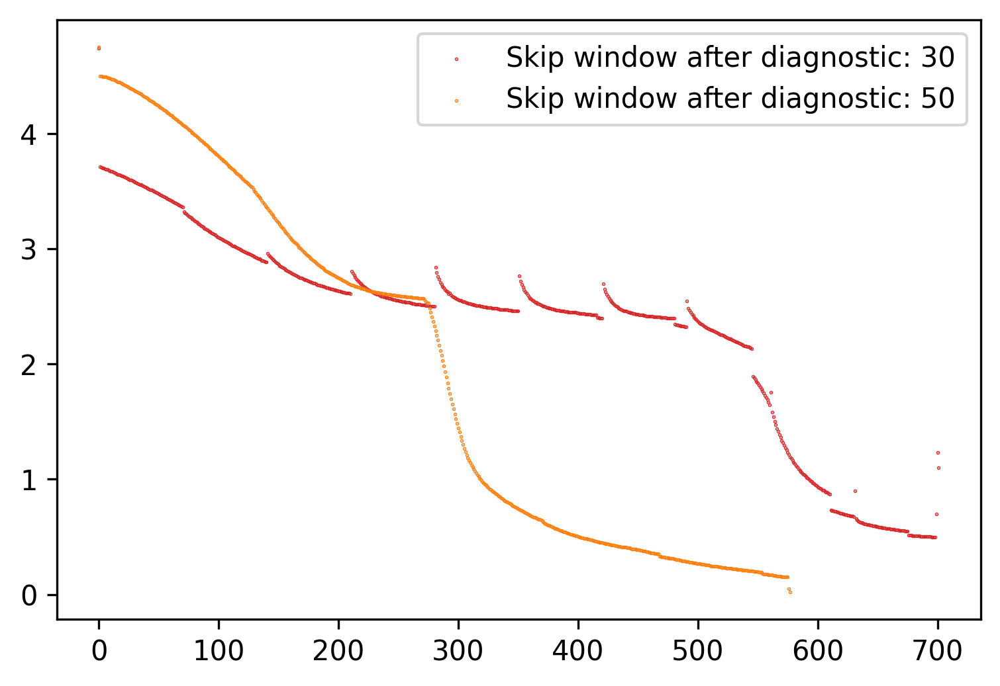

In [1165]:
plt.figure(dpi=300)
# cell_summary_rmeoved_d_cycles_50 = summary_data_list[2]
# cell_summary_rmeoved_d_cycles_30 = summary_data_list[2]
cell_summary_rmeoved_d_cycles_50 = summary_data_list[2]
# plt.scatter(cell_summary['cycle_index'], cell_summary['discharge_capacity'], 
#             s=0.1, color='C2', alpha=1, label='Skip window after diagnostic: None')
plt.scatter(cell_summary_rmeoved_d_cycles_30['cycle_index'], cell_summary_rmeoved_d_cycles_30['discharge_capacity'], 
            s=0.1, color='C3', alpha=1, label='Skip window after diagnostic: 30')
plt.scatter(cell_summary_rmeoved_d_cycles_50['cycle_index'], cell_summary_rmeoved_d_cycles_50['discharge_capacity'], 
            s=0.1, color='C1', alpha=1, label='Skip window after diagnostic: 50')

plt.legend()

In [4]:
from beep.structure.cli import auto_load_processed
cell_1 = auto_load_processed('/home/ec2-user/SageMaker/data_cache/structure/PreDiag_000314_000196_structured.json.gz')

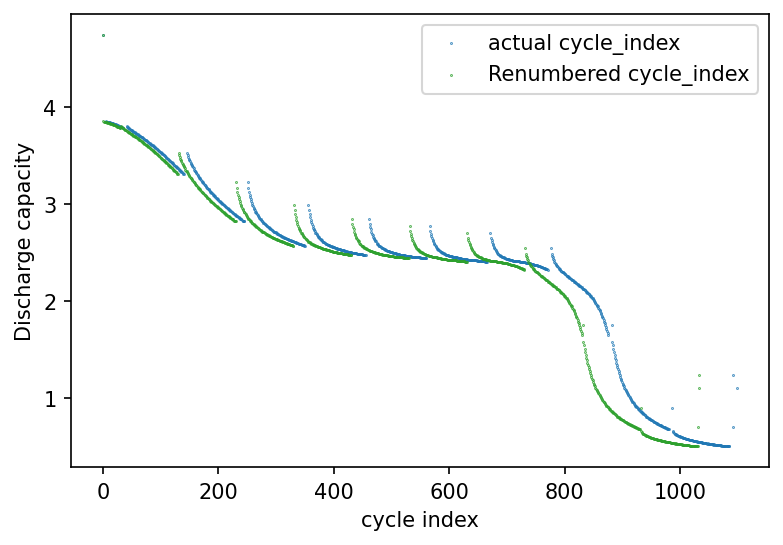

In [5]:
plt.figure(dpi=150)
plt.scatter(cell_1.structured_summary['cycle_index'], cell_1.structured_summary['discharge_capacity'], 
            s=0.1, color='C0', label='actual cycle_index')
plt.scatter(list(range(len(cell_1.structured_summary['discharge_capacity']))), cell_1.structured_summary['discharge_capacity'], 
            s=0.1, color='C2', label='Renumbered cycle_index')
plt.xlabel('cycle index')
plt.ylabel('Discharge capacity')
plt.legend()

In [6]:
# def find_slope(cycle_window_label):
#     mid_window_index = len(cycle_window_label)//2
#     low = np.array(cycle_window_label)[0]
#     mid = np.array(cycle_window_label)[mid_window_index]
#     high = np.array(cycle_window_label)[-1]
#     slope_1 = (mid[1] - low[1]) / (mid[0] - low[0]) 
#     slope_2 = (high[1] - mid[1]) / (high[0] - mid[0]) 
#     return slope_1, slope_2

# features_columns = ['cycle_index','voltage', 'current']
# label_columns = ['cycle_index', 'discharge_capacity']
# # features = np.empty([0, None,100, 3])
# cycle_numbers = 20
# monitored_cycles_discharge_capacity = []
# labels = np.empty([0, 2])
# cell_features = []
# cell_labels = []
# for i, cell in enumerate(tqdm(structured_data_list)):
#     n = len(cell)//cycle_numbers
#     cycle_window_features = []
#     cycle_window_labels = []
#     cell_cycle_indices = summary_data_list[i]['cycle_index'].values
# #     for cycle in cell:
#     for j in range(n-1): 
#         cycle_window_features.append([np.array(cell[c][features_columns]) for c in list(range(cycle_numbers*j,cycle_numbers*(j+1)))])
# #         cycle_window_features.append(np.array(cell[0][features_columns])) # [cycle_numbers*j:cycle_numbers*(j+1)]
#         discharge_cap_cycle_window = summary_data_list[i][label_columns][cycle_numbers*(j+1):cycle_numbers*(j+2)]
#         cycle_window_labels.append(find_slope(discharge_cap_cycle_window))
# #         cycle_window_labels.append(discharge_cap_cycle_window)
#     cell_features.append(cycle_window_features)
#     cell_labels.append(cycle_window_labels)
#     break

100%|██████████| 336/336 [05:30<00:00,  1.02it/s]


In [1171]:
len(structured_data_list[0])

1984

In [1172]:
len(summary_data_list[0])

1149

In [6]:
def find_slope(cycle_window_label):
    mid_window_index = len(cycle_window_label)//2
    low = np.array(cycle_window_label)[0]
    mid = np.array(cycle_window_label)[mid_window_index]
    high = np.array(cycle_window_label)[-1]
    slope_1 = (mid[1] - low[1]) / (mid[0] - low[0]) # mid_window_index #
    slope_2 = (high[1] - mid[1]) / (mid[0] - low[0]) # mid_window_index
    return slope_1, slope_2

skip_diagnostic_in_window = True

features_columns = ['cycle_index','voltage', 'current']
label_columns = ['cycle_index', 'discharge_capacity']
# features = np.empty([0, None,100, 3])
monitored_cycles_discharge_capacity = []
labels = np.empty([0, 2])
cell_features = []
cell_labels = []
cell_discharge_caps = []
initial_discharge_cap_windows = []
for i, cell in enumerate(tqdm(structured_data_list)):
#     print(i)
#     n = len(cell)//cycle_numbers
    cycle_window_features = []
    cycle_window_labels = []
    initial_discharge_cap = []
    cell_cycle_indices = summary_data_list[i]['cycle_index'].values
    index_convolution = bye_cycle.index_convoluter(cell, overlap_cycle_window=False, 
                                         overlap_size=10, cycle_window_size=cycle_window_size,
                                                   skip_diagnostic_in_window=skip_diagnostic_in_window)
#     print(len(index_convolution))
    for j, index_list in enumerate(index_convolution):
#         if (j < len(index_convolution)-1):
            cycle_window_features.append(list(zip(*[(bye_cycle.interpol_cycle(cell[cycle_index], columns=features_columns, n_points=100)
                                                     , len(cell[cycle_index]))
                                 for cycle_index in index_list])))
    #         break
    #         print (index_list)
    #         print(summary_data_list[i][label_columns])
    #         discharge_cap_cycle_window = np.array(summary_data_list[i][label_columns])[index_list]
#             print(index_convolution[j])
            discharge_cap_cycle_window = np.array(summary_data_list[i][label_columns])[index_convolution[j]]

            cycle_window_labels.append(list([find_slope(discharge_cap_cycle_window),discharge_cap_cycle_window]))
#         if j == 0:
#             initial_discharge_cap.append(np.array(summary_data_list[i][label_columns])[index_convolution[j]])
    #         cycle_window_labels.append(discharge_cap_cycle_window)
    #     break
    cell_features.append(cycle_window_features)
    cell_labels.append(cycle_window_labels)
#     initial_discharge_cap_windows.append(initial_discharge_cap)

100%|██████████| 282/282 [03:28<00:00,  1.35it/s]


In [471]:
def find_renumbedred_index(cell):
    '''This function finds the renumbered index for the cycles that are followed by a diagnostic cycle'''
    renumbered_index_for_cycle_following_a_diagnostic_cycle = []
    i = 0
    for k,cycle in enumerate(cell):
        actual_cycle_index = np.unique(cycle['cycle_index'])[0]
#         print(i, actual_cycle_index)
        if actual_cycle_index != i:
            renumbered_index_for_cycle_following_a_diagnostic_cycle.append(k-1)
            i = actual_cycle_index
        i += 1
#     print(i, actual_cycle_index)
    return renumbered_index_for_cycle_following_a_diagnostic_cycle


def index_convoluter(cell, cycle_window_size=20, overlap_cycle_window=False,
                     overlap_size=5, skip_diagnostic_in_window=False):
    '''This function generates a nested list of indices by convolting the cycles based on cycle_window_size. 
        You can choose to have your window of cycles overlap, or skipp the windows that involve diagnostic cycles in between.
    '''
    max_cycle_index = len(cell) #30 #
    if cycle_window_size < overlap_size:
        raise ValueError(f'If overlapping, overlap_size ({overlap_size}) should be samller than cycle_window_size ({cycle_window_size}). Please check inputs.')
    if not cycle_window_size < max_cycle_index:
        raise ValueError(f'cycle_window_size ({cycle_window_size}) should be samller than maximum number of cycles in cell ({max_cycle_index}). Please check inputs.')
    if overlap_cycle_window:
        non_overlap =  cycle_window_size - overlap_size
    else:
        non_overlap = cycle_window_size
    intervals = range(0, max_cycle_index, non_overlap)
    if not skip_diagnostic_in_window:
        index_covolutions = [list(range(x, x + cycle_window_size)) for x in intervals if x <= max_cycle_index-cycle_window_size]
    else:
#         skipped_indices = [5, 6, 7, 20]
        skipped_indices = find_renumbedred_index(cell)
        print(f'One before diagnostic {skipped_indices}\n')
        index_covolutions = [list(range(x, x + cycle_window_size)) for x in intervals if x <= max_cycle_index-cycle_window_size
                             and not (set(list(range(x, x + cycle_window_size))[:-1]) & set(skipped_indices))]
    return index_covolutions


index_convolution = index_convoluter(cell, overlap_cycle_window=True, 
                                         overlap_size=10, cycle_window_size=window_cycles_size,
                                               skip_diagnostic_in_window=False)
print(index_convolution)

[[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39], [30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69], [60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99], [90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129], [120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159], [150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175

In [469]:
index_convolution = index_convoluter(cell, overlap_cycle_window=False, 
                                         overlap_size=10, cycle_window_size=window_cycles_size,
                                               skip_diagnostic_in_window=True)
print(index_convolution)

One before diagnostic [0, 30, 130, 230, 330, 430, 431]

[[40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79], [80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119], [160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199], [240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279], [280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318,

In [7]:
# Split train-val-test data by cells
# prepared_data = [(cell_features[i], cell_labels[i]) for i in range(len(cell_features))]
prepared_data = list(zip(cell_features, cell_labels))

train_size = 0.9
val_size = 0.2
N_train = int(train_size *len(prepared_data))
N_val = int(val_size * N_train)
train_cells = prepared_data[:N_train]
test_cells = prepared_data[N_train:]

val_cells = train_cells[:N_val]
train_cells = train_cells[N_val:]
print(len(train_cells),len(val_cells), len(test_cells), len(train_cells)+len(test_cells)+len(val_cells))
# train_indices = random.sample(range(len(dat)), N_train)
# test_cells = prepared_data[N_train:]

In [8]:
print(len(train_cells),len(val_cells), len(test_cells), len(train_cells)+len(test_cells)+len(val_cells))

203 50 29 282


In [11]:
len(train_cells)

203

In [12]:
N_val

50

In [13]:
len(test_cells)

29

In [409]:
# Y_train = [x for xs in train_cells for x in xs[1]]
# dc_train, slopes_train = make_label_arrays(Y_train)
# print(slopes_train)

In [9]:
def standardize(inputs):
    fstd = np.std(inputs, axis=0)
    fmean = np.mean(inputs, axis=0)
    std_features = (inputs - fmean) / fstd
    return std_features

def make_feature_arrays(data):
    X_dt_values = []
    X_time_series = []
    for X in data[:-1]:
        X_dt_values.append(X[1])
        X_time_series.append(X[0])
#         break
    return np.array(X_time_series), np.array(X_dt_values)

def make_label_arrays(data):
    slopes = []
    discharge_cap = []
    for Y in data[1:]:
        discharge_cap.append(Y[1])
        slopes.append(Y[0])
    return np.array(discharge_cap), np.array(slopes)

X_train = [x for xs in train_cells for x in xs[0]]
# Y_train = np.array([x for xs in train_cells for x in xs[1]])
Y_train = [x for xs in train_cells for x in xs[1]]
dc_train, slopes_train = make_label_arrays(Y_train)
X_train_time_series, X_train_dt = make_feature_arrays(X_train)
print(X_train_time_series[0,0,0,0])
print(dc_train[0][0])
# print(X_train_time_series[0])
import random
random.seed(0)
indices = list(range(len(X_train_time_series)))
random.shuffle(indices)
print(f'len features {len(X_train_time_series)}')
X_train_time_series = X_train_time_series[indices]
X_train_dt = X_train_dt[indices]

slopes_train = slopes_train[indices]
dc_train = dc_train[indices]
print(X_train_time_series[0,0,0,0])
print(dc_train[0][0])

X_val = [x for xs in val_cells for x in xs[0]]
# Y_val= np.array([x for xs in val_cells for x in xs[1]])
Y_val = [x for xs in val_cells for x in xs[1]]
dc_val, slopes_val = make_label_arrays(Y_val)
X_val_time_series, X_val_dt = make_feature_arrays(X_val)

X_test = [x for xs in test_cells for x in xs[0]]
# Y_test= np.array([x for xs in test_cells for x in xs[1]])
Y_test = [x for xs in test_cells for x in xs[1]]
dc_test, slopes_test = make_label_arrays(Y_test)
X_test_time_series, X_test_dt = make_feature_arrays(X_test)

# std_X_train_time_series = standardize(X_train_time_series[...,1:])
# std_X_val_time_series = standardize(X_val_time_series[...,1:])
# std_X_test_time_series = standardize(X_test_time_series[...,1:]) 

# X_train_time_series = X_train_time_series[...,1:]

# X_val_time_series = X_val_time_series[...,1:]
# X_test_time_series = X_test_time_series[...,1:]

0.0
[100.      3.266]
len features 1259
100.0
[200.      3.036]


In [453]:
for i in range(10):
    print(X_train_time_series[i,-1,-1,0])
    print(dc_train[i][0])
#     break

1054.0
[1100.       2.708]
1139.0
[1.140e+03 6.001e-01]
549.0
[595.      3.338]
929.0
[930.     2.88]
539.0
[540.      1.765]
129.0
[175.      3.693]
2734.0
[50.     3.711]
2314.0
[2360.      2.48]
1389.0
[1435.       2.474]
549.0
[595.      2.857]


In [10]:
def standardize_train(inputs):
    fstd = np.std(inputs, axis=0)
    fmean = np.mean(inputs, axis=0)
    std_features = (inputs - fmean) / fstd
    return std_features, fmean, fstd

def standardize_non_train(inputs, fmean_train, fstd_train):
    std_features = (inputs - fmean_train) / fstd_train
    return std_features

Text(0.5, 1.0, 'slope 1')

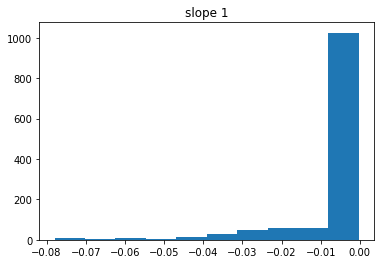

In [14]:
plt.hist(slopes_train[:,0])
plt.title('slope 1')

100%|██████████| 9/9 [00:06<00:00,  1.39it/s]


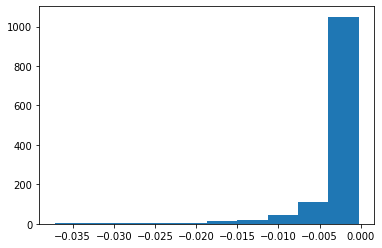

In [11]:
def oversample(f_time_series, f_dt, labels, oversample_label_index=1):
    counts, bins, patches = plt.hist(labels[:,oversample_label_index])
    import numpy_indexed as npi
    import random
    max_samples = max(counts)
    ind = np.digitize(labels[:,oversample_label_index], bins)
    label_groups = npi.group_by(ind).split(labels[:,oversample_label_index])

    balanced_f_time_series = f_time_series
    balanced_labels = labels
    balanced_f_dt = f_dt
    for sg in tqdm(label_groups[:-2]):
        n_samples = int(max_samples - len(sg))
        # Find indices for samples
        sample_indices = npi.indices(labels[:, oversample_label_index], np.random.choice(sg, n_samples))
        balanced_f_time_series = np.append(balanced_f_time_series,
                                                     f_time_series[sample_indices], axis=0)
        balanced_labels = np.append(balanced_labels,
                                                     labels[sample_indices], axis=0)
        balanced_f_dt = np.append(balanced_f_dt,
                                                f_dt[sample_indices], axis=0)
    
#     random.seed(0)
    shuffled_indices = list(range(len(balanced_f_time_series)))
    random.shuffle(indices)
    return balanced_f_time_series[shuffled_indices], balanced_f_dt[shuffled_indices], balanced_labels[shuffled_indices]

balanced_X_train_time_series, balanced_X_train_dt, balanced_slopes_train = oversample(X_train_time_series,
                                                                                               X_train_dt,
                                                                                               slopes_train, oversample_label_index=1)
# balanced_X_train_time_series, balanced_X_train_dt, balanced_slopes_train = oversample(balanced_X_train_time_series,
#                                                                                                balanced_X_train_dt,
#                                                                                                balanced_slopes_train, oversample_label_index=0)

Text(0.5, 1.0, 'slope 1')

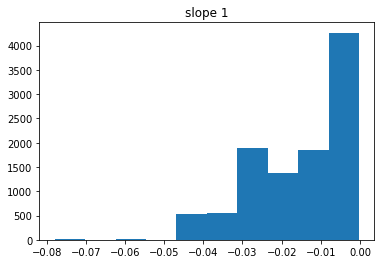

In [12]:
plt.hist(balanced_slopes_train[:,0])
plt.title('slope 1')

Text(0.5, 1.0, 'slope 2')

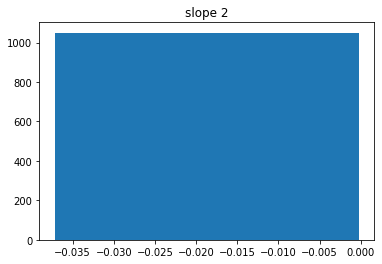

In [13]:
plt.hist(balanced_slopes_train[:,1])
plt.title('slope 2')

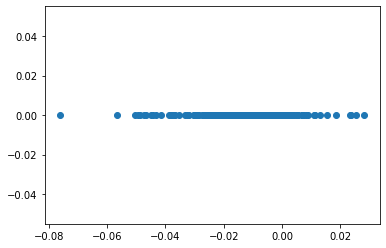

In [766]:
plt.scatter(slopes_train[:,0], slopes_train[:,0].shape[0] * [0])
# plt.scatter( X, [0] * X.shape[0])

In [34]:
scaled_X_train_time_series.shape

(10500, 100, 100, 2)

In [12]:
scaled_X_train_dt, mean_X_train_dt, std_X_train_dt  = standardize_train(balanced_X_train_dt)
scaled_X_val_dt = standardize_non_train(X_val_dt, mean_X_train_dt, std_X_train_dt)

scaled_X_train_time_series, mean_X_train_time_series, std_X_train_time_series = standardize_train(balanced_X_train_time_series)
scaled_X_val_time_series = standardize_non_train(X_val_time_series, mean_X_train_time_series, std_X_train_time_series)
# X_train_time_series = X_train_time_series

scaled_X_train_time_series = scaled_X_train_time_series[...,1:]
scaled_X_val_time_series = scaled_X_val_time_series[...,1:]

In [32]:
from dataclasses import dataclass
@dataclass
class Config:
    batch_size: int
    buffer_size: int
    rnn_units: int
    hidden_dim: int
    embedding_dim: int
    reg_strength: float
    lr: float
    drop_rate: float
        
config = Config(batch_size=16, 
                buffer_size=10000,
                rnn_units=64,
                hidden_dim=64,
                embedding_dim=32,
                reg_strength=0,
                lr=1e-3,
                drop_rate=0.3
               )

def build_model(L, T, cycle_window_size=10, reg_strength=0):
    inputs = tf.keras.Input(shape=(cycle_window_size,T,2))
    input_dt = tf.keras.Input(shape=(cycle_window_size))
    print(f'input: {inputs.shape}')
    print(f'input_dt: {input_dt.shape}')
#     conv_1d_layer = tf.keras.layers.Conv1D(32, 50, activation='relu')
#     max_pooling = 
#     blstm_layer = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16))
#     x = tf.keras.layers.Embedding(100,16)(inputs)
    x = tf.keras.layers.TimeDistributed(tf.keras.layers.Conv1D(32, 10), input_shape=(cycle_window_size, 10, 2))(inputs)
    print(f'output 1 conv: {x.shape}')
    x = tf.keras.layers.TimeDistributed(tf.keras.layers.MaxPool1D(pool_size=2))(x)
    print(f'output max_pooling 1: {x.shape}')
    x = tf.keras.layers.TimeDistributed(tf.keras.layers.Conv1D(32, 10), input_shape=(cycle_window_size, 20 ,2))(x)
    print(f'output 2 conv: {x.shape}')
    x = tf.keras.layers.TimeDistributed(tf.keras.layers.MaxPool1D(pool_size=2))(x)
    print(f'output max_pooling 2: {x.shape}')
#     x = tf.keras.layers.TimeDistributed(tf.keras.layers.Conv1D(32, 10), input_shape=(cycle_window_size, 2))(x)
#     print(f'output 3 conv: {x.shape}')
#     x = tf.keras.layers.TimeDistributed(tf.keras.layers.MaxPool1D(pool_size=2))(x)
#     print(f'output max_pooling 3: {x.shape}')
#     x = tf.keras.layers.TimeDistributed(tf.keras.layers.Conv1D(32, 10), input_shape=(cycle_window_size, 2))(x)
#     x = tf.keras.layers.TimeDistributed(tf.keras.layers.Conv1D(32, 25), input_shape=(100, 2))(x)
#     print(f'output 3 conv: {x.shape}')
#     x = tf.keras.layers.TimeDistributed(max_pooling)(x)
#     print(f'output max_pooling 2: {x.shape}')
#     x = tf.keras.layers.LayerNormalization()(x)
    x = tf.keras.layers.TimeDistributed(tf.keras.layers.Dropout(config.drop_rate))(x)
    print(f'output dropout: {x.shape}')
#     x = tf.keras.layers.Reshape((cycle_window_size, 32))(x)
#     x = tf.keras.layers.TimeDistributed(tf.keras.layers.GlobalAveragePooling1D())(x)
#     x = tf.keras.layers.Flatten()(x)
#     x = tf.keras.layers.TimeDistributed(tf.keras.layers.Flatten())(x)
#     
    print(f'output GlobalAveragePooling1D: {x.shape}')
#     conv_1d_layer = tf.keras.layers.Conv1D(64, 5, input_shape=(100,64))
#     x = tf.keras.layers.TimeDistributed(conv_1d_layer, input_shape=(100,))(x)
    print(x.shape)
    x = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32, return_sequences=True))(x)
    x = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32, return_sequences=False))(x)
    print(f'output bilstm dist: {x.shape}')
#     x = tf.keras.layers.Concatenate()([x, input_dt])
    x = tf.keras.layers.LayerNormalization()(x)
    x = tf.keras.layers.Dropout(config.drop_rate)(x)
    x = tf.keras.layers.Dense(32, kernel_regularizer=tf.keras.regularizers.L2(l2=reg_strength), activation='tanh')(x)
    x = tf.keras.layers.LayerNormalization()(x)
    x = tf.keras.layers.Dropout(config.drop_rate)(x)
    x = tf.keras.layers.Dense(16, kernel_regularizer=tf.keras.regularizers.L2(l2=reg_strength), activation='tanh')(x)
#     e = tf.keras.layers.Embedding(input_dim=config.vocab_size, 
#                                     output_dim=config.embedding_dim,
#                                     mask_zero=True)(inputs)
    x = tf.keras.layers.LayerNormalization()(x)
    x = tf.keras.layers.Dropout(config.drop_rate)(x)
    yhat = tf.keras.layers.Dense(2, kernel_regularizer=tf.keras.regularizers.L2(l2=reg_strength))(x)
#     model = tf.keras.Model(inputs=[inputs, input_dt], outputs=yhat)
    model = tf.keras.Model(inputs=inputs, outputs=yhat)
    return model
tf.keras.backend.clear_session()
L = None
T = 100

from keras import backend as K
def root_mean_squared_error(y_true, y_pred):
        return K.sqrt(K.mean(K.square(y_pred - y_true), axis=-1)) 
    
model = build_model(L, T, cycle_window_size=cycle_window_size, reg_strength=0)
opt = tf.optimizers.SGD(1e-3)
model.compile(
  opt,
  loss='mean_absolute_error')
#   loss=root_mean_squared_error)
model.summary()

input: (None, 100, 100, 2)
input_dt: (None, 100)
output 1 conv: (None, 100, 91, 32)
output max_pooling 1: (None, 100, 45, 32)
output 2 conv: (None, 100, 36, 32)
output max_pooling 2: (None, 100, 18, 32)
output dropout: (None, 100, 18, 32)
output GlobalAveragePooling1D: (None, 100, 18, 32)
(None, 100, 18, 32)


ValueError: Input 0 of layer "bidirectional" is incompatible with the layer: expected ndim=3, found ndim=4. Full shape received: (None, 100, 18, 32)

In [25]:
result = model.fit(
    scaled_X_train_time_series, -np.log(-balanced_slopes_train), # standardize
#     scaled_X_train_time_series, balanced_slopes_train,
    validation_data=(scaled_X_val_time_series, -np.log(-slopes_val)), 
#     validation_data=(scaled_X_val_time_series, slopes_val), 
    callbacks=[tf.keras.callbacks.ReduceLROnPlateau(
            monitor="val_loss", factor=0.9, patience=5, min_lr=1e-5
        ), tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', restore_best_weights=True, patience=10)],
# #         tf.keras.callbacks.LambdaCallback(
# #         on_epoch_begin=lambda epochs,logs: print('lr =',lr_decayed_fn(opt.iterations).numpy())
# #         ),
#         ,
    epochs=150, batch_size=16)

# result = model.fit(
#     [scaled_X_train_time_series, scaled_X_train_dt], -np.log(-balanced_slopes_train), # standardize
#     validation_data=([scaled_X_val_time_series, scaled_X_val_dt], -np.log(-slopes_val)), 
#     callbacks=[tf.keras.callbacks.ReduceLROnPlateau(
#             monitor="val_loss", factor=0.9, patience=5, min_lr=1e-5
#         ), tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', restore_best_weights=True, patience=20)],
# # #         tf.keras.callbacks.LambdaCallback(
# # #         on_epoch_begin=lambda epochs,logs: print('lr =',lr_decayed_fn(opt.iterations).numpy())
# # #         ),
# #         ,
#     epochs=150, batch_size=64)

Epoch 1/150
657/657 [==============================] - 61s 82ms/step - loss: 1.5870 - val_loss: 2.1153 - lr: 0.0010
Epoch 2/150
657/657 [==============================] - 52s 79ms/step - loss: 1.1901 - val_loss: 2.1412 - lr: 0.0010
Epoch 3/150
657/657 [==============================] - 52s 79ms/step - loss: 1.1292 - val_loss: 2.1746 - lr: 0.0010
Epoch 4/150
657/657 [==============================] - 52s 79ms/step - loss: 1.0867 - val_loss: 2.1704 - lr: 0.0010
Epoch 5/150
657/657 [==============================] - 52s 79ms/step - loss: 1.0673 - val_loss: 2.2104 - lr: 0.0010
Epoch 6/150
657/657 [==============================] - 52s 79ms/step - loss: 1.0400 - val_loss: 2.1915 - lr: 0.0010
Epoch 7/150
 78/657 [==>...........................] - ETA: 45s - loss: 1.0264

KeyboardInterrupt: 

In [ ]:
plt.figure(dpi=100)
plt.plot(result.history['loss'], color='C0', label='Train')
plt.plot(result.history['val_loss'], color='C1', label='Validation')
plt.legend()
plt.ylabel('MAE')
plt.xlabel('Epochs')
# plt.xlim([100, 150])

In [181]:
scaled_X_test_dt = standardize_non_train(X_test_dt, mean_X_train_dt, std_X_train_dt)
scaled_X_test_time_series = standardize_non_train(X_test_time_series, mean_X_train_time_series, std_X_train_time_series)[...,1:]

# test_result = model.evaluate([scaled_X_test_time_series, scaled_X_test_dt], -np.log(-slopes_test))
# test_result = model.evaluate(scaled_X_test_time_series, slopes_test)
test_result = model.evaluate(scaled_X_test_time_series, -np.log(-slopes_test))

7/7 [==============================] - 0s 16ms/step - loss: 1.7377


In [172]:
# Y_hat_test = model.predict([scaled_X_test_time_series, scaled_X_test_dt])
Y_hat_test = model.predict(scaled_X_test_time_series)

7/7 [==============================] - 1s 12ms/step


In [173]:
for i in range(len(slopes_test[:,0])):
    print(np.abs(slopes_test[i,1]- Y_hat_test[i,1]))

4.796485581289604
5.573594295499582
4.919692990844324
4.9175953432903245
6.537595047603457
5.256434345521801
5.256418272303801
7.059912982235535
5.358749321925463
5.3588027640674625
5.358737277447463
5.3598883447894625
7.6855089226259965
4.951428551434133
4.951456400458133
4.951472744308133
4.953453974770133
4.956340921212133
4.953329444684133
4.95168812589645
4.6254482290447205
5.272378451968022
5.26642809902976
5.247198669192449
5.247270080927726
4.8321788530138905
4.759861375040119
4.134456329372922
4.134356256170162
4.519021845550424
5.04145143054765
4.626905122927891
5.273385307020021
5.272122961407117
4.843348473963515
4.166248702611916
4.6211216294464865
4.501245275101648
5.272424265386022
5.252277392229365
5.247192904831273
5.247195690351912
4.831918350974973
4.777588408536906
4.13509381127094
4.1335135022841625
4.132449023089341
5.013619988828199
4.27568320531201
4.735408041206037
7.059978845207535
5.358790783473463
5.358807930289463
5.3587287349614625
5.3588901908969415
5.358

In [174]:
 Y_hat_test[:,0]

array([4.781, 4.975, 4.578, 4.578, 6.81 , 5.645, 5.645, 6.942, 4.901,
       4.901, 4.901, 4.901, 6.831, 4.403, 4.403, 4.403, 4.403, 4.403,
       4.403, 4.403, 4.017, 5.859, 5.864, 5.86 , 5.86 , 5.645, 5.472,
       5.261, 5.261, 5.168, 4.993, 4.017, 5.859, 5.861, 5.645, 5.273,
       5.153, 4.193, 5.859, 5.856, 5.86 , 5.86 , 5.645, 5.482, 5.261,
       5.261, 5.261, 4.986, 4.215, 4.589, 6.942, 4.901, 4.901, 4.901,
       4.901, 4.901, 4.901, 4.956, 7.295, 5.299, 5.192, 4.988, 4.988,
       4.988, 4.988, 4.943, 4.892, 5.143, 5.213, 5.212, 5.606, 5.606,
       5.606, 6.024, 4.746, 5.038, 4.053, 4.053, 4.053, 4.053, 6.831,
       4.403, 4.403, 4.403, 4.403, 4.403, 4.403, 4.194, 5.864, 5.86 ,
       5.645, 5.273, 5.238, 4.986, 4.993, 5.586, 5.3  , 5.192, 4.988,
       4.988, 4.956, 4.943, 5.381, 6.43 , 3.949, 3.949, 3.949, 3.949,
       3.949, 3.949, 3.949, 3.949, 3.949, 3.949, 3.949, 3.949, 4.189,
       5.857, 5.498, 5.333, 5.261, 5.261, 5.261, 4.986, 4.993, 4.514,
       4.578, 4.578,

Text(0, 0.5, 'Predicted Value')

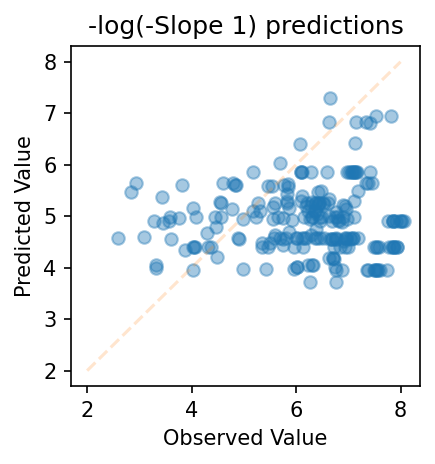

In [177]:
from sklearn.metrics import r2_score
plt.figure(figsize=(3, 3), dpi=150, facecolor='white')
plt.scatter(-np.log(-slopes_test[:,0]), Y_hat_test[:,0], alpha=0.4)
# plt.scatter(-slopes_test[:,0], -Y_hat_test[:,0], alpha=0.4)
plt.plot([2,8], [2,8], color='C1', alpha=0.2, linestyle='--')
# plt.plot([0,0.06], [0,0.06], color='C1', alpha=0.2, linestyle='--')
plt.title(f'-log(-Slope 1) predictions')
plt.xlabel('Observed Value')
plt.ylabel('Predicted Value')
# plt.savefig('img/parity plot_100_slope_1.png', dpi=400, transparent=False)
#  R$^2$ =  {r2_score(-np.log(-slopes_test[:,0]), Y_hat_test[:,0]):.3f}

Text(0, 0.5, 'Predicted Value')

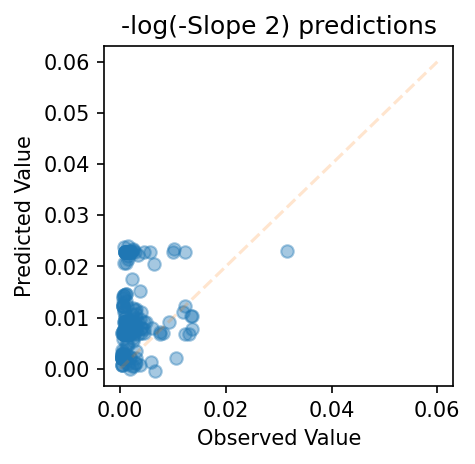

In [156]:
from sklearn.metrics import r2_score
plt.figure(figsize=(3, 3), dpi=150, facecolor='white')
# plt.scatter(-np.log(-slopes_test[:,1]), Y_hat_test[:,1], alpha=0.4, )
plt.scatter(-slopes_test[:,1], -Y_hat_test[:,1], alpha=0.4, )

# plt.plot([2,8], [2,8], color='C1', alpha=0.2, linestyle='--')
plt.plot([0,0.06], [0,0.06], color='C1', alpha=0.2, linestyle='--')
plt.title(f'-log(-Slope 2) predictions')
# plt.title(f'slo predictions for test data - R$^2$ = {r2_score(-np.log(-slopes_test[:,1]), Y_hat_test[:,1]):.3f}')
plt.xlabel('Observed Value')
plt.ylabel('Predicted Value')
# plt.savefig('img/parity plot_100_slope_2.png', dpi=400, transparent=False)

In [157]:
# testing on data
tested_cell = [test_cells[4]]
# X_train_tested_cell = [x for xs in train_cells for x in xs[0]]
# Y_train = np.array([x for xs in train_cells for x in xs[1]])
# Y_train_tested_cell = [x for xs in train_cells for x in xs[1]]
X_tested_cell = [x for cycle in tested_cell for x in cycle[0]]
# Y_test = [x for xs in test_cells for x in xs[1]]
Y_tested_cell = [y for cycle in tested_cell for y in cycle[1]]
dc_tested_cell, slopes_tested_cell = make_label_arrays(Y_tested_cell)
X_tested_cell_time_series, X_tested_cell_dt = make_feature_arrays(X_tested_cell)

scaled_X_tested_cell_dt = standardize_non_train(X_tested_cell_dt, mean_X_train_dt, std_X_train_dt)
scaled_X_tested_cell_time_series = standardize_non_train(X_tested_cell_time_series, mean_X_train_time_series, std_X_train_time_series)[...,1:]

# std_X_tested_cell_time_series = standardize(X_tested_cell_time_series[...,1:])
all_test_slopes = [y[0] for y in Y_tested_cell]
all_test_dc = np.array([y[1] for y in Y_tested_cell])
# Y_hat_tested_cell = model.predict([scaled_X_tested_cell_time_series, scaled_X_tested_cell_dt])
Y_hat_tested_cell = model.predict(scaled_X_tested_cell_time_series)

1/1 [==============================] - 0s 47ms/step


In [158]:
scaled_X_tested_cell_time_series.shape

(10, 100, 100, 2)

In [159]:
Y_hat_tested_cell.shape

(10, 2)

In [160]:
for m in Y_hat_tested_cell:
    print(m)
    break

[-0.006 -0.008]


In [161]:
# for i,m in enumerate(all_test_dc[1:]):
#     print(i)
#     if i%2 == 0:
#         print(m[5,0])
#         n = m
#     else:
#         print(n[9,0])
#     print(m)

In [162]:
def linear_fit(new_x_point, slope, point_xy):
    return slope*(new_x_point-point_xy[0]) + point_xy[1]

(1.0, 4.0)

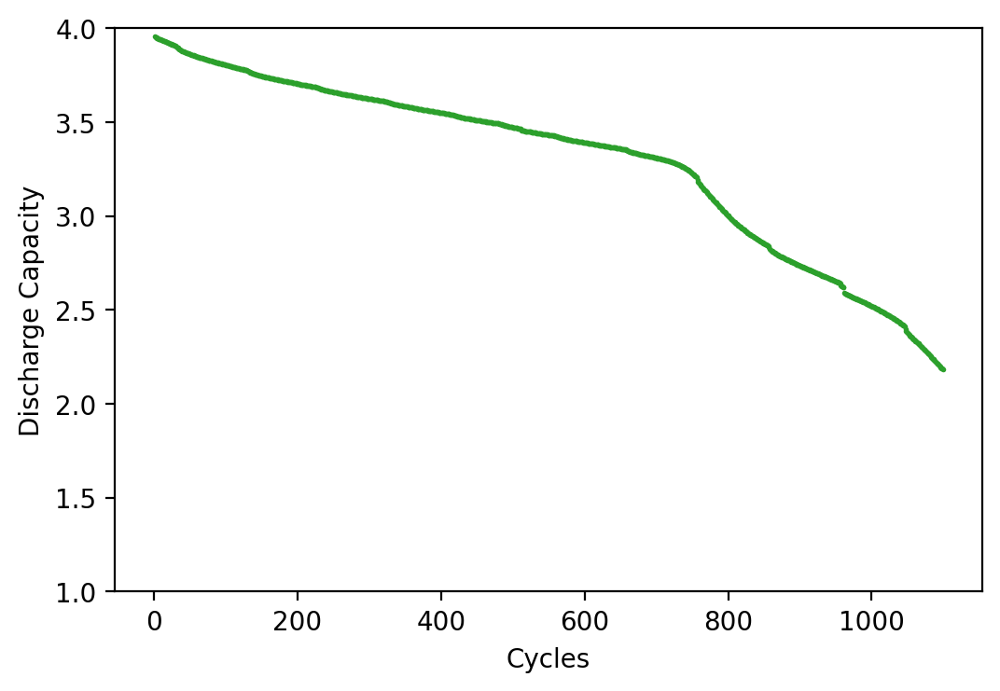

In [163]:
plt.figure(dpi=200, facecolor='white')
plt.scatter(*list(zip(*all_test_dc.reshape([-1,2]))), color = 'C2', s=1, label='Ground-truth')
plt.xlabel('Cycles')
plt.ylabel('Discharge Capacity')
plt.ylim([1,4])
# plt.savefig(f'img/ground-truth.png', dpi=200, transparent=False)

In [164]:
slopes_tested_cell

array([[-0.001, -0.001],
       [-0.001, -0.001],
       [-0.001, -0.001],
       [-0.001, -0.001],
       [-0.001, -0.001],
       [-0.001, -0.001],
       [-0.002, -0.004],
       [-0.003, -0.002],
       [-0.002, -0.003],
       [-0.003, -0.004]])

1/1 [==============================] - 0s 49ms/step
predicted slope: -0.006156782619655132, True slope: -0.001181725401999998
predicted slope: -0.00776252243667841, True slope: -0.0007987043560000017
[array([100.   ,   3.805]), array([150.   ,   3.497]), array([200.   ,   3.109])]
predicted slope: -0.006224344484508038, True slope: -0.000872539341999996
predicted slope: -0.006782315205782652, True slope: -0.0006980968960000045
[array([200.   ,   3.704]), array([250.   ,   3.393]), array([300.   ,   3.054])]
predicted slope: -0.006224334239959717, True slope: -0.0008011742580000014
predicted slope: -0.006782321725040674, True slope: -0.0006862739259999984
[array([300.   ,   3.625]), array([350.   ,   3.314]), array([400.   ,   2.975])]
predicted slope: -0.006146408151835203, True slope: -0.0007818841600000059
predicted slope: -0.006833966355770826, True slope: -0.0007358472319999975
[array([400.  ,   3.55]), array([450.   ,   3.243]), array([500.   ,   2.901])]
predicted slope: -0.00614

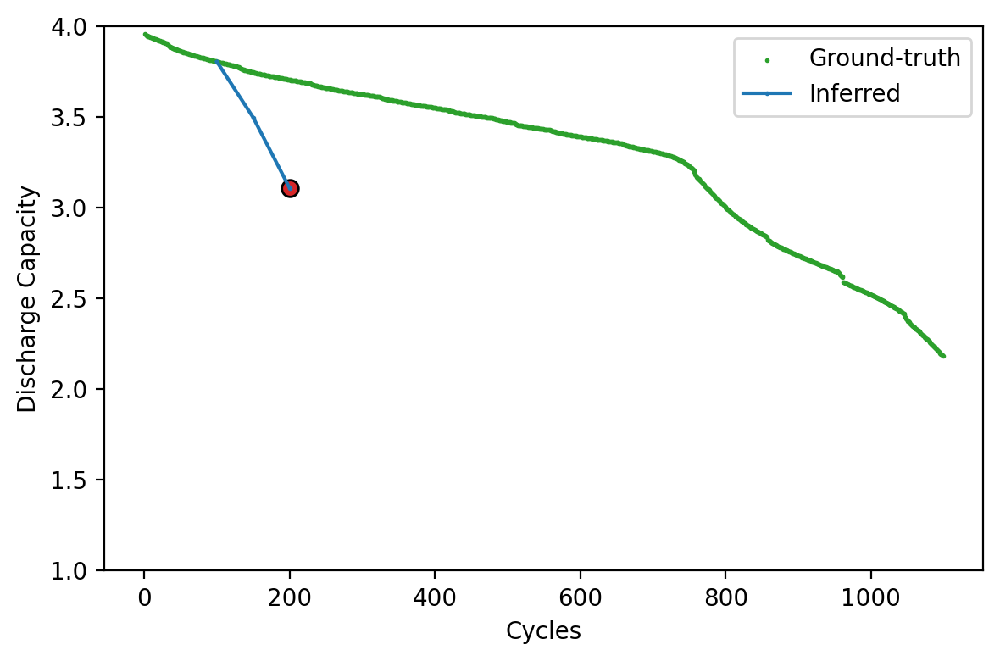

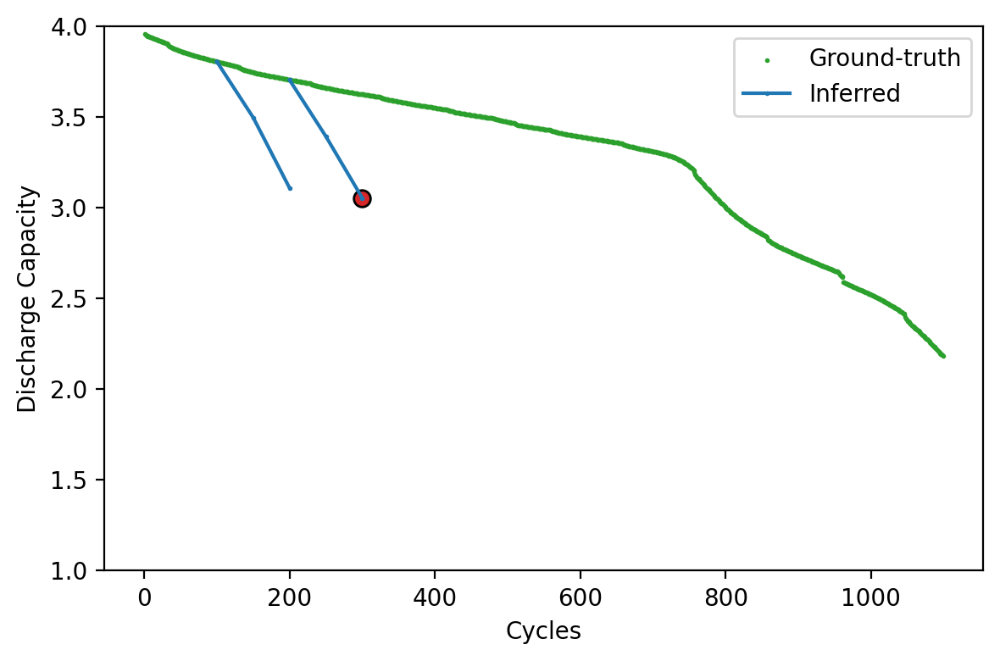

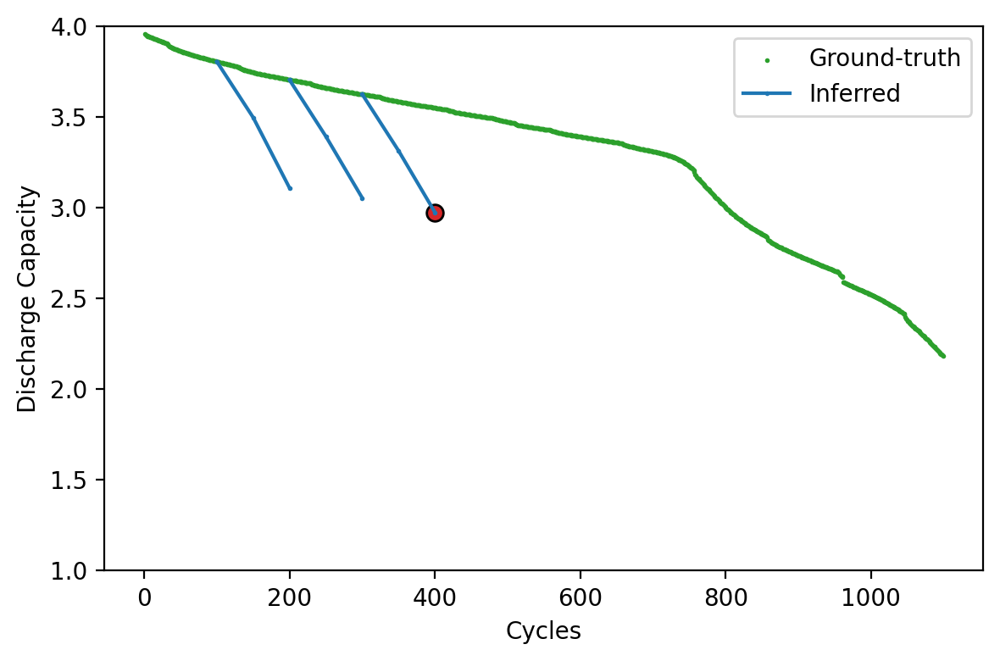

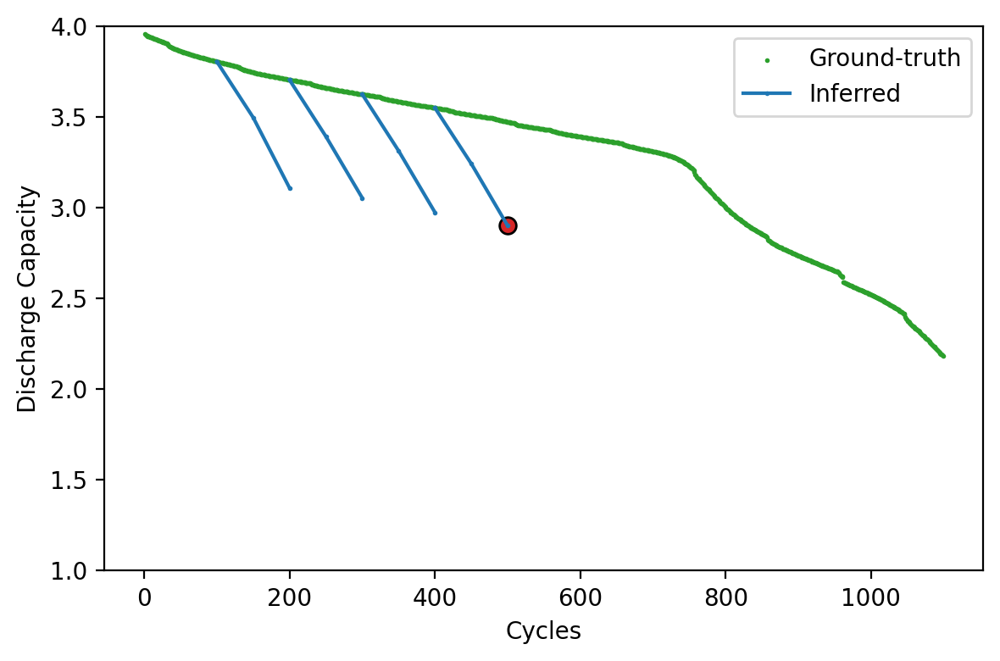

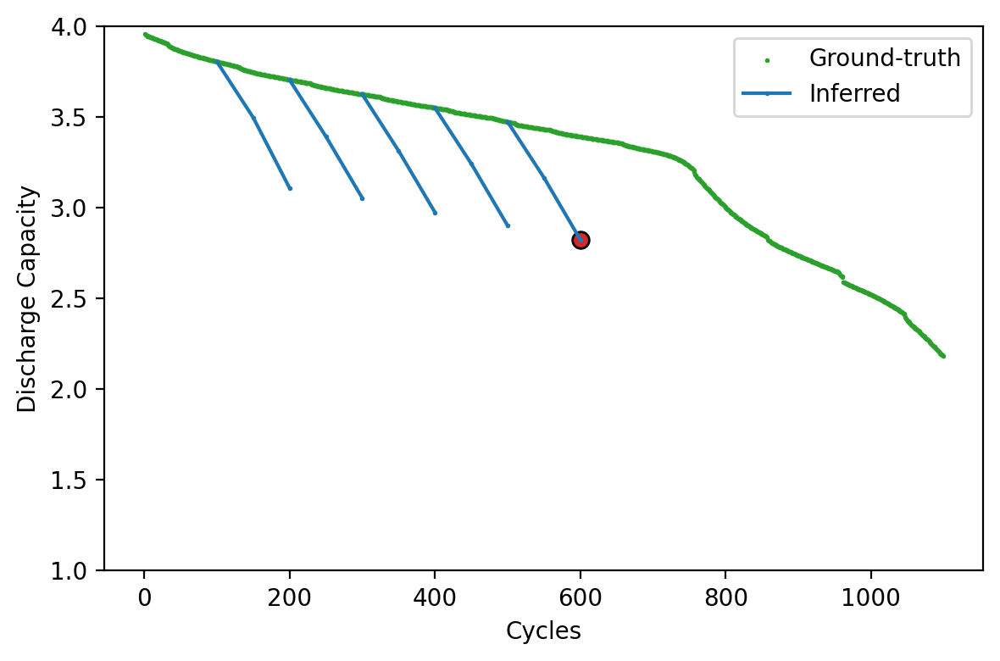

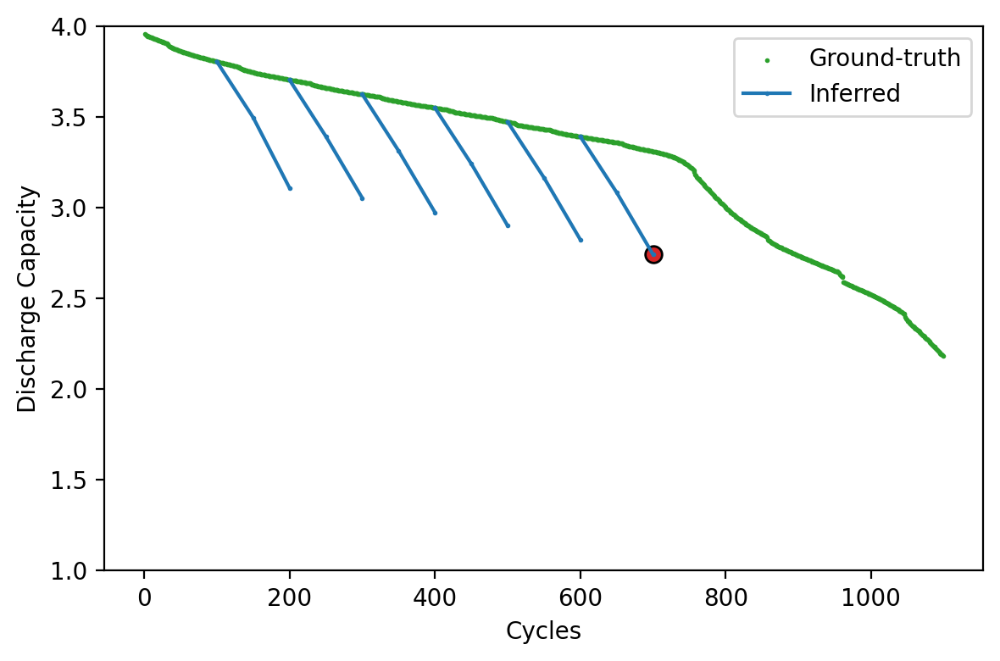

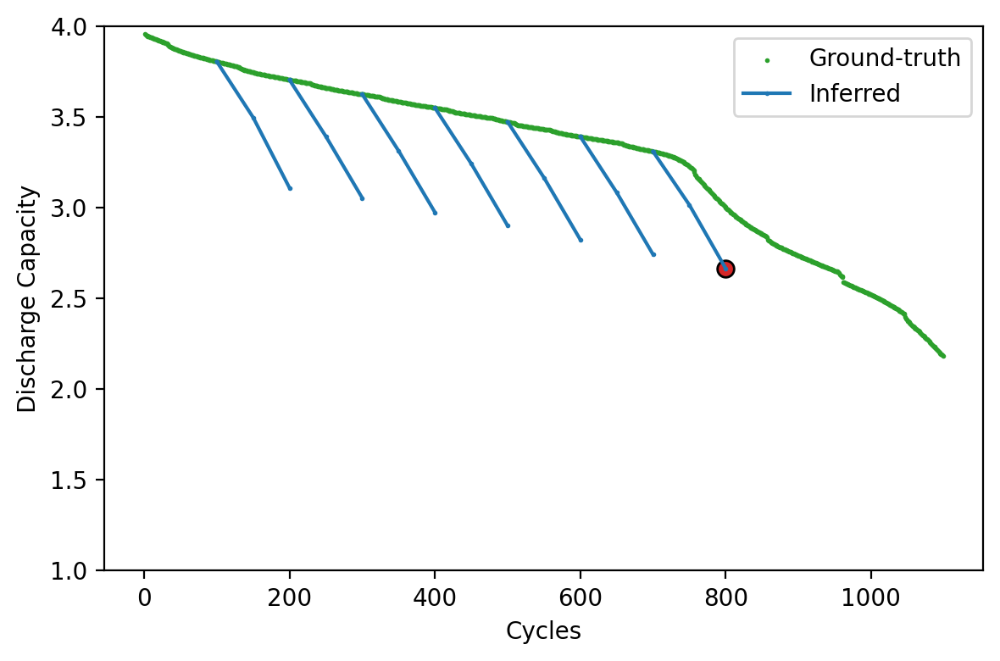

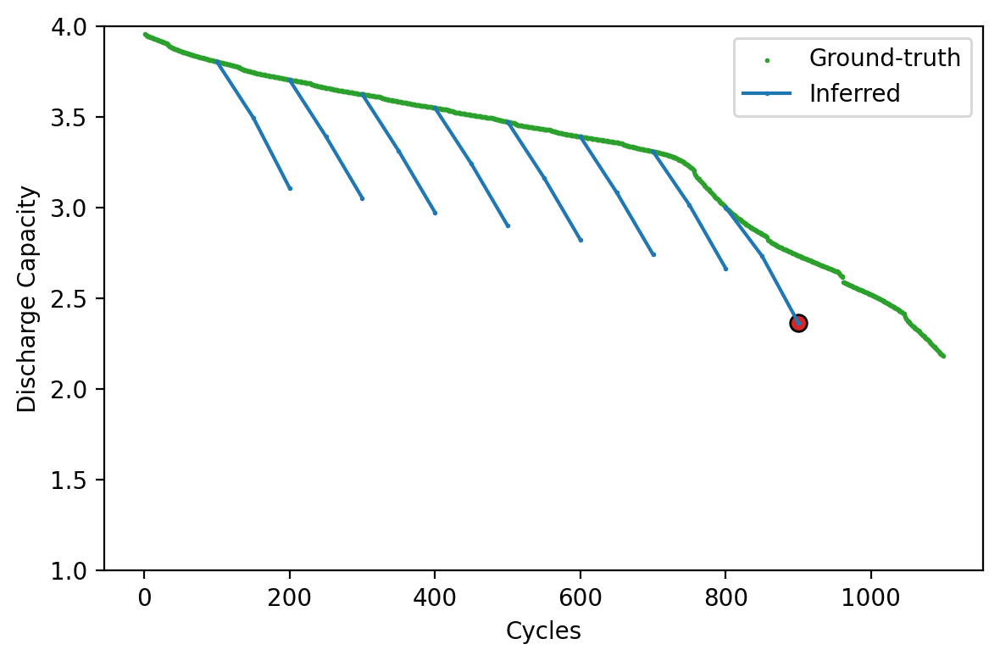

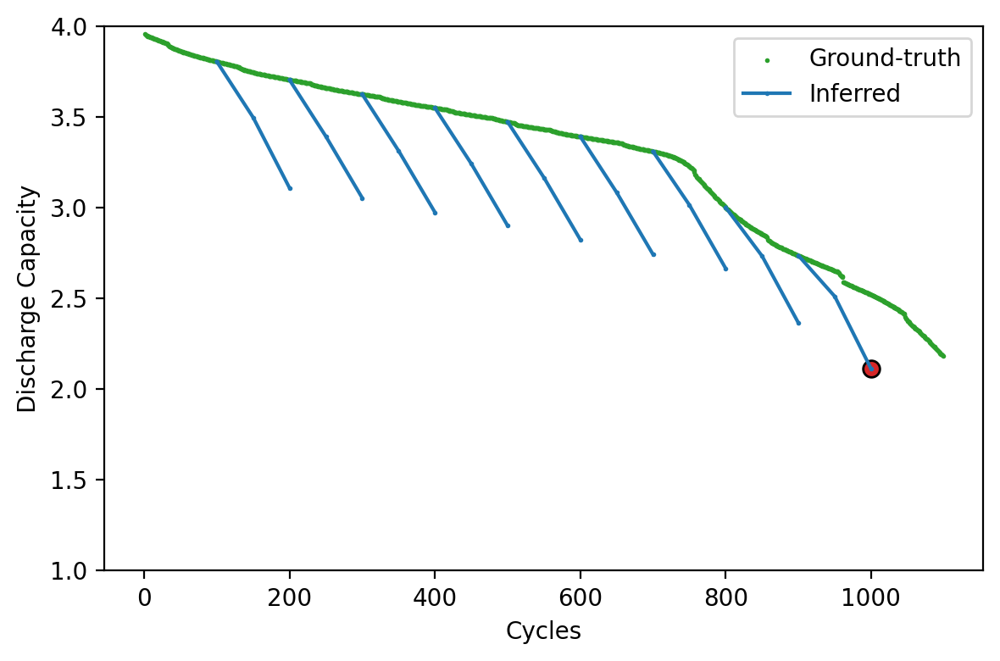

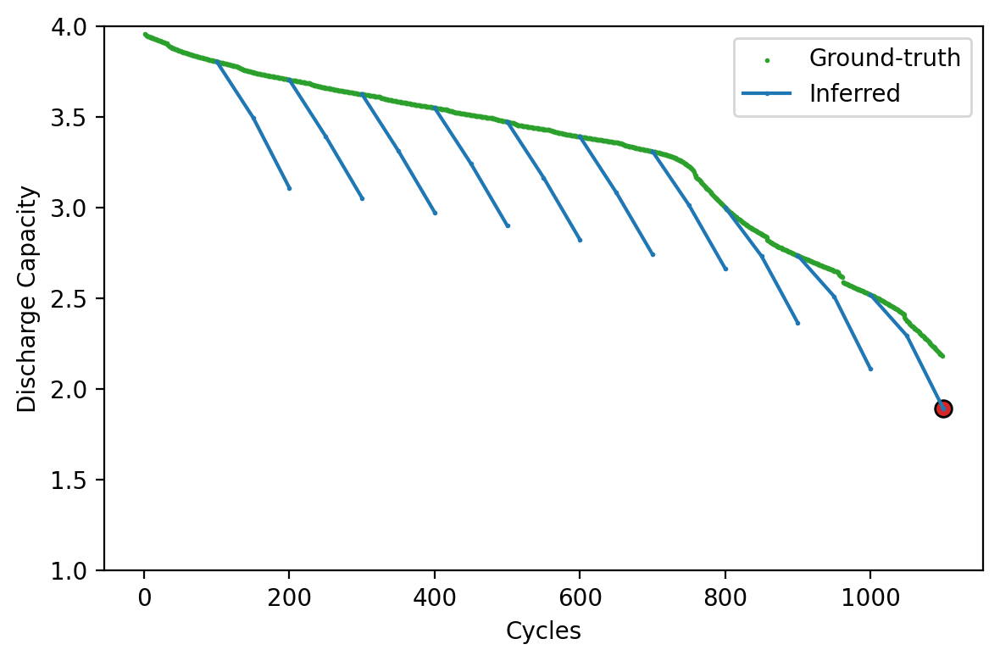

In [165]:
# testing on data
tested_cell = [test_cells[4]]
# X_train_tested_cell = [x for xs in train_cells for x in xs[0]]
# Y_train = np.array([x for xs in train_cells for x in xs[1]])
# Y_train_tested_cell = [x for xs in train_cells for x in xs[1]]
X_tested_cell = [x for cycle in tested_cell for x in cycle[0]]
# Y_test = [x for xs in test_cells for x in xs[1]]
Y_tested_cell = [y for cycle in tested_cell for y in cycle[1]]
dc_tested_cell, slopes_tested_cell = make_label_arrays(Y_tested_cell)
X_tested_cell_time_series, X_tested_cell_dt = make_feature_arrays(X_tested_cell)

scaled_X_tested_cell_dt = standardize_non_train(X_tested_cell_dt, mean_X_train_dt, std_X_train_dt)
scaled_X_tested_cell_time_series = standardize_non_train(X_tested_cell_time_series, mean_X_train_time_series, std_X_train_time_series)[...,1:]

# std_X_tested_cell_time_series = standardize(X_tested_cell_time_series[...,1:])
all_test_slopes = [y[0] for y in Y_tested_cell]
all_test_dc = np.array([y[1] for y in Y_tested_cell])
# Y_hat_tested_cell = model.predict([scaled_X_tested_cell_time_series, scaled_X_tested_cell_dt])
Y_hat_tested_cell = model.predict(scaled_X_tested_cell_time_series)

# initial_dc = all_test_dc.reshape([-1, 2])[cycle_indices[0]]
# index_0 = initial_dc[0]
# for i,m in enumerate(all_test_dc.reshape([-1,2])):
#     plt.scatter(*list(zip(*all_test_dc.reshape([-1,2]))), color = 'C2', s=2, label='Ground-truth' if i == 0 else "")

window_size = 100
scatters = []
for i,m in enumerate(all_test_dc[1:]):
    plt.figure(dpi=200, facecolor='white')
#     print(m[0,0], m[5,0], m[9,0])
    plt.scatter(*list(zip(*all_test_dc.reshape([-1,2]))), color = 'C2', s=1, label='Ground-truth') #if i == 0 else "")
#     if i == 0:
#         initial_dc = m[0]
    initial_dc = m[0]
#     print(m)
#     print(m)
#     break
    predicted_dc_values = [initial_dc]
#     print(initial_dc)
#     if i%2 == 0:
    new_cycle_index = m[0,0]
#         print(f'hi {i}')
    for j,slope in enumerate(Y_hat_tested_cell[i]):
        new_cycle_index += window_size//2
        new_predicted_dc = linear_fit(new_cycle_index, slope, initial_dc) # slopes_tested_cell[i,j]
#         new_predicted_dc = linear_fit(new_cycle_index, -np.exp(-slope), initial_dc)

        print(f'predicted slope: {slope}, True slope: {np.array(slopes_tested_cell)[i,j]}')
        predicted_dc_values.append(np.array([new_cycle_index , new_predicted_dc]))
        initial_dc = predicted_dc_values[-1]
#         print(initial_dc)
      # 
    print(predicted_dc_values)
#     initial_dc = np.array([new_cycle_index, new_predicted_dc]) 
    
#     print(i)
#     print(predicted_dc_values)
#     initial_dc = predicted_dc_values[-1]
    
#     if i==2 or i==1:
#         print(m)
#         break
#     if i ==2:
#         break
    scatters.append(predicted_dc_values)
#     print(np.array(scatters).T)
    plt.plot(*np.array(scatters).T, color='C0', label='Inferred', #if i == 0 else "",
             marker='o', markersize=1)
    plt.scatter(*np.array(predicted_dc_values[-1]).T, c='C3', #if i == 0 else "",
         marker='o', s=50, edgecolor='k', linewidth=1, facecolor='C3', zorder=-1)
    plt.xlabel('Cycles')
    plt.ylabel('Discharge Capacity')
    plt.ylim([1,4])
    ax = plt.gca()
    hand, labl = ax.get_legend_handles_labels()
    plt.legend(np.unique(labl))
    plt.tight_layout()
#     break
#     plt.savefig(f'img/discharge_curve_100_window_test_4_{i:04d}.png', dpi=200, transparent=False)
#     if i ==20:
        
#         break
#     plt.close()
#     break
#     break


In [50]:
(3.746 - 3.805)/50

-0.0011800000000000033

In [49]:
linear_fit(150, -0.017581807418000004, [100, 3.805])

2.9259096291

1/1 [==============================] - 0s 242ms/step
slope: -0.0008221308817155659
slope: -0.0007360809249803424
[array([100.   ,   2.785]), array([150.   ,   2.744]), array([200.   ,   2.707])]
slope: -0.000848281430080533
slope: -0.00074186542769894
[array([200.   ,   2.663]), array([250.   ,   2.621]), array([300.   ,   2.583])]
slope: -0.0008483611745759845
slope: -0.0007419254980050027
[array([300.   ,   2.565]), array([350.   ,   2.523]), array([400.   ,   2.486])]
slope: -0.0008491977350786328
slope: -0.000742367934435606
[array([400.   ,   2.474]), array([450.   ,   2.432]), array([500.   ,   2.395])]
slope: -0.0008501758566126227
slope: -0.0007428834796883166
[array([500.  ,   2.38]), array([550.   ,   2.337]), array([600. ,   2.3])]
slope: -0.0008560233982279897
slope: -0.0007463083020411432
[array([600.   ,   2.174]), array([650.   ,   2.131]), array([700.   ,   2.093])]
slope: -0.0008555512176826596
slope: -0.0007459397311322391
[array([700.  ,   1.64]), array([750.   ,   1

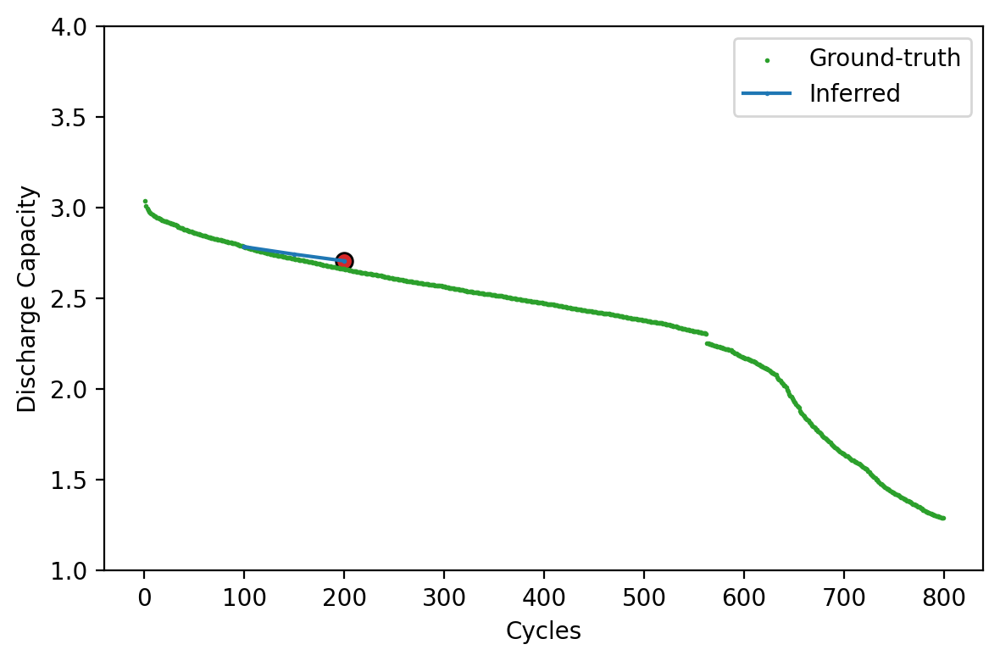

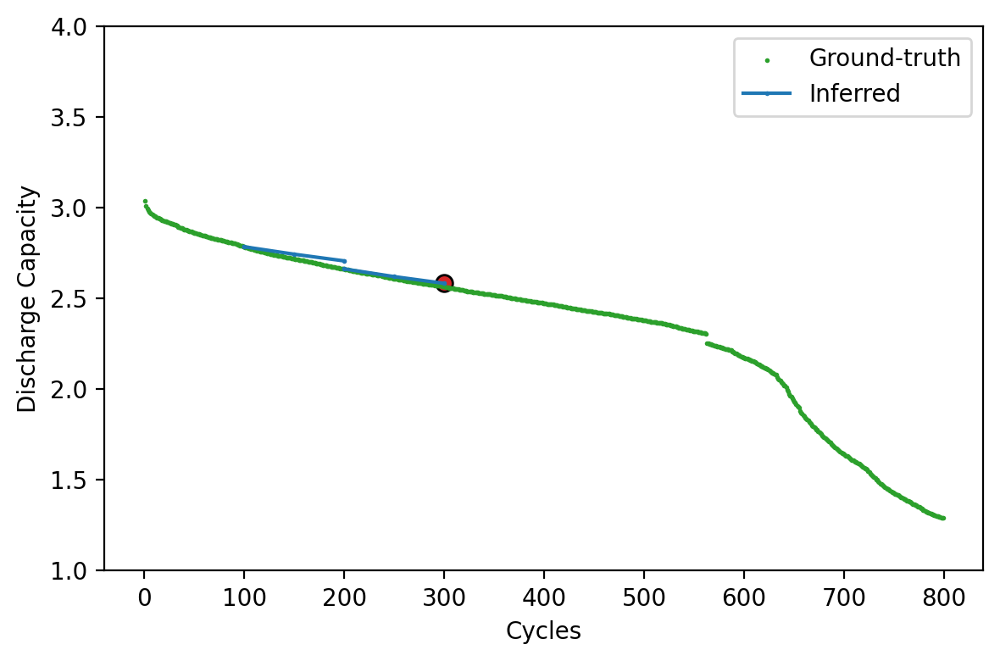

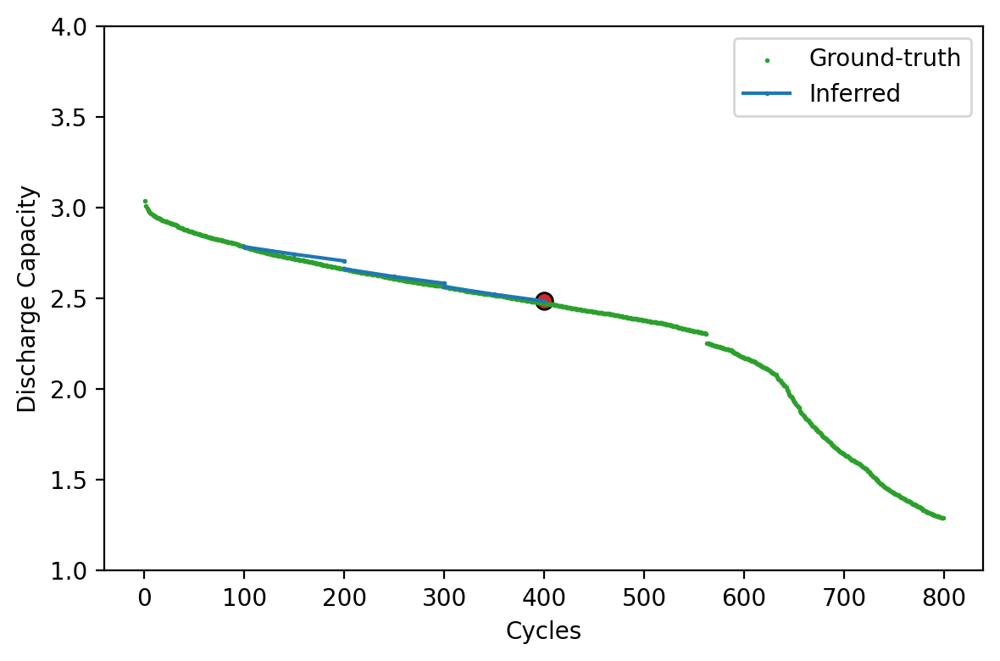

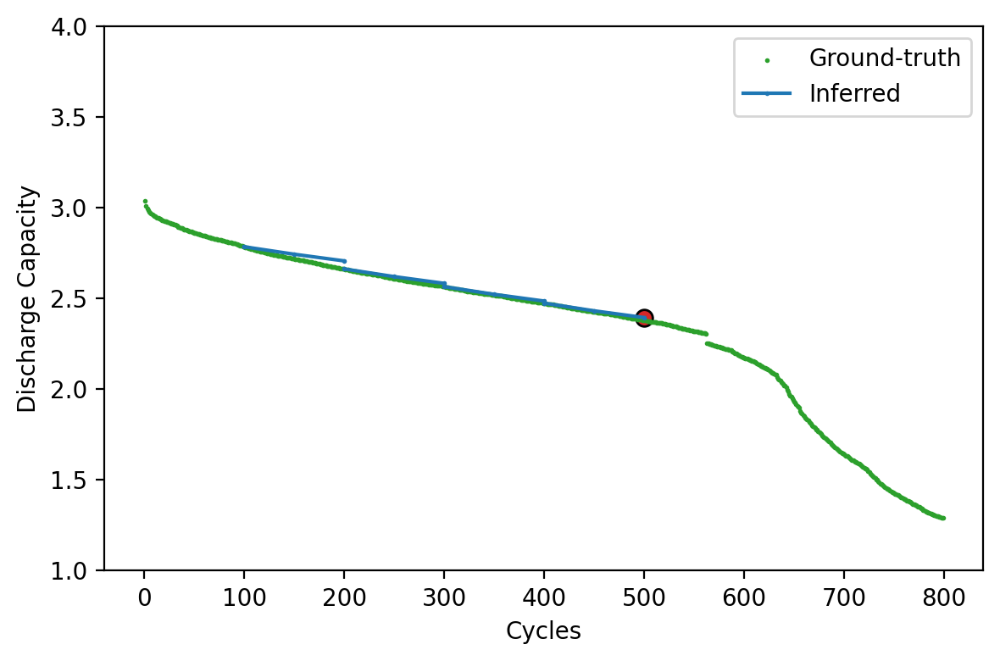

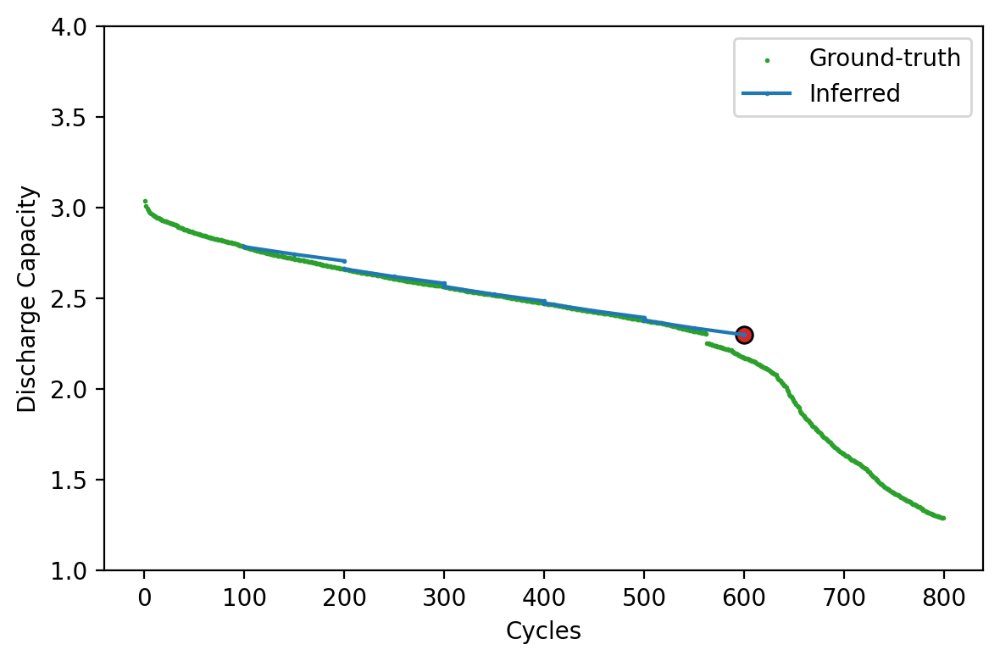

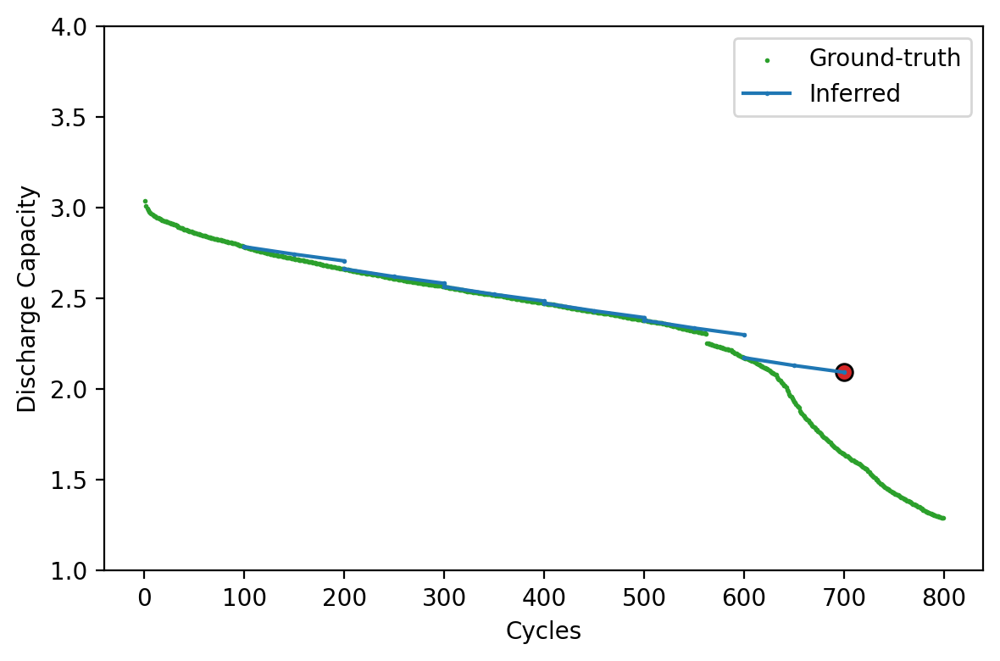

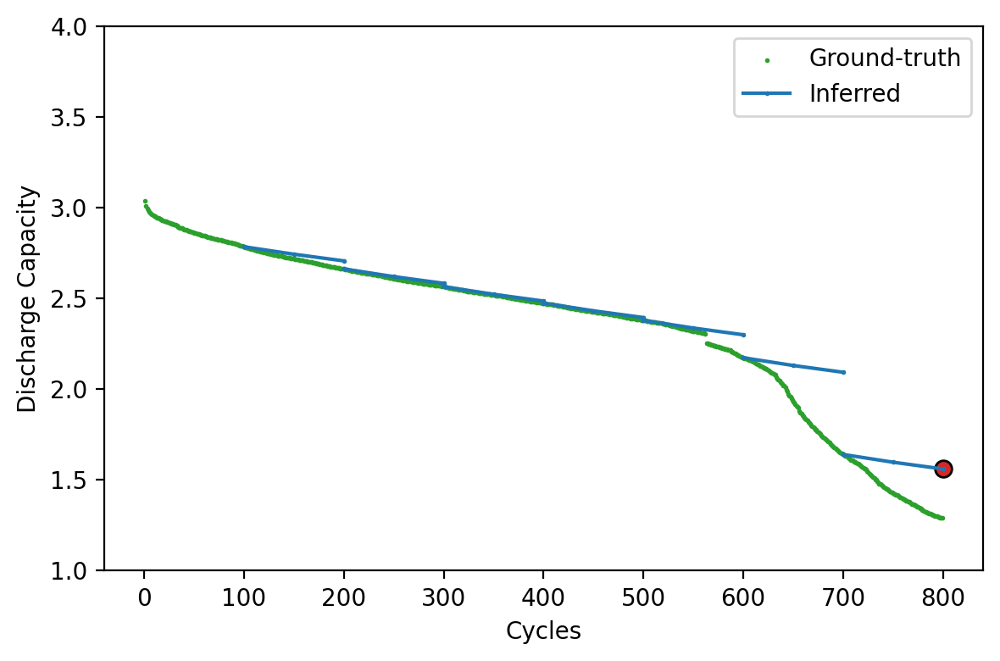

In [1067]:
# testing on data
tested_cell = [test_cells[3]]
# X_train_tested_cell = [x for xs in train_cells for x in xs[0]]
# Y_train = np.array([x for xs in train_cells for x in xs[1]])
# Y_train_tested_cell = [x for xs in train_cells for x in xs[1]]
X_tested_cell = [x for cycle in tested_cell for x in cycle[0]]
# Y_test = [x for xs in test_cells for x in xs[1]]
Y_tested_cell = [y for cycle in tested_cell for y in cycle[1]]
dc_tested_cell, slopes_tested_cell = make_label_arrays(Y_tested_cell)
X_tested_cell_time_series, X_tested_cell_dt = make_feature_arrays(X_tested_cell)

scaled_X_tested_cell_dt = standardize_non_train(X_tested_cell_dt, mean_X_train_dt, std_X_train_dt)
scaled_X_tested_cell_time_series = standardize_non_train(X_tested_cell_time_series, mean_X_train_time_series, std_X_train_time_series)[...,1:]

# std_X_tested_cell_time_series = standardize(X_tested_cell_time_series[...,1:])
all_test_slopes = [y[0] for y in Y_tested_cell]
all_test_dc = np.array([y[1] for y in Y_tested_cell])
Y_hat_tested_cell = model.predict([scaled_X_tested_cell_time_series, scaled_X_tested_cell_dt])

# initial_dc = all_test_dc.reshape([-1, 2])[cycle_indices[0]]
# index_0 = initial_dc[0]
# for i,m in enumerate(all_test_dc.reshape([-1,2])):
#     plt.scatter(*list(zip(*all_test_dc.reshape([-1,2]))), color = 'C2', s=2, label='Ground-truth' if i == 0 else "")

window_size = 100
scatters = []
for i,m in enumerate(all_test_dc[1:]):
    plt.figure(dpi=200, facecolor='white')
#     print(m[0,0], m[5,0], m[9,0])
    plt.scatter(*list(zip(*all_test_dc.reshape([-1,2]))), color = 'C2', s=1, label='Ground-truth') #if i == 0 else "")
#     if i == 0:
#         initial_dc = m[0]
    initial_dc = m[0]
#     print(m)
#     print(m)
#     break
    predicted_dc_values = [initial_dc]
#     print(initial_dc)
#     if i%2 == 0:
    new_cycle_index = m[0,0]
#         print(f'hi {i}')
    for j,slope in enumerate(Y_hat_tested_cell[i]):
        new_cycle_index += window_size//2
        new_predicted_dc = linear_fit(new_cycle_index, -np.exp(-slope), initial_dc)
        print(f'slope: {-np.exp(-slope)}')
        predicted_dc_values.append(np.array([new_cycle_index , new_predicted_dc]))
        initial_dc = predicted_dc_values[-1]
#         print(initial_dc)
      # 
    print(predicted_dc_values)
#     initial_dc = np.array([new_cycle_index, new_predicted_dc]) 
    
#     print(i)
#     print(predicted_dc_values)
#     initial_dc = predicted_dc_values[-1]
    
#     if i==2 or i==1:
#         print(m)
#         break
#     if i ==2:
#         break
    scatters.append(predicted_dc_values)
#     print(np.array(scatters).T)
    plt.plot(*np.array(scatters).T, color='C0', label='Inferred', #if i == 0 else "",
             marker='o', markersize=1)
    plt.scatter(*np.array(predicted_dc_values[-1]).T, c='C3', #if i == 0 else "",
         marker='o', s=50, edgecolor='k', linewidth=1, facecolor='C3', zorder=-1)
    plt.xlabel('Cycles')
    plt.ylabel('Discharge Capacity')
    plt.ylim([1,4])
    ax = plt.gca()
    hand, labl = ax.get_legend_handles_labels()
    plt.legend(np.unique(labl))
    plt.tight_layout()
#     plt.savefig(f'img/discharge_curve_100_window_{i:04d}.png', dpi=200, transparent=False)
#     if i ==20:
        
#         break
#     plt.close()
#     break
#     break


In [1082]:
Y_hat_tested_cell

array([[6.165, 6.38 ],
       [6.421, 6.589],
       [6.41 , 6.581],
       [6.404, 6.577],
       [6.403, 6.576],
       [6.382, 6.56 ],
       [6.355, 6.542],
       [6.27 , 6.478],
       [5.947, 6.178],
       [4.587, 5.011]], dtype=float32)

In [1084]:
Y_hat_tested_cell

array([[5.841, 6.057],
       [6.073, 6.256],
       [6.059, 6.249],
       [6.047, 6.242],
       [6.035, 6.235],
       [6.08 , 6.275],
       [5.563, 5.8  ],
       [4.677, 5.05 ]], dtype=float32)

1/1 [==============================] - 0s 266ms/step
slope: -0.0029065932612866163
slope: -0.00234186090528965
[array([100.   ,   3.779]), array([150.   ,   3.634]), array([200.   ,   3.517])]
slope: -0.0023047919385135174
slope: -0.0019195347558706999
[array([200.   ,   3.657]), array([250.   ,   3.542]), array([300.   ,   3.446])]
slope: -0.002336573787033558
slope: -0.0019320618594065309
[array([300.   ,   3.527]), array([350.  ,   3.41]), array([400.   ,   3.313])]
slope: -0.002366095781326294
slope: -0.0019467717502266169
[array([400.   ,   3.382]), array([450.   ,   3.264]), array([500.   ,   3.166])]
slope: -0.002393354196101427
slope: -0.001959422370418906
[array([500.  ,   3.24]), array([550.   ,   3.121]), array([600.   ,   3.023])]
slope: -0.0022870381362736225
slope: -0.0018822874408215284
[array([600.   ,   3.107]), array([650.   ,   2.992]), array([700.   ,   2.898])]
slope: -0.0038386816158890724
slope: -0.003027202095836401
[array([700.   ,   2.908]), array([750.   ,   

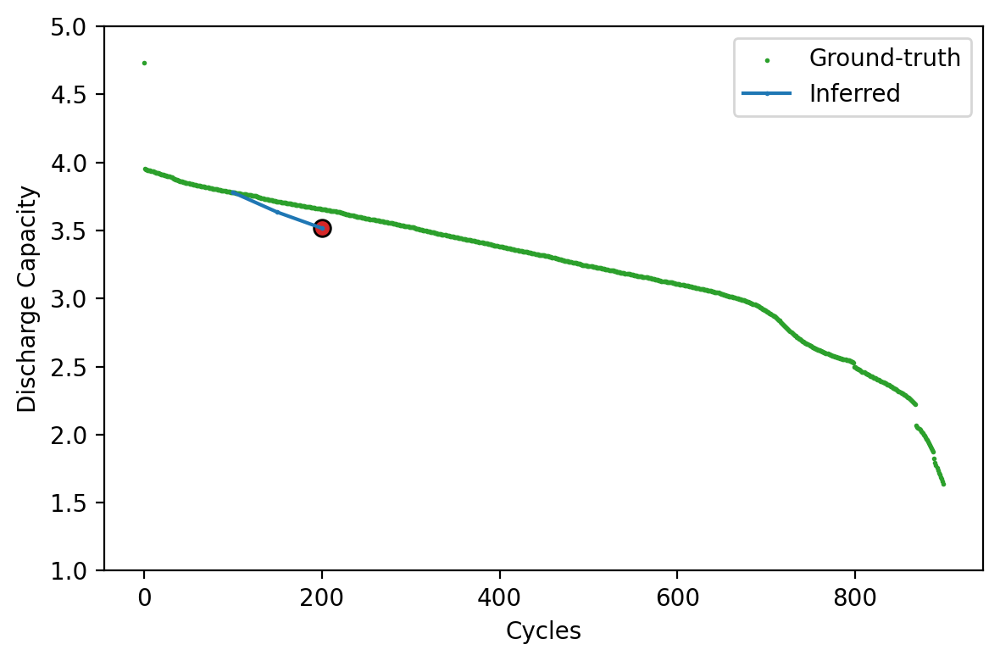

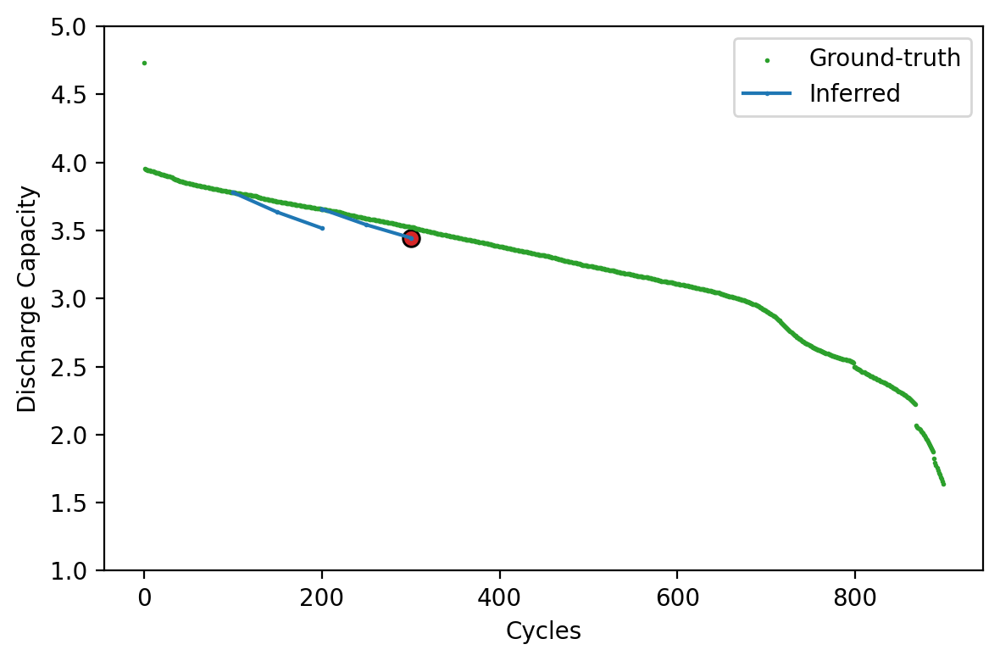

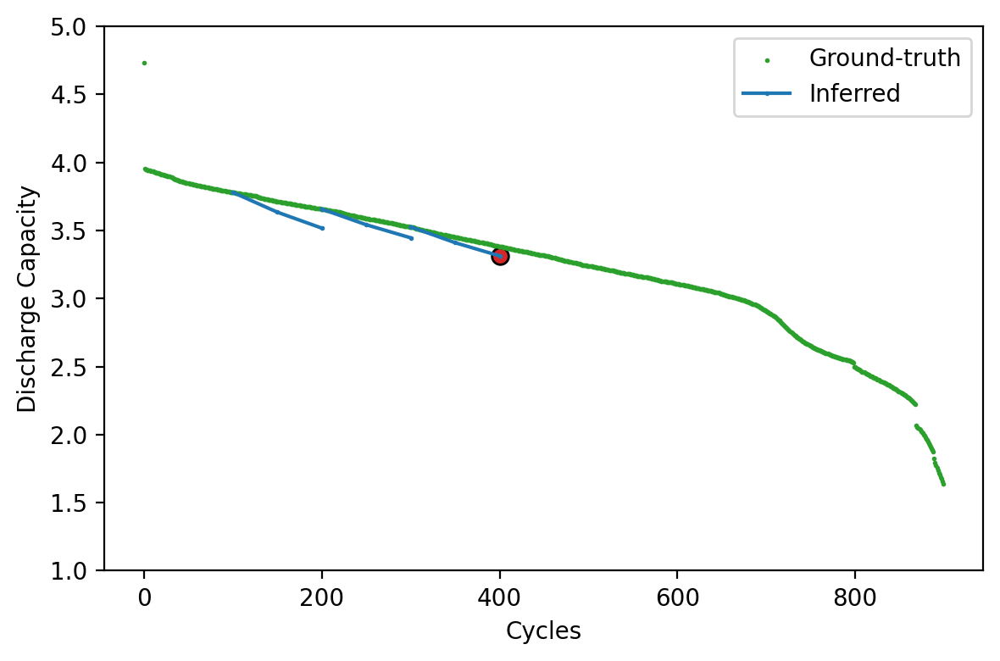

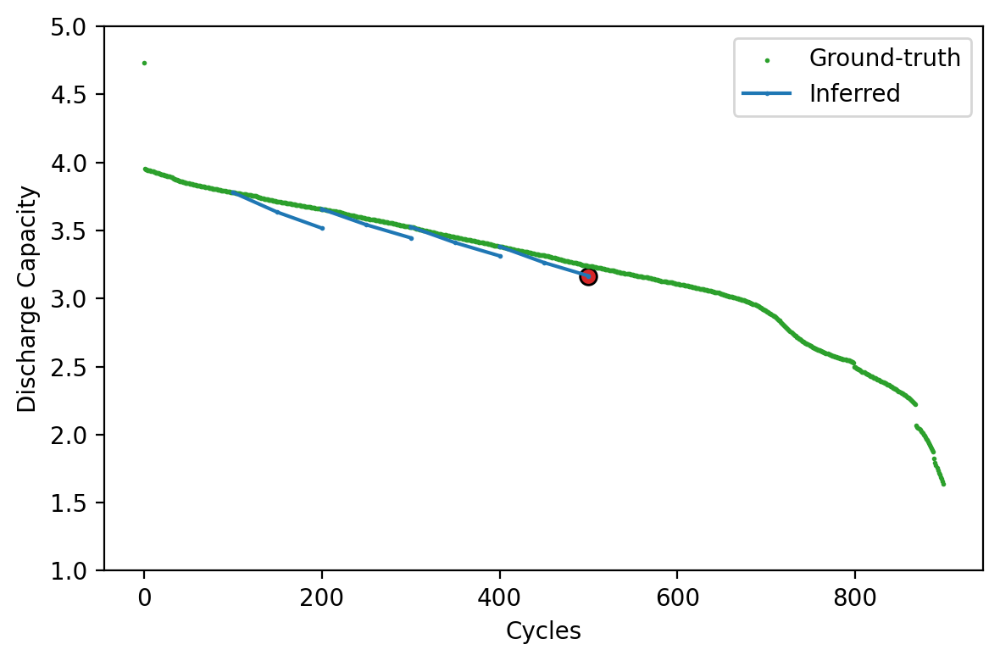

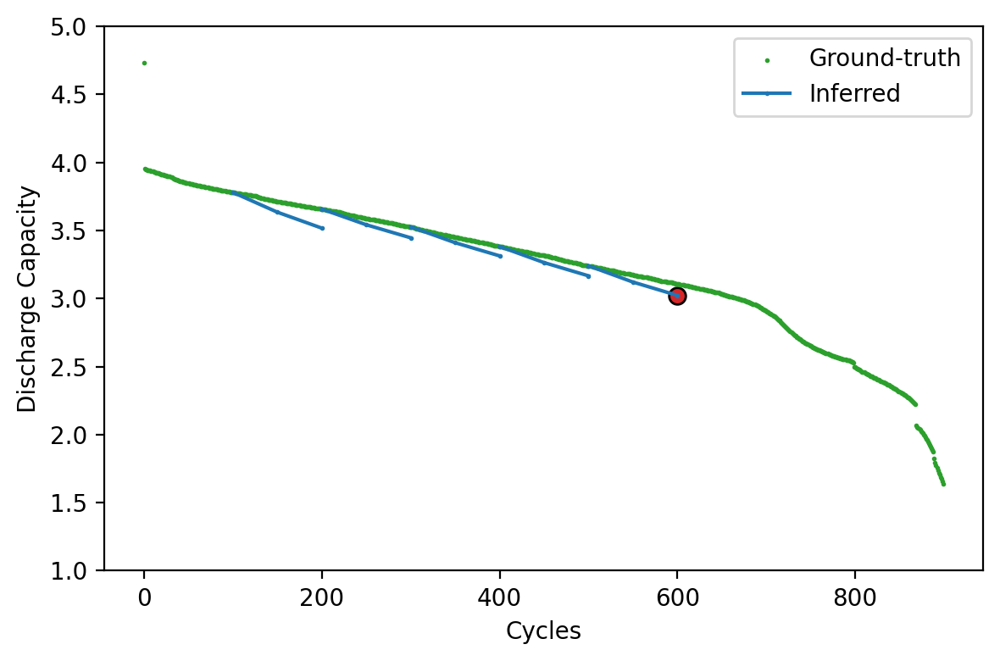

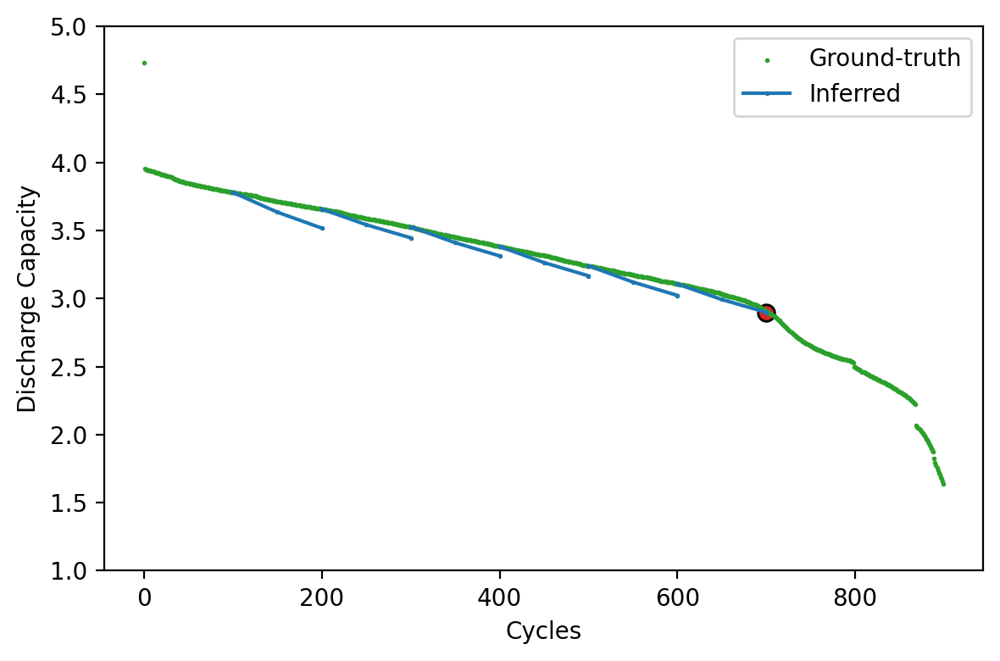

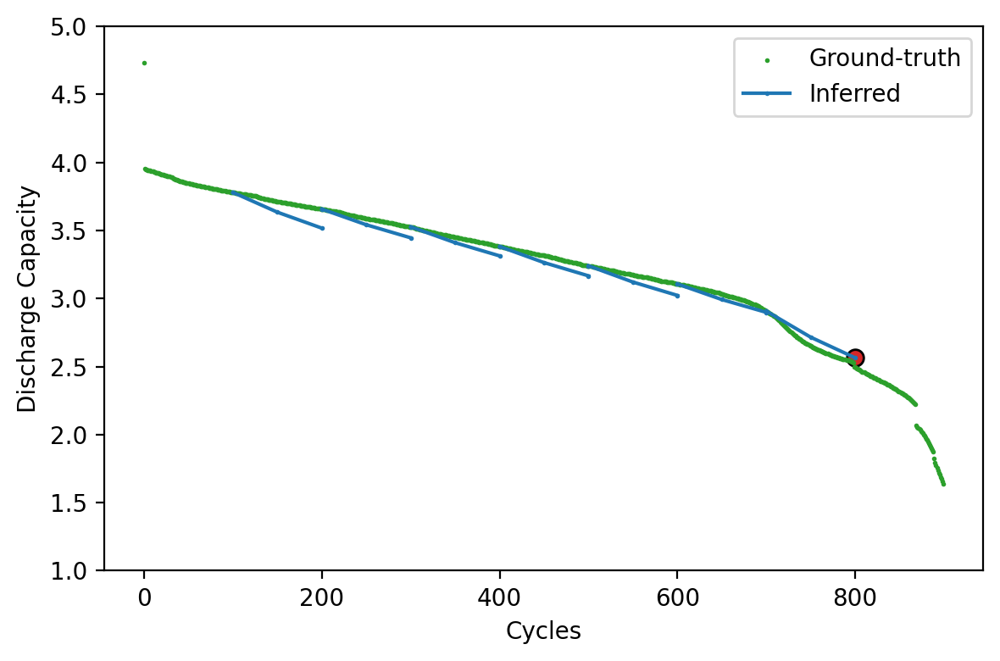

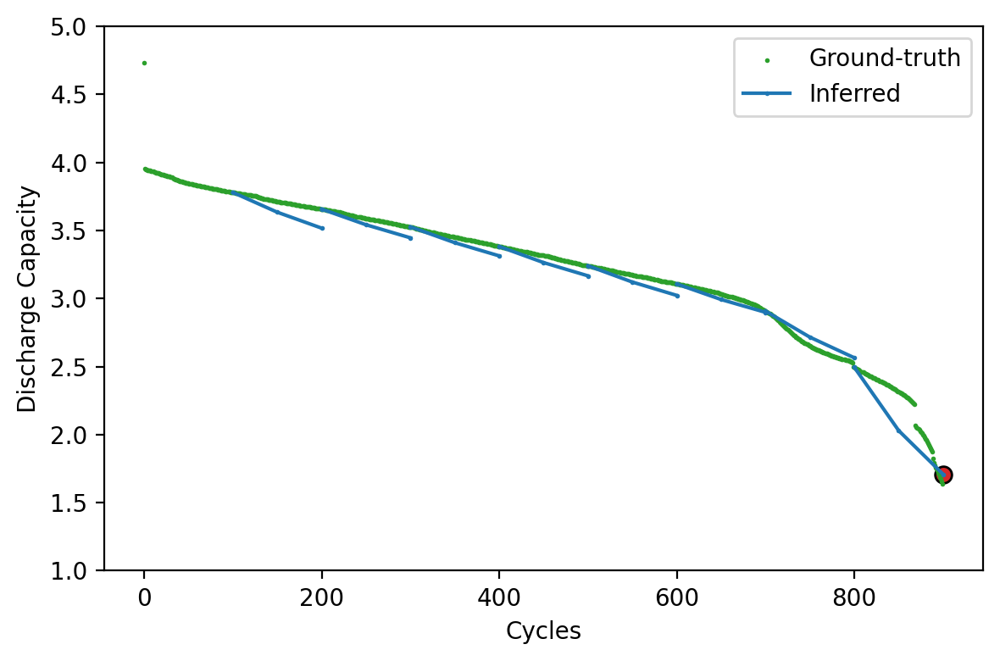

In [1083]:
# testing on data
tested_cell = [test_cells[15]]
# X_train_tested_cell = [x for xs in train_cells for x in xs[0]]
# Y_train = np.array([x for xs in train_cells for x in xs[1]])
# Y_train_tested_cell = [x for xs in train_cells for x in xs[1]]
X_tested_cell = [x for cycle in tested_cell for x in cycle[0]]
# Y_test = [x for xs in test_cells for x in xs[1]]
Y_tested_cell = [y for cycle in tested_cell for y in cycle[1]]
dc_tested_cell, slopes_tested_cell = make_label_arrays(Y_tested_cell)
X_tested_cell_time_series, X_tested_cell_dt = make_feature_arrays(X_tested_cell)

scaled_X_tested_cell_dt = standardize_non_train(X_tested_cell_dt, mean_X_train_dt, std_X_train_dt)
scaled_X_tested_cell_time_series = standardize_non_train(X_tested_cell_time_series, mean_X_train_time_series, std_X_train_time_series)[...,1:]

# std_X_tested_cell_time_series = standardize(X_tested_cell_time_series[...,1:])
all_test_slopes = [y[0] for y in Y_tested_cell]
all_test_dc = np.array([y[1] for y in Y_tested_cell])
Y_hat_tested_cell = model.predict([scaled_X_tested_cell_time_series, scaled_X_tested_cell_dt])

# initial_dc = all_test_dc.reshape([-1, 2])[cycle_indices[0]]
# index_0 = initial_dc[0]
# for i,m in enumerate(all_test_dc.reshape([-1,2])):
#     plt.scatter(*list(zip(*all_test_dc.reshape([-1,2]))), color = 'C2', s=2, label='Ground-truth' if i == 0 else "")

window_size = 100
scatters = []
for i,m in enumerate(all_test_dc[1:]):
    plt.figure(dpi=200, facecolor='white')
#     print(m[0,0], m[5,0], m[9,0])
    plt.scatter(*list(zip(*all_test_dc.reshape([-1,2]))), color = 'C2', s=1, label='Ground-truth') #if i == 0 else "")
#     if i == 0:
#         initial_dc = m[0]
    initial_dc = m[0]
#     print(m)
#     print(m)
#     break
    predicted_dc_values = [initial_dc]
#     print(initial_dc)
#     if i%2 == 0:
    new_cycle_index = m[0,0]
#         print(f'hi {i}')
    for j,slope in enumerate(Y_hat_tested_cell[i]):
        new_cycle_index += window_size//2
        new_predicted_dc = linear_fit(new_cycle_index, -np.exp(-slope), initial_dc)
        print(f'slope: {-np.exp(-slope)}')
        predicted_dc_values.append(np.array([new_cycle_index , new_predicted_dc]))
        initial_dc = predicted_dc_values[-1]
#         print(initial_dc)
      # 
    print(predicted_dc_values)
#     initial_dc = np.array([new_cycle_index, new_predicted_dc]) 
    
#     print(i)
#     print(predicted_dc_values)
#     initial_dc = predicted_dc_values[-1]
    
#     if i==2 or i==1:
#         print(m)
#         break
#     if i ==2:
#         break
    scatters.append(predicted_dc_values)
#     print(np.array(scatters).T)
    plt.plot(*np.array(scatters).T, color='C0', label='Inferred', #if i == 0 else "",
             marker='o', markersize=1)
    plt.scatter(*np.array(predicted_dc_values[-1]).T, c='C3', #if i == 0 else "",
         marker='o', s=50, edgecolor='k', linewidth=1, facecolor='C3', zorder=-1)
    plt.xlabel('Cycles')
    plt.ylabel('Discharge Capacity')
    plt.ylim([1,5])
    ax = plt.gca()
    hand, labl = ax.get_legend_handles_labels()
    plt.legend(np.unique(labl))
    plt.tight_layout()
#     plt.savefig(f'img/discharge_curve_100_window_{i:04d}.png', dpi=200, transparent=False)
#     if i ==20:
        
#         break
#     plt.close()
#     break
#     break


In [ ]:
# window_size = 40
# scatters = []
# for i,m in enumerate(all_test_dc[1:]):
#     plt.figure(dpi=200, facecolor='white')
# #     print(m[0,0], m[5,0], m[9,0])
#     plt.scatter(*list(zip(*all_test_dc.reshape([-1,2]))), color = 'C2', s=1, label='Ground-truth') #if i == 0 else "")
#     if i == 0:
#         initial_dc = m[0]
        
# #     print(m)
# #     print(m)
#     predicted_dc_values = [initial_dc]
# #     print(initial_dc)
#     if i%2 == 0:
#         new_cycle_index = m[19,0]
# #         print(f'hi {i}')
#     else: 
#         new_cycle_index = m[-1,0]
#     for j,slope in enumerate(Y_hat_tested_cell[i]):
#         if j == 0:
#             new_cycle_index = m[19,0]
#         else:
#             new_cycle_index = m[39,0]
#         new_predicted_dc = linear_fit(new_cycle_index, -np.exp(-slope), initial_dc)
#         predicted_dc_values.append(np.array([new_cycle_index , new_predicted_dc]))
#         initial_dc = predicted_dc_values[-1]
# #         print(initial_dc)
#       # 
#     print(predicted_dc_values)
# #     initial_dc = np.array([new_cycle_index, new_predicted_dc]) 
    
# #     print(i)
# #     print(predicted_dc_values)
#     initial_dc = predicted_dc_values[-1]
# #     if i==2 or i==1:
# #         print(m)
# #         break
# #     if i ==2:
# #         break
#     scatters.append(predicted_dc_values)
# #     print(np.array(scatters).T)
#     plt.plot(*np.array(scatters).T, color='C0', label='Inferred', #if i == 0 else "",
#              marker='o', markersize=1)
#     plt.scatter(*np.array(predicted_dc_values[-1]).T, c='C3', #if i == 0 else "",
#          marker='o', s=50, edgecolor='k', linewidth=1, facecolor='C3', zorder=-1)
#     plt.xlabel('Cycles')
#     plt.ylabel('Discharge Capacity')
#     plt.ylim([1,4])
#     ax = plt.gca()
#     hand, labl = ax.get_legend_handles_labels()
#     plt.legend(np.unique(labl))
#     plt.tight_layout()
# #     plt.savefig(f'img/discharge_curve_{i:04d}.png', dpi=200, transparent=False)
# #     if i ==20:
        
# #         break
# #     plt.close()
# #     break
# #     break

In [287]:
m

array([[1245.   ,    2.199],
       [1246.   ,    2.195],
       [1247.   ,    2.191],
       [1248.   ,    2.187],
       [1249.   ,    2.183],
       [1250.   ,    2.179],
       [1251.   ,    2.175],
       [1252.   ,    2.172],
       [1253.   ,    2.167],
       [1254.   ,    2.164]])

In [288]:
# obtain initial dc value from GT
window_size = 10
scatters = []
for i,m in enumerate(all_test_dc[1:]):
    plt.figure(dpi=200, facecolor='white')
#     print(m[0,0], m[5,0], m[9,0])
    plt.scatter(*list(zip(*all_test_dc.reshape([-1,2]))), color = 'C2', s=1, label='Ground-truth') #if i == 0 else "")
#     if i == 0:
    initial_dc = m[0]
#     print(m)
#     print(m)
    predicted_dc_values = [initial_dc]
#     print(initial_dc)
    if i%2 == 0:
        new_cycle_index = m[5,0]
#         print(f'hi {i}')
    else: 
        new_cycle_index = m[-1,0]
    for j,slope in enumerate(Y_hat_tested_cell[i]):
        if j == 0:
            new_cycle_index = m[5,0]
        else:
            new_cycle_index = m[9,0]
        new_predicted_dc = linear_fit(new_cycle_index, slope, initial_dc)
        predicted_dc_values.append(np.array([new_cycle_index , new_predicted_dc]))
#         initial_dc = predicted_dc_values[-1]
      # 
#     initial_dc = np.array([new_cycle_index, new_predicted_dc]) 
    
#     print(i)
#     print(predicted_dc_values)
    initial_dc = predicted_dc_values[-1]
#     if i==2 or i==1:
#         print(m)
#         break
#     if i ==2:
#         break
    scatters.append(predicted_dc_values)
#     print(np.array(scatters).T)
    plt.plot(*np.array(scatters).T, color='C0', label='Inferred', #if i == 0 else "",
             marker='o', markersize=1)
    plt.scatter(*np.array(predicted_dc_values[-1]).T, c='C3', #if i == 0 else "",
         marker='o', s=50, edgecolor='k', linewidth=1, facecolor='C3', zorder=-1)
    plt.xlabel('Cycles')
    plt.ylabel('Discharge Capacity')
    plt.ylim([1,4])
    ax = plt.gca()
    hand, labl = ax.get_legend_handles_labels()
    plt.legend(np.unique(labl))
    plt.tight_layout()
    plt.savefig(f'img/discharge_curve_initial_dc_from_GT_{i:04d}.png', dpi=200, transparent=False)
#     if i ==20:
        
#         break
    plt.close()

-0.0020526012
[array([9.   , 3.968]), array([11.   ,  3.964])]
-0.0016694856
[array([11.   ,  3.964]), array([13.  ,  3.96])]
-0.0020041084
[array([13.  ,  3.96]), array([15.   ,  3.956])]
-0.0016058914
[array([15.   ,  3.956]), array([17.   ,  3.953])]
-0.0020050171
[array([17.   ,  3.953]), array([19.   ,  3.949])]
-0.0016071951
[array([19.   ,  3.949]), array([21.   ,  3.946])]
-0.0020037354
[array([21.   ,  3.946]), array([23.   ,  3.942])]
-0.0016053959
[array([23.   ,  3.942]), array([25.   ,  3.939])]
-0.0020038148
[array([25.   ,  3.939]), array([27.   ,  3.935])]
-0.0016055123
[array([27.   ,  3.935]), array([29.   ,  3.932])]
-0.0020033927
[array([29.   ,  3.932]), array([31.   ,  3.928])]
-0.0016049109
[array([31.   ,  3.928]), array([33.   ,  3.924])]
-0.0020021512
[array([33.   ,  3.924]), array([35.  ,  3.92])]
-0.0016034532
[array([35.  ,  3.92]), array([37.   ,  3.917])]
-0.0020040404
[array([37.   ,  3.917]), array([39.   ,  3.913])]
-0.0016057711
[array([39.   ,  3.91

Text(0, 0.5, 'Discharge Capacity')

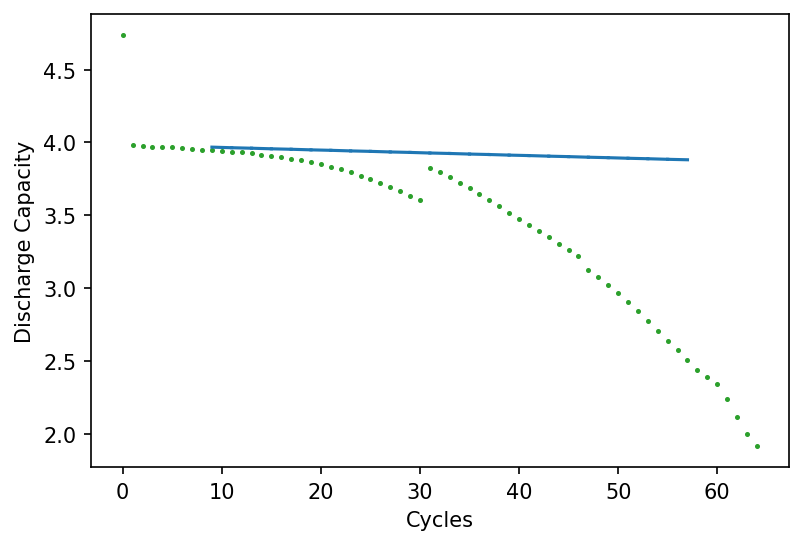

In [137]:

for i,slope in enumerate(Y_hat_tested_cell.flatten()):
    print(slope)
#     print(cycle_indices[i], cycle_indices[i+1])
    predicted_dc_values = [initial_dc]
    new_cycle_index = index_0 + cycle_window//2*(i+1)
#     new_predicted_dc = linear_fit(cycle_indices[i+1], slope, predicted_dc_values[0])
    new_predicted_dc = linear_fit(new_cycle_index, slope, predicted_dc_values[0]) 
    predicted_dc_values.append(np.array([new_cycle_index , new_predicted_dc]))
    initial_dc = np.array([new_cycle_index, new_predicted_dc]) 
    plt.plot(*np.array(predicted_dc_values).T, color='C0')
#         break
    print(predicted_dc_values)
    
#     print(predicted_dc_values)


In [140]:
np.array(predicted_dc_values)[0]

array([20.   ,  3.907])

In [128]:
predicted_dc[0]

array([20.   ,  3.907])

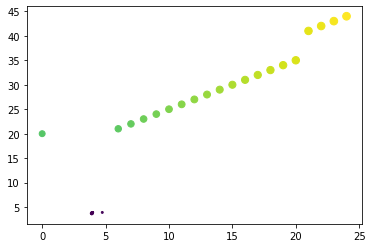

In [63]:
plt.scatter(*all_test_dc)

In [52]:
X_test = [x for xs in test_cells for x in xs[0]]
# Y_test= np.array([x for xs in test_cells for x in xs[1]])
Y_test = [x for xs in test_cells for x in xs[1]]
dc_test, slopes_test = make_label_arrays(Y_test)
X_test_time_series, X_test_dt = make_feature_arrays(X_test)

4

In [53]:
X_train_tested_cell[0]

[(-0.07988863284999996, -0.007702071219999995),
 array([[ 0.   ,  4.74 ],
        [ 6.   ,  3.981],
        [ 7.   ,  3.974],
        [ 8.   ,  3.971],
        [ 9.   ,  3.968],
        [10.   ,  3.966],
        [11.   ,  3.961],
        [12.   ,  3.956],
        [13.   ,  3.952],
        [14.   ,  3.947],
        [15.   ,  3.941],
        [16.   ,  3.937],
        [17.   ,  3.931],
        [18.   ,  3.925],
        [19.   ,  3.915],
        [20.   ,  3.907],
        [21.   ,  3.899],
        [22.   ,  3.889],
        [23.   ,  3.877],
        [24.   ,  3.864]])]

In [ ]:

# X_train = [d[0] for d in train_data]
# y_train = [d[1]for d in train_data]
# Now flatten nested lists
# train_time_series_features = [(x[0],x[1]) for xs in train_cells for (x[0],x[1]) in xs]
train_time_values = [x for xs in train_cells for x in xs]
# y_train = [(x,y) for ys in train_cells for (x,y) in ys]

# X_val = [x for xs in val_cells for x in xs[0]]
# y_val = [y for ys in val_data for y in ys[1]]

# X_test = [x for xs in test_cells for x in xs[0]]
# y_test = [y for ys in test_data for y in ys[1]]

In [274]:
features_list = []
labels_list = []
for cell in train_cells:
    f = cell[0]
#     features_list.append(cell[0])
#     labels_list.append(cell[1])
    l = cell[1]
    break

In [229]:
# need to fix not including diagnostic in window
def find_renumbedred_index(cell):
    '''This function finds the renumbered index for the cycles that are followed by a diagnostic cycle'''
    renumbered_index_for_cycle_following_a_diagnostic_cycle = []
    i = 0
    for k,cycle in enumerate(cell):
        actual_cycle_index = np.unique(cycle['cycle_index'])[0]
#         print(i, actual_cycle_index)
        if actual_cycle_index != i:
            renumbered_index_for_cycle_following_a_diagnostic_cycle.append(k-1)
            i = actual_cycle_index
        i += 1
#     print(i, actual_cycle_index)
    return renumbered_index_for_cycle_following_a_diagnostic_cycle


def index_convoluter(cell, cycle_window_size=20, overlap_cycle_window=False,
                     overlap_size=5, skip_diagnistic_in_window=False):
    '''This function generates a nested list of indices by convolting the cycles based on cycle_window_size. 
        You can choose to have your window of cycles overlap, or skipp the windows that involve diagnostic cycles in between.
    '''
    max_cycle_index = len(cell) #30 #
    if cycle_window_size < overlap_size:
        raise ValueError(f'If overlapping, overlap_size ({overlap_size}) should be samller than cycle_window_size ({cycle_window_size}). Please check inputs.')
    if not cycle_window_size < max_cycle_index:
        raise ValueError(f'cycle_window_size ({cycle_window_size}) should be samller than maximum number of cycles in cell ({max_cycle_index}). Please check inputs.')
    if overlap_cycle_window:
        non_overlap =  cycle_window_size - overlap_size
    else:
        non_overlap = cycle_window_size
    intervals = range(0, max_cycle_index, non_overlap)
    if not skip_diagnistic_in_window:
        index_covolutions = [list(range(x, x + cycle_window_size)) for x in intervals if x <= max_cycle_index-cycle_window_size]
    else:
#         skipped_indices = [5, 6, 7, 20]
        skipped_indices = find_renumbedred_index(cell)
        print(skipped_indices)
        index_covolutions = [list(range(x, x + cycle_window_size)) for x in intervals if x <= max_cycle_index-cycle_window_size]
                             and not (set(list(range(x, x + cycle_window_size))[:-1]) & set(skipped_indices))]
    return index_covolutions

In [ ]:
for 

In [283]:
f[0][0][0]

(array([[ 0.   ,  2.701, -0.691],
        [ 0.   ,  2.716, -0.692],
        [ 0.   ,  2.731, -0.691],
        [ 0.   ,  2.746, -0.692],
        [ 0.   ,  2.76 , -0.692],
        [ 0.   ,  2.775, -0.692],
        [ 0.   ,  2.79 , -0.692],
        [ 0.   ,  2.805, -0.692],
        [ 0.   ,  2.82 , -0.692],
        [ 0.   ,  2.835, -0.692],
        [ 0.   ,  2.85 , -0.692],
        [ 0.   ,  2.865, -0.692],
        [ 0.   ,  2.88 , -0.691],
        [ 0.   ,  2.895, -0.691],
        [ 0.   ,  2.91 , -0.692],
        [ 0.   ,  2.925, -0.691],
        [ 0.   ,  2.94 , -0.692],
        [ 0.   ,  2.954, -0.692],
        [ 0.   ,  2.969, -0.692],
        [ 0.   ,  2.984, -0.692],
        [ 0.   ,  2.999, -0.692],
        [ 0.   ,  3.014, -0.691],
        [ 0.   ,  3.029, -0.692],
        [ 0.   ,  3.044, -0.692],
        [ 0.   ,  3.059, -0.692],
        [ 0.   ,  3.074, -0.691],
        [ 0.   ,  3.089, -0.692],
        [ 0.   ,  3.104, -0.692],
        [ 0.   ,  3.119, -0.691],
        [ 0.  

In [266]:
train_time_values[0][0]

[((array([[ 0.   ,  2.701, -0.691],
          [ 0.   ,  2.716, -0.692],
          [ 0.   ,  2.731, -0.691],
          [ 0.   ,  2.746, -0.692],
          [ 0.   ,  2.76 , -0.692],
          [ 0.   ,  2.775, -0.692],
          [ 0.   ,  2.79 , -0.692],
          [ 0.   ,  2.805, -0.692],
          [ 0.   ,  2.82 , -0.692],
          [ 0.   ,  2.835, -0.692],
          [ 0.   ,  2.85 , -0.692],
          [ 0.   ,  2.865, -0.692],
          [ 0.   ,  2.88 , -0.691],
          [ 0.   ,  2.895, -0.691],
          [ 0.   ,  2.91 , -0.692],
          [ 0.   ,  2.925, -0.691],
          [ 0.   ,  2.94 , -0.692],
          [ 0.   ,  2.954, -0.692],
          [ 0.   ,  2.969, -0.692],
          [ 0.   ,  2.984, -0.692],
          [ 0.   ,  2.999, -0.692],
          [ 0.   ,  3.014, -0.691],
          [ 0.   ,  3.029, -0.692],
          [ 0.   ,  3.044, -0.692],
          [ 0.   ,  3.059, -0.692],
          [ 0.   ,  3.074, -0.691],
          [ 0.   ,  3.089, -0.692],
          [ 0.   ,  3.104, -

In [262]:
len(cell_features[0][0])

20

In [250]:
len(train_time_values)

544

In [244]:
X_train = [d[0] for d in train_data]

In [245]:
len(X_train)

272

In [178]:
labels = []
time_series_features = []
time_value_features = []
for d in train_cells:
#     x , y = (d[0][0], d[0][1]), d[1]
#     print(d[0][0])
    time_series_f = d[0][0]
    time_values_f = d[0][1]
    slope_values = d[1]
    print(len(slope_values))
    labels.append(slope_values)
    time_series_features.append(time_series_f)
    time_value_features.append(slope_values)
#     print(d[1])
    break

27


In [107]:
X_train = [(d[0][0], d[0][1]) for d in train_cells]
y_train = [d[1]for d in train_cells]

In [134]:
len(train_cells[2][1])

72

In [167]:
time_series_f

(array([[540.   ,   2.701,  -0.968],
        [540.   ,   2.715,  -0.968],
        [540.   ,   2.729,  -0.968],
        [540.   ,   2.743,  -0.968],
        [540.   ,   2.757,  -0.968],
        [540.   ,   2.771,  -0.968],
        [540.   ,   2.785,  -0.968],
        [540.   ,   2.799,  -0.968],
        [540.   ,   2.814,  -0.968],
        [540.   ,   2.828,  -0.968],
        [540.   ,   2.842,  -0.968],
        [540.   ,   2.856,  -0.968],
        [540.   ,   2.87 ,  -0.968],
        [540.   ,   2.884,  -0.968],
        [540.   ,   2.898,  -0.968],
        [540.   ,   2.912,  -0.968],
        [540.   ,   2.926,  -0.968],
        [540.   ,   2.94 ,  -0.968],
        [540.   ,   2.955,  -0.968],
        [540.   ,   2.969,  -0.968],
        [540.   ,   2.983,  -0.968],
        [540.   ,   2.997,  -0.968],
        [540.   ,   3.011,  -0.968],
        [540.   ,   3.025,  -0.968],
        [540.   ,   3.039,  -0.968],
        [540.   ,   3.053,  -0.968],
        [540.   ,   3.067,  -0.968],
 

In [153]:
np.array(time_series_features).shape

(1, 20, 100, 3)

In [155]:
labels

[[(array([[115.   ,   2.702,  -0.968],
          [115.   ,   2.715,  -0.968],
          [115.   ,   2.728,  -0.968],
          [115.   ,   2.741,  -0.968],
          [115.   ,   2.754,  -0.968],
          [115.   ,   2.767,  -0.968],
          [115.   ,   2.78 ,  -0.968],
          [115.   ,   2.793,  -0.968],
          [115.   ,   2.806,  -0.968],
          [115.   ,   2.819,  -0.968],
          [115.   ,   2.832,  -0.968],
          [115.   ,   2.845,  -0.968],
          [115.   ,   2.858,  -0.968],
          [115.   ,   2.871,  -0.968],
          [115.   ,   2.884,  -0.968],
          [115.   ,   2.897,  -0.968],
          [115.   ,   2.91 ,  -0.968],
          [115.   ,   2.923,  -0.968],
          [115.   ,   2.937,  -0.968],
          [115.   ,   2.95 ,  -0.968],
          [115.   ,   2.963,  -0.968],
          [115.   ,   2.976,  -0.968],
          [115.   ,   2.989,  -0.968],
          [115.   ,   3.002,  -0.968],
          [115.   ,   3.015,  -0.968],
          [115.   ,   3.0

In [81]:
for cycle_window in train_cells:
    time_series_feature = cycle_window[0]
    print(cycle_window[0])
    break

[(array([[540.   ,   2.701,  -0.968],
       [540.   ,   2.715,  -0.968],
       [540.   ,   2.729,  -0.968],
       [540.   ,   2.743,  -0.968],
       [540.   ,   2.757,  -0.968],
       [540.   ,   2.771,  -0.968],
       [540.   ,   2.785,  -0.968],
       [540.   ,   2.799,  -0.968],
       [540.   ,   2.814,  -0.968],
       [540.   ,   2.828,  -0.968],
       [540.   ,   2.842,  -0.968],
       [540.   ,   2.856,  -0.968],
       [540.   ,   2.87 ,  -0.968],
       [540.   ,   2.884,  -0.968],
       [540.   ,   2.898,  -0.968],
       [540.   ,   2.912,  -0.968],
       [540.   ,   2.926,  -0.968],
       [540.   ,   2.94 ,  -0.968],
       [540.   ,   2.955,  -0.968],
       [540.   ,   2.969,  -0.968],
       [540.   ,   2.983,  -0.968],
       [540.   ,   2.997,  -0.968],
       [540.   ,   3.011,  -0.968],
       [540.   ,   3.025,  -0.968],
       [540.   ,   3.039,  -0.968],
       [540.   ,   3.053,  -0.968],
       [540.   ,   3.067,  -0.968],
       [540.   ,   3.081, 

([(array([[540.   ,   2.701,  -0.968],
          [540.   ,   2.715,  -0.968],
          [540.   ,   2.729,  -0.968],
          [540.   ,   2.743,  -0.968],
          [540.   ,   2.757,  -0.968],
          [540.   ,   2.771,  -0.968],
          [540.   ,   2.785,  -0.968],
          [540.   ,   2.799,  -0.968],
          [540.   ,   2.814,  -0.968],
          [540.   ,   2.828,  -0.968],
          [540.   ,   2.842,  -0.968],
          [540.   ,   2.856,  -0.968],
          [540.   ,   2.87 ,  -0.968],
          [540.   ,   2.884,  -0.968],
          [540.   ,   2.898,  -0.968],
          [540.   ,   2.912,  -0.968],
          [540.   ,   2.926,  -0.968],
          [540.   ,   2.94 ,  -0.968],
          [540.   ,   2.955,  -0.968],
          [540.   ,   2.969,  -0.968],
          [540.   ,   2.983,  -0.968],
          [540.   ,   2.997,  -0.968],
          [540.   ,   3.011,  -0.968],
          [540.   ,   3.025,  -0.968],
          [540.   ,   3.039,  -0.968],
          [540.   ,   3.0

In [72]:
train_time_series_features[0]

[(array([[540.   ,   2.701,  -0.968],
         [540.   ,   2.715,  -0.968],
         [540.   ,   2.729,  -0.968],
         [540.   ,   2.743,  -0.968],
         [540.   ,   2.757,  -0.968],
         [540.   ,   2.771,  -0.968],
         [540.   ,   2.785,  -0.968],
         [540.   ,   2.799,  -0.968],
         [540.   ,   2.814,  -0.968],
         [540.   ,   2.828,  -0.968],
         [540.   ,   2.842,  -0.968],
         [540.   ,   2.856,  -0.968],
         [540.   ,   2.87 ,  -0.968],
         [540.   ,   2.884,  -0.968],
         [540.   ,   2.898,  -0.968],
         [540.   ,   2.912,  -0.968],
         [540.   ,   2.926,  -0.968],
         [540.   ,   2.94 ,  -0.968],
         [540.   ,   2.955,  -0.968],
         [540.   ,   2.969,  -0.968],
         [540.   ,   2.983,  -0.968],
         [540.   ,   2.997,  -0.968],
         [540.   ,   3.011,  -0.968],
         [540.   ,   3.025,  -0.968],
         [540.   ,   3.039,  -0.968],
         [540.   ,   3.053,  -0.968],
         [54

In [68]:
train_time_values

[(-0.0037489326300000235, -0.0035031330444444584),
 (-0.0007022220999999718, -0.0037131750333334107),
 (-0.0025793766699999665, -0.0034727224555555956),
 (-0.0034187527599999433, -0.0031196004222222326),
 (-0.0031555101600000413, -0.002844497211111118),
 (-0.0038854463199999856, -0.002869585811111186),
 (-0.0025414743399999828, -0.002627822066666674),
 (-0.002692514560000081, -0.002542764255555527),
 (-0.002442564600000008, -0.0025086789222222234),
 (-0.002292511630000016, -0.0029226585888888737),
 (-0.0028863953100000117, -0.0024492504000000162),
 (-0.0035607091600000198, -0.0031467999888889053),
 (-0.002926258680000027, -0.002637391877777784),
 (-0.002602507939999965, -0.002392465511111139),
 (-0.0024269733100000133, -0.0023235090000000014),
 (-0.0022675067999999854, -0.002198623866666644),
 (-0.003055209179999974, -0.002860354311111103),
 (-0.002774031560000001, -0.0028830247555555744),
 (-0.003365734089999961, -0.0035808389),
 (-0.003375701720000013, -0.0029364649666667),
 (-0.0026

In [67]:
train_time_series_features = [x for xs in train_cells for x in xs]
train_time_series_features[1]

[(-0.0037489326300000235, -0.0035031330444444584),
 (-0.0007022220999999718, -0.0037131750333334107),
 (-0.0025793766699999665, -0.0034727224555555956),
 (-0.0034187527599999433, -0.0031196004222222326),
 (-0.0031555101600000413, -0.002844497211111118),
 (-0.0038854463199999856, -0.002869585811111186),
 (-0.0025414743399999828, -0.002627822066666674),
 (-0.002692514560000081, -0.002542764255555527),
 (-0.002442564600000008, -0.0025086789222222234),
 (-0.002292511630000016, -0.0029226585888888737),
 (-0.0028863953100000117, -0.0024492504000000162),
 (-0.0035607091600000198, -0.0031467999888889053),
 (-0.002926258680000027, -0.002637391877777784),
 (-0.002602507939999965, -0.002392465511111139),
 (-0.0024269733100000133, -0.0023235090000000014),
 (-0.0022675067999999854, -0.002198623866666644),
 (-0.003055209179999974, -0.002860354311111103),
 (-0.002774031560000001, -0.0028830247555555744),
 (-0.003365734089999961, -0.0035808389),
 (-0.003375701720000013, -0.0029364649666667),
 (-0.0026

In [27]:
tf.data.Dataset.from_tensor_slices(X_train)

ValueError: Can't convert non-rectangular Python sequence to Tensor.

In [26]:
len(X_train[0])

2

In [23]:
train_data = tf.data.Dataset.from_tensor_slices((shuffled_features, shuffled_labels)).map(lambda x,y: ((x, counts_aa(x)), y))

[(array([[2180.   ,    2.701,   -4.84 ],
         [2180.   ,    2.71 ,   -4.84 ],
         [2180.   ,    2.718,   -4.84 ],
         [2180.   ,    2.727,   -4.84 ],
         [2180.   ,    2.736,   -4.84 ],
         [2180.   ,    2.745,   -4.84 ],
         [2180.   ,    2.753,   -4.84 ],
         [2180.   ,    2.762,   -4.84 ],
         [2180.   ,    2.771,   -4.839],
         [2180.   ,    2.78 ,   -4.84 ],
         [2180.   ,    2.788,   -4.84 ],
         [2180.   ,    2.797,   -4.84 ],
         [2180.   ,    2.806,   -4.84 ],
         [2180.   ,    2.815,   -4.84 ],
         [2180.   ,    2.823,   -4.84 ],
         [2180.   ,    2.832,   -4.84 ],
         [2180.   ,    2.841,   -4.84 ],
         [2180.   ,    2.85 ,   -4.84 ],
         [2180.   ,    2.858,   -4.84 ],
         [2180.   ,    2.867,   -4.84 ],
         [2180.   ,    2.876,   -4.84 ],
         [2180.   ,    2.885,   -4.84 ],
         [2180.   ,    2.893,   -4.84 ],
         [2180.   ,    2.902,   -4.84 ],
         [2180. 

ValueError: Failed to find data adapter that can handle input: (<class 'list'> containing values of types {'(<class \'list\'> containing values of types {"<class \'numpy.ndarray\'>"})'}), (<class 'list'> containing values of types {'(<class \'tuple\'> containing values of types {"<class \'numpy.float64\'>"})'})

In [456]:
def check_cell(cell, cycle_threshold=50):
    short_cell = []
    for i, cycle in enumerate(cell):
        if len(cycle) < cycle_threshold:
            short_cell.append(i)
#     print(short_cell)
    if short_cell:
        return short_cell

In [473]:
# add this to bye-cycle

def find_renumbedred_index(cell):
    '''This function finds the renumbered index for the cycles that are followed by a diagnostic cycle'''
    renumbered_index_for_cycle_following_a_diagnostic_cycle = []
    i = 0
    for k,cycle in enumerate(cell):
        actual_cycle_index = np.unique(cycle['cycle_index'])[0]
#         print(i, actual_cycle_index)
        if actual_cycle_index != i:
            renumbered_index_for_cycle_following_a_diagnostic_cycle.append(k-1)
            i = actual_cycle_index
        i += 1
#     print(i, actual_cycle_index)
    return renumbered_index_for_cycle_following_a_diagnostic_cycle
# find_renumbedred_index(cell)


def index_convoluter(cell, cycle_window_size=20, overlap_cycle_window=False,
                     overlap_size=5, skip_diagnistic_in_window=False):
    '''This function generates a nested list of indices by convolting the cycles based on cycle_window_size. 
        You can choose to have your window of cycles overlap, or skipp the windows that involve diagnostic cycles in between.
    '''
    max_cycle_index = len(cell) #30 #
    if cycle_window_size < overlap_size:
        raise ValueError(f'If overlapping, overlap_size ({overlap_size}) should be samller than cycle_window_size ({cycle_window_size}). Please check inputs.')
    if not cycle_window_size < max_cycle_index:
        raise ValueError(f'cycle_window_size ({cycle_window_size}) should be samller than maximum number of cycles in cell ({max_cycle_index}). Please check inputs.')
    if overlap_cycle_window:
        non_overlap =  cycle_window_size - overlap_size
    else:
        non_overlap = cycle_window_size
    intervals = range(0, max_cycle_index, non_overlap)
    if not skip_diagnistic_in_window:
        index_covolutions = [list(range(x, x + cycle_window_size)) for x in intervals if x <= max_cycle_index-cycle_window_size]
    else:
#         skipped_indices = [5, 6, 7, 20]
        skipped_indices = find_renumbedred_index(cell)
        index_covolutions = [list(range(x, x + cycle_window_size)) for x in intervals if x <= max_cycle_index-cycle_window_size
                             and not (set(list(range(x, x + cycle_window_size))[:-1]) & set(skipped_indices))]
    return index_covolutions

test = index_convoluter(cell, overlap_cycle_window=True, overlap_size=4,
                        cycle_window_size=5, skip_diagnistic_in_window=False)
test_skipped = index_convoluter(cell, overlap_cycle_window=False, overlap_size=4,
                        cycle_window_size=5, skip_diagnistic_in_window=True)
# print(f'Cycles window not skipping diagnostic{test} \n')
# print(len(test))
print(f'Cycles window skipping diagnostic{test_skipped} \n')
print(len(test_skipped))
# print(test)

Cycles window skipping diagnostic[[5, 6, 7, 8, 9], [10, 11, 12, 13, 14], [15, 16, 17, 18, 19], [20, 21, 22, 23, 24], [25, 26, 27, 28, 29], [35, 36, 37, 38, 39], [40, 41, 42, 43, 44], [45, 46, 47, 48, 49], [50, 51, 52, 53, 54], [55, 56, 57, 58, 59], [60, 61, 62, 63, 64], [65, 66, 67, 68, 69], [70, 71, 72, 73, 74], [75, 76, 77, 78, 79], [80, 81, 82, 83, 84], [85, 86, 87, 88, 89], [90, 91, 92, 93, 94], [95, 96, 97, 98, 99], [100, 101, 102, 103, 104], [105, 106, 107, 108, 109], [110, 111, 112, 113, 114], [115, 116, 117, 118, 119], [120, 121, 122, 123, 124], [125, 126, 127, 128, 129], [135, 136, 137, 138, 139], [140, 141, 142, 143, 144], [145, 146, 147, 148, 149], [150, 151, 152, 153, 154], [155, 156, 157, 158, 159], [160, 161, 162, 163, 164], [165, 166, 167, 168, 169], [170, 171, 172, 173, 174], [175, 176, 177, 178, 179], [180, 181, 182, 183, 184], [185, 186, 187, 188, 189], [190, 191, 192, 193, 194], [195, 196, 197, 198, 199], [200, 201, 202, 203, 204], [205, 206, 207, 208, 209], [210, 21

In [413]:
test = index_convoluter(cell, overlap_cycle_window=False, overlap_size=4,
                        cycle_window_size=5, skip_diagnistic_in_window=True)
test

[[0, 1, 2, 3, 4],
 [10, 11, 12, 13, 14],
 [15, 16, 17, 18, 19],
 [25, 26, 27, 28, 29]]

In [41]:
def index_convoluter(cell, cycle_window_size=20, overlap_cycle_window=False, overlap_size=5):
    max_cycle_index = len(cell)
    if overlap_cycle_window:
        non_overlap = cycle_window_size - overlap_size
    else:
        non_overlap = cycle_window_size
    index_covolution = [list(range(x, x + cycle_window_size)) for x in range(1, max_cycle, non_overlap)]
    return index_covolution

index_convoluter(cell, overlap_cycle_window=True, overlap_size=5,  cycle_window_size=10)

range(1, 2193, 2193)

In [22]:
list_indices = []
for j in range(n-1):
    ran = list(range(cycle_numbers*j,cycle_numbers*(j+1)))
    print(ran)
    list_indices.append(ran)
print(len(list_indices))

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]
[20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39]
[40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59]
[60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79]
[80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]
[100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119]
[120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139]
[140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159]
[160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179]
[180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]
[200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219]

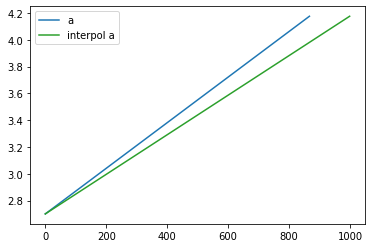

In [38]:
i=0
a = np.array(cell[0][features_columns])
interpol_a = bye_cycle.interpol_cycle(cell[0], columns=features_columns, n_points=1000, interpol_kind='cubic')
plt.plot(a[:,1], color='C0', label='a')
plt.plot(interpol_a[:,1], color='C2', label='interpol a')
plt.legend()

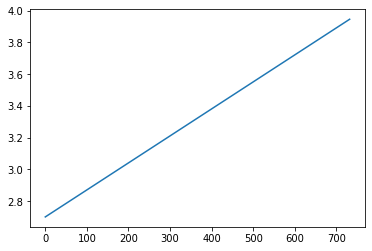

In [26]:
plt.plot(a[:,1])

In [481]:
len(X_train[0])

100

In [17]:
ragged_list = []
for x in tqdm(X_train):
    ragged_list.append(tf.ragged.constant(X_train[i]))
#     print(len(X_train[50][i]))

 70%|██████▉   | 11278/16165 [16:16<07:03, 11.55it/s]


KeyboardInterrupt: 

In [15]:
ragged_list[0].shape

TensorShape([20, None, None])

In [17]:
ac = tf.ragged.stack([tf.ragged.constant(x) for x in X_train[0:5]], axis=0)

In [21]:
tf.ragged.constant(X_train[0])

TensorShape([20, None, None])

In [32]:
dataset = dataset.map(lambda x,y: tf.RaggedTensor.from_tensor(x_train), y)
                                                            

NameError: name 'dataset' is not defined

In [ ]:
dataset = tf.data.Dataset.from_tensor_slices(train_data).map(lambda x,y: tf.RaggedTensor.from_tensor(x), y)

In [14]:
train_data[0]

([[array([[ 0.   ,  2.701, -0.691],
          [ 0.   ,  2.703, -0.692],
          [ 0.   ,  2.704, -0.692],
          ...,
          [ 0.   ,  4.174, -0.691],
          [ 0.   ,  4.176, -0.694],
          [ 0.   ,  4.178, -0.698]]),
   array([[ 6.   ,  2.701, -0.968],
          [ 6.   ,  2.703, -0.968],
          [ 6.   ,  2.704, -0.968],
          ...,
          [ 6.   ,  4.137, -0.968],
          [ 6.   ,  4.139, -0.97 ],
          [ 6.   ,  4.14 , -0.972]]),
   array([[ 7.   ,  2.701, -0.968],
          [ 7.   ,  2.703, -0.968],
          [ 7.   ,  2.704, -0.968],
          ...,
          [ 7.   ,  4.137, -0.968],
          [ 7.   ,  4.139, -0.97 ],
          [ 7.   ,  4.14 , -0.972]]),
   array([[ 8.   ,  2.701, -0.968],
          [ 8.   ,  2.703, -0.968],
          [ 8.   ,  2.704, -0.968],
          ...,
          [ 8.   ,  4.139, -0.97 ],
          [ 8.   ,  4.14 , -0.972],
          [ 8.   ,  4.142, -0.973]]),
   array([[ 9.   ,  2.701, -0.968],
          [ 9.   ,  2.703, -0.96

In [55]:
r_train_x = tf.ragged.constant(X_train[0])

In [57]:
r_train_x.shape

TensorShape([20, None, None])

In [301]:
X_train[0].shape

(20, 3)

In [302]:
X_train

[array([[ 0.   ,  2.702, -0.692],
        [ 0.   ,  2.703, -0.692],
        [ 0.   ,  2.705, -0.692],
        [ 0.   ,  2.706, -0.692],
        [ 0.   ,  2.708, -0.692],
        [ 0.   ,  2.709, -0.691],
        [ 0.   ,  2.711, -0.692],
        [ 0.   ,  2.712, -0.692],
        [ 0.   ,  2.714, -0.691],
        [ 0.   ,  2.715, -0.692],
        [ 0.   ,  2.717, -0.692],
        [ 0.   ,  2.718, -0.692],
        [ 0.   ,  2.72 , -0.692],
        [ 0.   ,  2.721, -0.692],
        [ 0.   ,  2.723, -0.692],
        [ 0.   ,  2.724, -0.692],
        [ 0.   ,  2.726, -0.692],
        [ 0.   ,  2.727, -0.692],
        [ 0.   ,  2.729, -0.692],
        [ 0.   ,  2.73 , -0.691]]),
 array([[ 0.   ,  2.732, -0.691],
        [ 0.   ,  2.733, -0.691],
        [ 0.   ,  2.735, -0.691],
        [ 0.   ,  2.736, -0.692],
        [ 0.   ,  2.738, -0.692],
        [ 0.   ,  2.739, -0.691],
        [ 0.   ,  2.741, -0.692],
        [ 0.   ,  2.742, -0.692],
        [ 0.   ,  2.744, -0.691],
        [ 0.

In [290]:
# flat_list = [x for xs[0] in train_data for x in xs]


In [292]:
len(tes_y)

6901

In [280]:
len(tes_X)

212

In [246]:
r_train_x.shape

TensorShape([26, None, None])

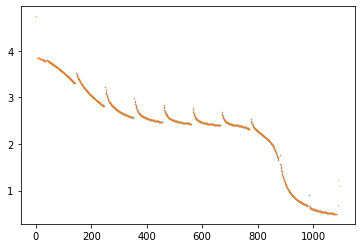

In [65]:
for cycles in cell_labels[0]:
#     print(c)
    plt.scatter(cycles['cycle_index'], cycles['discharge_capacity'], color='C0', s=0.1)
#     print(c)
#     print(c['cycle_index'])
#     break
plt.scatter(cell_1.structured_summary['cycle_index'], cell_1.structured_summary['discharge_capacity'], s=0.1, color='C1')

In [241]:
train_data[0][0][0].shape

(20, 3)

In [210]:
flat_train

[-0.0028216217699999825,
 -0.0027839635299999888,
 -0.00220835934000001,
 -0.0018347065800000007,
 -0.002192231059999994,
 -0.0019204339299999872,
 -0.0030049884899999934,
 -0.002297327010000005,
 -0.002141450750000029,
 -0.001709654950000017,
 -0.0017677507000000148,
 -0.003334083370000007,
 -0.00235809268999998,
 -0.0021992025299999883,
 -0.001551482660000003,
 -0.001944879009999978,
 -0.002696847170000005,
 -0.0017432783999999923,
 -0.0017959198699999846,
 -0.0017220069399999983,
 -0.00213309262000001,
 -0.00521819079000001,
 -0.005256060949999997,
 -0.006072860620000009,
 -0.007018651540000009,
 -0.013547472910000025,
 -0.0026802391199999944,
 -0.003742710820000017,
 -0.003683563869999995,
 -0.0036395122800000125,
 -0.005315431260000026,
 -0.005038073099999973,
 -0.005996739660000028,
 -0.004706518719999986,
 -0.00421581337000001,
 -0.004115868369999998,
 -0.003812030470000005,
 -0.00729826333000001,
 -0.004689117840000012,
 -0.004395981030000007,
 -0.004526403320000006,
 -0.004236

In [188]:
len(cell_labels[0][0])

2

In [184]:
discharge_cap_cycle_window

,cycle_index,discharge_capacity
400,425,0.156420
401,426,0.156104
402,427,0.156171
403,428,0.155647
404,429,0.154739
405,430,0.154504
406,431,0.153200
407,432,0.152232
408,433,0.151734
409,434,0.151297


In [21]:
structured_data_list[0]

[      voltage   current  cycle_index  discharge_capacity  charge_capacity
 118  2.700801 -0.692075            0            4.743129         3.847404
 119  2.702502 -0.691463            0            4.742295         3.847404
 120  2.704204 -0.691348            0            4.741422         3.847404
 121  2.705906 -0.692106            0            4.740579         3.847404
 122  2.707608 -0.691691            0            4.739734         3.847404
 ..        ...       ...          ...                 ...              ...
 981  4.169369 -0.691708            0            0.000355         3.847404
 982  4.171071 -0.691713            0            0.000127         3.847404
 983  4.172773 -0.691269            0            0.000041         3.847404
 984  4.174474 -0.693504            0            0.000024         3.847404
 985  4.176176 -0.696056            0            0.000012         3.847404
 
 [868 rows x 5 columns],
        voltage   current  cycle_index  discharge_capacity  charge_capaci

In [141]:
mid_window_index = len(cycle_window_labels[1])//2
print(mid_window)
low = np.array(cycle_window_labels[0])[0]
mid = np.array(cycle_window_labels[0])[mid_window_index]


10


In [148]:
cell_labels[0]

[    cycle_index  discharge_capacity
 20           25            3.809959
 21           26            3.807600
 22           27            3.804501
 23           28            3.801214
 24           29            3.798881
 25           30            3.794310
 26           31            3.791211
 27           32            3.789114
 28           33            3.786210
 29           34            3.781344
 30           35            3.780261
 31           41            3.800649
 32           42            3.793537
 33           43            3.788503
 34           44            3.783945
 35           45            3.779441
 36           46            3.774118
 37           47            3.769795
 38           48            3.764975
 39           49            3.760485,
     cycle_index  discharge_capacity
 40           50            3.756755
 41           51            3.752721
 42           52            3.748500
 43           53            3.744379
 44           54            3.740676


In [145]:
cell_labels

[[    cycle_index  discharge_capacity
  20           25            3.809959
  21           26            3.807600
  22           27            3.804501
  23           28            3.801214
  24           29            3.798881
  25           30            3.794310
  26           31            3.791211
  27           32            3.789114
  28           33            3.786210
  29           34            3.781344
  30           35            3.780261
  31           41            3.800649
  32           42            3.793537
  33           43            3.788503
  34           44            3.783945
  35           45            3.779441
  36           46            3.774118
  37           47            3.769795
  38           48            3.764975
  39           49            3.760485,
      cycle_index  discharge_capacity
  40           50            3.756755
  41           51            3.752721
  42           52            3.748500
  43           53            3.744379
  44       

In [156]:
len(cell_labels[0])

50

In [167]:
cell

[      voltage   current  cycle_index  discharge_capacity  charge_capacity
 118  2.700801 -0.691463            0            4.756813         3.857488
 119  2.702502 -0.691911            0            4.755975         3.857488
 120  2.704204 -0.691374            0            4.755099         3.857488
 121  2.705906 -0.691747            0            4.754218         3.857488
 122  2.707608 -0.691463            0            4.753360         3.857488
 ..        ...       ...          ...                 ...              ...
 981  4.169369 -0.691463            0            0.000463         3.857488
 982  4.171071 -0.691463            0            0.000184         3.857488
 983  4.172773 -0.691623            0            0.000051         3.857488
 984  4.174474 -0.693506            0            0.000025         3.857488
 985  4.176176 -0.695775            0            0.000012         3.857488
 
 [868 rows x 5 columns],
        voltage    current  cycle_index  discharge_capacity  charge_capac

In [165]:
cycle_window_labels

[    cycle_index  discharge_capacity
 20           25            4.398051
 21           26            4.395067
 22           27            4.391276
 23           28            4.383451
 24           29            4.378369
 25           30            4.373650
 26           31            4.367600
 27           32            4.361429
 28           33            4.356791
 29           34            4.353766
 30           35            4.345255
 31           41            4.333276
 32           42            4.315368
 33           43            4.313190
 34           44            4.307826
 35           45            4.302865
 36           46            4.297017
 37           47            4.292540
 38           48            4.288345
 39           49            4.284191,
     cycle_index  discharge_capacity
 40           50            4.278101
 41           51            4.276286
 42           52            4.268017
 43           53            4.265678
 44           54            4.260596


In [144]:
for i in range(len(cycle_window_labels)):
    print(find_slope(cycle_window_labels[i]))

(-0.0057076483299999484, -0.002683982064285725)
(-0.006961283289999986, -0.007294125555555592)
(-0.007940705100000046, -0.008693021755555542)
(-0.009080091300000027, -0.009589287600000032)
(-0.009597658440000023, -0.009708067077777778)
(-0.009927670649999998, 0.010002813928571433)
(-0.016075614869999998, -0.014081120777777765)
(-0.013681280169999966, -0.013258792933333355)
(-0.010944098959999992, -0.009315201233333317)
(-0.008313078060000034, -0.006055044455555553)
(-0.005558454579999994, 0.013609178892857145)
(-0.01025777174, -0.006016181911111109)
(-0.0041528498099999926, -0.003213118022222251)
(-0.0020569396800000027, -0.0013951928333332869)
(-0.001014358169999996, -0.0010135090333333412)
(-0.0005384133200000196, 0.013742624900000016)
(-0.004995112599999985, -0.0019837232888888995)
(-0.00018890318999997824, 0.00027861758888889397)
(0.00016535871000002977, -0.00011874527777777644)
(-0.0011306517500000001, -0.0042818926333333274)
(-0.010583124420000001, -0.011334728578571429)
(-0.0443

In [116]:
np.array(cycle_window_labels[0])

array([[25.   ,  4.432],
       [26.   ,  4.426],
       [27.   ,  4.422],
       [28.   ,  4.416],
       [29.   ,  4.411],
       [30.   ,  4.405],
       [31.   ,  4.398],
       [32.   ,  4.393],
       [33.   ,  4.387],
       [34.   ,  4.381],
       [35.   ,  4.375],
       [41.   ,  4.392],
       [42.   ,  4.384],
       [43.   ,  4.378],
       [44.   ,  4.37 ],
       [45.   ,  4.363],
       [46.   ,  4.356],
       [47.   ,  4.35 ],
       [48.   ,  4.343],
       [49.   ,  4.337]])

In [105]:
cell_labels

[[    discharge_capacity  cycle_index
  20            3.809959           25
  21            3.807600           26
  22            3.804501           27
  23            3.801214           28
  24            3.798881           29
  25            3.794310           30
  26            3.791211           31
  27            3.789114           32
  28            3.786210           33
  29            3.781344           34
  30            3.780261           35
  31            3.800649           41
  32            3.793537           42
  33            3.788503           43
  34            3.783945           44
  35            3.779441           45
  36            3.774118           46
  37            3.769795           47
  38            3.764975           48
  39            3.760485           49,
      discharge_capacity  cycle_index
  40            3.756755           50
  41            3.752721           51
  42            3.748500           52
  43            3.744379           53
  44       

In [101]:
cycle_window_labels[-1]

,discharge_capacity,cycle_index
1040,2.161563,1100
1041,2.159156,1101
1042,2.152206,1102
1043,2.148697,1103
1044,2.144045,1104
1045,2.141665,1105
1046,2.140066,1106
1047,2.135535,1107
1048,2.129929,1108
1049,2.127025,1109


In [82]:
len(cycle_window_labels[0])

1071

In [48]:
cycle_features[-1]

array([[ 2.701e+00, -6.627e-01,  8.250e+02],
       [ 2.703e+00, -1.504e+00,  8.250e+02],
       [ 2.704e+00, -2.345e+00,  8.250e+02],
       ...,
       [ 4.248e+00,  2.420e+00,  8.250e+02],
       [ 4.249e+00,  2.420e+00,  8.250e+02],
       [ 4.249e+00,  2.420e+00,  8.250e+02]])

In [20]:
# data_prep
def prep_ml_data(dat, cycle_numbers=20):
    features = np.empty([0, cycle_numbers,100, 3])
    labels = np.empty([0, cycle_numbers])
    print('Generating features and labels. Skipping cells with cycles lower than 50.')
    for j,d in enumerate(tqdm(dat)):
        if not len(d) < 50:
            n = d.shape[0]//cycle_numbers
            cell_features = []
            cell_labels = []
            for i in range(n-1):
                cell_features.append(d[cycle_numbers*i:cycle_numbers*(i+1), :, :3])
                cell_labels.append(d[cycle_numbers*(i+1):cycle_numbers*(i+2), 0, -1])
#             print(np.array(cell_features).shape, j)
            features = np.append(features, np.array(cell_features), axis=0)
            labels = np.append(labels, np.array(cell_labels), axis=0)
        else:
            print(f'Cell {j} has only {len(d)} cycles. Skipping!')
    return features, labels

21

In [10]:
cell.structured_summary

,cycle_index,discharge_capacity,charge_capacity,discharge_energy,charge_energy,dc_internal_resistance,temperature_maximum,temperature_average,temperature_minimum,date_time_iso,energy_efficiency,charge_throughput,energy_throughput,charge_duration,time_temperature_integrated,paused,CV_time,CV_current
0,0,4.750399,3.870380,17.390939,15.072334,0.0,NaN,NaN,NaN,2020-12-19T20:19:16+00:00,1.153832,3.870380,15.072334,NaN,NaN,0,2062.030029,0.138247
1,6,3.508421,3.829267,12.907875,14.385632,0.0,NaN,NaN,NaN,2020-12-23T06:59:08+00:00,0.897276,7.699647,29.457966,NaN,NaN,0,1799.969971,0.224308
2,7,3.498147,3.513221,12.869881,13.314831,0.0,NaN,NaN,NaN,2020-12-23T15:10:20+00:00,0.966582,11.212869,42.772797,NaN,NaN,0,1799.979980,0.221103
3,8,3.489705,3.504323,12.839340,13.281834,0.0,NaN,NaN,NaN,2020-12-23T23:01:18+00:00,0.966684,14.717191,56.054630,NaN,NaN,0,1799.979980,0.222019
4,9,3.481804,3.496785,12.810638,13.254452,0.0,NaN,NaN,NaN,2020-12-24T06:51:14+00:00,0.966516,18.213976,69.309082,NaN,NaN,0,1799.989990,0.221332
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1240,1310,3.018786,3.029007,11.107913,11.533662,0.0,NaN,NaN,NaN,2022-03-13T21:08:59+00:00,0.963086,3917.212891,14888.087891,NaN,NaN,0,1799.989990,0.189975
1241,1311,3.016508,3.025954,11.100614,11.522671,0.0,NaN,NaN,NaN,2022-03-14T04:01:08+00:00,0.963372,3920.238770,14899.610352,NaN,NaN,0,1799.989990,0.189059
1242,1312,3.013734,3.023249,11.091372,11.512824,0.0,NaN,NaN,NaN,2022-03-14T10:52:57+00:00,0.963393,3923.261963,14911.123047,NaN,NaN,0,1799.989990,0.192950
1243,1313,3.011360,3.020964,11.083298,11.504633,0.0,NaN,NaN,NaN,2022-03-14T17:44:25+00:00,0.963377,3926.282959,14922.627930,NaN,NaN,0,1799.989990,0.188830


In [12]:
structured_data_list[0][-1]

,voltage,current,cycle_index,discharge_capacity,charge_capacity
1244412,3.201101,-0.967737,1314,3.007392,3.018276
1244413,3.202803,-0.967540,1314,3.005107,3.018276
1244414,3.204504,-0.967693,1314,3.002765,3.018276
1244415,3.206206,-0.967845,1314,3.000423,3.018276
1244416,3.207908,-0.967956,1314,2.998101,3.018276
...,...,...,...,...,...
1244919,4.063864,-0.967852,1314,0.001188,3.018276
1244920,4.065566,-0.967927,1314,0.000507,3.018276
1244921,4.067267,-0.969217,1314,0.000195,3.018276
1244922,4.068969,-0.971274,1314,0.000116,3.018276


In [13]:
summary_data_list[0]

,cycle_index,discharge_capacity,charge_capacity,discharge_energy,charge_energy,charge_throughput,energy_throughput
0,0,4.750399,3.870380,17.390939,15.072334,3.870380,15.072334
1,6,3.508421,3.829267,12.907875,14.385632,7.699647,29.457966
2,7,3.498147,3.513221,12.869881,13.314831,11.212869,42.772797
3,8,3.489705,3.504323,12.839340,13.281834,14.717191,56.054630
4,9,3.481804,3.496785,12.810638,13.254452,18.213976,69.309082
...,...,...,...,...,...,...,...
1240,1310,3.018786,3.029007,11.107913,11.533662,3917.212891,14888.087891
1241,1311,3.016508,3.025954,11.100614,11.522671,3920.238770,14899.610352
1242,1312,3.013734,3.023249,11.091372,11.512824,3923.261963,14911.123047
1243,1313,3.011360,3.020964,11.083298,11.504633,3926.282959,14922.627930


In [30]:

for i in range(len(summary_data_list)):
    n_structured_data = np.array(structured_data_list[i][-1]['cycle_index'])[-1]
    n_summary_data = np.array(summary_data_list[i]['cycle_index'])[-1]
    if n_structured_data != n_summary_data:
        print(i, n_structured_data, n_summary_data)

4 1732 1731
7 2307 2306
10 2839 2838
12 707 706
14 2255 2254
15 1477 1476
16 1766 1765
18 944 943
21 1478 1477
23 1876 1875
25 574 573
32 1469 1468
33 90 89
36 79 78
38 1645 1644
40 1494 1493
46 1558 1557
47 1044 1043
48 1832 1831
50 3933 3932
51 81 80
54 2323 2322
58 1680 1679
59 2764 2763
61 3876 3875
66 901 900
67 1563 1562
68 4246 4245
69 1642 1641
72 1466 1465
76 3545 3544
83 1527 1526
85 1320 1319
89 4044 4043
91 1190 1189
93 964 963
94 761 760
97 1505 1504
100 327 326
108 1164 1163
109 2283 2282
113 3982 3981
118 4739 4738
119 2989 2988
121 511 510
124 86 85
126 3410 3409
128 1486 1485
130 2788 2787
131 72 71
132 2824 2823
133 2418 2417
134 1654 1653
137 1071 1070
138 1429 1428
140 2467 2466
141 2268 2267
146 1710 1709
150 1323 1322
152 2177 2176
154 1494 1493
155 1610 1609
156 1468 1467
157 3829 3828
160 84 83
165 1931 1925
168 510 509
169 1591 1590
171 2591 2590
174 1244 1243
176 1808 1807
179 1950 1949
183 1569 1568
184 1931 1925
188 1562 1561
189 1505 1504
192 1244 1243
195 

In [137]:
structured_data_list = []
summary_data_list = []
for m,n in dat:
    structured_data, summary_data = m,n
    s_list = []
    for s in structured_data:
        if s.shape[0] != 0:
            s_list.append(s)
    structured_data_list.append(s_list)
    summary_data_list.append(summary_data[0].iloc[:-1])
#     summary_data = summary_data.iloc[:-1]

AttributeError: 'MaccorDatapath' object has no attribute 'summary_data'

In [58]:
structured_columns = ['voltage', 'current', 'cycle_index', 'discharge_capacity', 'charge_capacity']
summary_columns = ['cycle_index', 'discharge_capacity', 'charge_capacity', 'discharge_energy',
                   'charge_energy', 'charge_throughput', 'energy_throughput']
n = '/home/ec2-user/SageMaker/data_cache/structure/PreDiag_000272_0000C5_structured.json.gz'
structured_data = []
summary_data = []
max_cycle_idx = max(cell.structured_data['cycle_index'])
manufacturding_nominal_discharge_capacity = 4.84
nominal_discharge_capacity_drop = 1- cell.structured_summary['discharge_capacity'][1]/manufacturding_nominal_discharge_capacity
# excluding cells that that have more that 80% drop in discharge capacity within 1st cycle
# excluding cells that that have less than 50 cycles
cycle_idx_threshold = 50
nominal_discharge_capacity_drop_threshold = 0.8
if nominal_discharge_capacity_drop < nominal_discharge_capacity_drop_threshold and not max_cycle_idx < cycle_idx_threshold:
    print(f'Pre-processing data for cell {n[46:-8]}.')
#     for j in tqdm(range(max_cycle_idx)):
    for c in tqdm(cell.structured_summary['cycle_index']):
        clean_cell = bye_cycle.clean_cycle_data(cell, j, columns=structured_columns)
        structured_data.append(clean_cell)
    summary_data.append(cell.structured_summary[summary_columns])

Pre-processing data for cell PreDiag_000272_0000C5_structured.


In [70]:
cycle_number = 2
selected_cell_data = cell.structured_data[structured_columns].dropna()
selected_cell_data

,voltage,current,cycle_index,discharge_capacity,charge_capacity
118,2.700801,-0.692125,0,4.741166,3.852409
119,2.702502,-0.691623,0,4.740309,3.852409
120,2.704204,-0.691216,0,4.739393,3.852409
121,2.705906,-0.691276,0,4.738537,3.852409
122,2.707608,-0.691522,0,4.737663,3.852409
...,...,...,...,...,...
3286096,3.588057,2.419597,1738,0.000017,0.461665
3286097,3.589617,2.419683,1738,0.000017,0.466474
3286098,3.591153,2.419893,1738,0.000017,0.471283
3286099,3.592690,2.420102,1738,0.000017,0.476092


In [69]:
clean_cell_data_cycle_number = selected_cell_data.loc[(selected_cell_data['cycle_index'] == cycle_number) 
                                          & (selected_cell_data['discharge_capacity']!=0)]
clean_cell_data_cycle_number

,voltage,current,cycle_index,discharge_capacity,charge_capacity


In [60]:
summary_data[0]

,cycle_index,discharge_capacity,charge_capacity,discharge_energy,charge_energy,charge_throughput,energy_throughput
0,0,4.741486,3.852409,17.353089,15.000720,3.852409,15.000720
1,6,2.642477,4.523357,9.959919,17.299393,8.375766,32.300114
2,7,2.634625,2.651804,9.932148,10.605730,11.027570,42.905842
3,8,2.627890,2.638572,9.907780,10.554319,13.666142,53.460163
4,9,2.624367,2.630954,9.895451,10.525008,16.297096,63.985168
...,...,...,...,...,...,...,...
1638,1728,1.919406,1.921610,7.119877,7.732109,3616.476074,14500.291016
1639,1729,1.916676,1.920892,7.109297,7.728719,3618.396973,14508.019531
1640,1730,1.918061,1.920649,7.115403,7.728511,3620.317627,14515.748047
1641,1731,1.915628,1.919130,7.105213,7.722100,3622.236816,14523.470703


In [62]:
structured_data[0]

,voltage,current,cycle_index,discharge_capacity,charge_capacity


In [53]:
cell.structured_data[structured_columns].dropna()

,voltage,current,cycle_index,discharge_capacity,charge_capacity
118,2.700801,-0.692125,0,4.741166,3.852409
119,2.702502,-0.691623,0,4.740309,3.852409
120,2.704204,-0.691216,0,4.739393,3.852409
121,2.705906,-0.691276,0,4.738537,3.852409
122,2.707608,-0.691522,0,4.737663,3.852409
...,...,...,...,...,...
3286096,3.588057,2.419597,1738,0.000017,0.461665
3286097,3.589617,2.419683,1738,0.000017,0.466474
3286098,3.591153,2.419893,1738,0.000017,0.471283
3286099,3.592690,2.420102,1738,0.000017,0.476092


In [55]:
summary_data[-1]

,cycle_index,discharge_capacity,charge_capacity,discharge_energy,charge_energy,charge_throughput,energy_throughput
0,0,4.741486,3.852409,17.353089,15.000720,3.852409,15.000720
1,6,2.642477,4.523357,9.959919,17.299393,8.375766,32.300114
2,7,2.634625,2.651804,9.932148,10.605730,11.027570,42.905842
3,8,2.627890,2.638572,9.907780,10.554319,13.666142,53.460163
4,9,2.624367,2.630954,9.895451,10.525008,16.297096,63.985168
...,...,...,...,...,...,...,...
1638,1728,1.919406,1.921610,7.119877,7.732109,3616.476074,14500.291016
1639,1729,1.916676,1.920892,7.109297,7.728719,3618.396973,14508.019531
1640,1730,1.918061,1.920649,7.115403,7.728511,3620.317627,14515.748047
1641,1731,1.915628,1.919130,7.105213,7.722100,3622.236816,14523.470703


In [49]:
structured_data[-3]

,voltage,current,cycle_index,discharge_capacity,charge_capacity


In [123]:
summary_data[0].iloc[:-1]

,cycle_index,discharge_capacity,charge_capacity,discharge_energy,charge_energy,charge_throughput,energy_throughput
0,0,4.739763,3.845542,17.344500,14.976089,3.845542,14.976089
1,6,3.801423,3.780793,13.262715,14.334126,7.626336,29.310215
2,7,3.796112,3.798094,13.241635,14.414895,11.424430,43.725109
3,8,3.791151,3.794633,13.218457,14.402270,15.219062,58.127380
4,9,3.788853,3.790908,13.206060,14.389844,19.009970,72.517227
...,...,...,...,...,...,...,...
1978,2033,1.730030,1.730979,5.712026,6.869929,4956.676758,19291.085938
1979,2034,1.728551,1.730629,5.705998,6.868699,4958.407227,19297.955078
1980,2035,1.727704,1.729381,5.702184,6.864341,4960.136719,19304.818359
1981,2036,1.727099,1.727993,5.699559,6.859002,4961.864746,19311.677734


In [38]:
summary_data_list[4]

,cycle_index,discharge_capacity,charge_capacity,discharge_energy,charge_energy,charge_throughput,energy_throughput
0,0,4.741486,3.852409,17.353089,15.000720,3.852409,15.000720
1,6,2.642477,4.523357,9.959919,17.299393,8.375766,32.300114
2,7,2.634625,2.651804,9.932148,10.605730,11.027570,42.905842
3,8,2.627890,2.638572,9.907780,10.554319,13.666142,53.460163
4,9,2.624367,2.630954,9.895451,10.525008,16.297096,63.985168
...,...,...,...,...,...,...,...
1637,1727,1.922041,1.923796,7.130655,7.741613,3614.554443,14492.559570
1638,1728,1.919406,1.921610,7.119877,7.732109,3616.476074,14500.291016
1639,1729,1.916676,1.920892,7.109297,7.728719,3618.396973,14508.019531
1640,1730,1.918061,1.920649,7.115403,7.728511,3620.317627,14515.748047


In [40]:
structured_data_list[4][-1]

,voltage,current,cycle_index,discharge_capacity,charge_capacity
1642118,2.700801,-0.691463,1732,4.077430,3.616768
1642119,2.702502,-0.691681,1732,4.076982,3.616768
1642120,2.704204,-0.691593,1732,4.076527,3.616768
1642121,2.705906,-0.691656,1732,4.076084,3.616768
1642122,2.707608,-0.691632,1732,4.075636,3.616768
...,...,...,...,...,...
1642983,4.172773,-0.693400,1732,0.000024,3.616768
1642984,4.174474,-0.694370,1732,0.000018,3.616768
1642985,4.176176,-0.695341,1732,0.000012,3.616768
1642986,4.177878,-0.696311,1732,0.000007,3.616768


,cycle_index,discharge_capacity,charge_capacity,discharge_energy,charge_energy,charge_throughput,energy_throughput
0,0,4.739763,3.845542,17.344500,14.976089,3.845542,14.976089
1,6,3.801423,3.780793,13.262715,14.334126,7.626336,29.310215
2,7,3.796112,3.798094,13.241635,14.414895,11.424430,43.725109
3,8,3.791151,3.794633,13.218457,14.402270,15.219062,58.127380
4,9,3.788853,3.790908,13.206060,14.389844,19.009970,72.517227
...,...,...,...,...,...,...,...
1978,2033,1.730030,1.730979,5.712026,6.869929,4956.676758,19291.085938
1979,2034,1.728551,1.730629,5.705998,6.868699,4958.407227,19297.955078
1980,2035,1.727704,1.729381,5.702184,6.864341,4960.136719,19304.818359
1981,2036,1.727099,1.727993,5.699559,6.859002,4961.864746,19311.677734


In [96]:
new_structured_data[-1]

,voltage,current,cycle_index,discharge_capacity,charge_capacity
1982118,2.700801,-0.691584,2037,2.961932,2.082554
1982119,2.702502,-0.691751,2037,2.961543,2.082554
1982120,2.704204,-0.691762,2037,2.961133,2.082554
1982121,2.705906,-0.691809,2037,2.960702,2.082554
1982122,2.707608,-0.691681,2037,2.960321,2.082554
...,...,...,...,...,...
1982979,4.165966,-0.692822,2037,0.000025,2.082554
1982980,4.167668,-0.693266,2037,0.000020,2.082554
1982981,4.169369,-0.693710,2037,0.000015,2.082554
1982982,4.171071,-0.694154,2037,0.000010,2.082554


In [88]:
new_structured_data[-1]

,voltage,current,cycle_index,discharge_capacity,charge_capacity
1982118,2.700801,-0.691584,2037,2.961932,2.082554
1982119,2.702502,-0.691751,2037,2.961543,2.082554
1982120,2.704204,-0.691762,2037,2.961133,2.082554
1982121,2.705906,-0.691809,2037,2.960702,2.082554
1982122,2.707608,-0.691681,2037,2.960321,2.082554
...,...,...,...,...,...
1982978,4.164264,-0.692378,2037,0.000030,2.082554
1982979,4.165966,-0.692822,2037,0.000025,2.082554
1982980,4.167668,-0.693266,2037,0.000020,2.082554
1982981,4.169369,-0.693710,2037,0.000015,2.082554


In [91]:
len(structured_data)

2043

In [97]:
new_structured_data = []
for i,s in enumerate(structured_data):
    if s.shape[0] != 0:
        new_structured_data.append(s)
        summary_data[i].iloc[:-1]
#     print(s.shape)
new_structured_data[-1]

,voltage,current,cycle_index,discharge_capacity,charge_capacity
1982118,2.700801,-0.691584,2037,2.961932,2.082554
1982119,2.702502,-0.691751,2037,2.961543,2.082554
1982120,2.704204,-0.691762,2037,2.961133,2.082554
1982121,2.705906,-0.691809,2037,2.960702,2.082554
1982122,2.707608,-0.691681,2037,2.960321,2.082554
...,...,...,...,...,...
1982979,4.165966,-0.692822,2037,0.000025,2.082554
1982980,4.167668,-0.693266,2037,0.000020,2.082554
1982981,4.169369,-0.693710,2037,0.000015,2.082554
1982982,4.171071,-0.694154,2037,0.000010,2.082554


In [22]:
for i,m in enumerate(dat[1][0]):
#     if m.shape
    if len(m) != 0:
        print(m.shape)
#         break

AttributeError: 'str' object has no attribute 'shape'

In [4]:
import random
random.seed(0)
indices = list(range(len(dat)))
random.shuffle(indices)
train_size = 0.9
val_size = 0.09
N_train = int(train_size *len(dat))
N_val = int(val_size *len(dat))
train_dat = dat[:N_train]
# train_indices = random.sample(range(len(dat)), N_train)
test_dat = dat[N_train:]
val_dat = test_dat[:N_val]
test_dat = test_dat[N_val:]

# val_indices = random.sample(list(range(len(dat))).pop(train_indices), N_val)
# N_test = len(dat) - N_train - N_val

In [20]:
add_txt = 'hi There'
with open('CACHED_DATA/pre_processed_pandas/notes.txt', 'r+') as f:
    for line in f:
#         loglist = f.readlines()
#         print(line)
#         print(loglist)
        if add_txt not in line : 
            f.write(add_txt)

In [6]:
# data_prep
def prep_ml_data(dat, cycle_numbers=20):
    features = np.empty([0, cycle_numbers,100, 3])
    labels = np.empty([0, cycle_numbers])
    print('Generating features and labels. Skipping cells with cycles lower than 50.')
    for j,d in enumerate(tqdm(dat)):
        if not len(d) < 50:
            n = d.shape[0]//cycle_numbers
            cell_features = []
            cell_labels = []
            for i in range(n-1):
                cell_features.append(d[cycle_numbers*i:cycle_numbers*(i+1), :, :3])
                cell_labels.append(d[cycle_numbers*(i+1):cycle_numbers*(i+2), 0, -1])
#             print(np.array(cell_features).shape, j)
            features = np.append(features, np.array(cell_features), axis=0)
            labels = np.append(labels, np.array(cell_labels), axis=0)
        else:
            print(f'Cell {j} has only {len(d)} cycles. Skipping!')
    return features, labels

In [7]:
train_features, train_labels = prep_ml_data(train_dat)

Generating features and labels. Skipping cells with cycles lower than 50.


  5%|▍         | 16/339 [00:00<00:02, 159.16it/s]

Cell 8 has only 2 cycles. Skipping!


 12%|█▏        | 42/339 [00:00<00:07, 40.92it/s] 

Cell 41 has only 2 cycles. Skipping!


 39%|███▉      | 133/339 [00:11<00:28,  7.29it/s]

Cell 131 has only 48 cycles. Skipping!


 56%|█████▋    | 191/339 [00:24<00:39,  3.77it/s]

Cell 191 has only 2 cycles. Skipping!


100%|██████████| 339/339 [01:19<00:00,  4.29it/s]


In [25]:
dat[0].shape

(1431, 100, 4)

In [22]:
from beep.structure.cli import auto_load_processed
cell = auto_load_processed('/home/ec2-user/SageMaker/data_cache/structure/PreDiag_000206_000057_structured.json.gz')

In [23]:
cell.structured_summary

,cycle_index,discharge_capacity,charge_capacity,discharge_energy,charge_energy,dc_internal_resistance,temperature_maximum,temperature_average,temperature_minimum,date_time_iso,energy_efficiency,charge_throughput,energy_throughput,charge_duration,time_temperature_integrated,paused,CV_time,CV_current
0,0,4.773268,3.870386,17.471176,15.071790,0.0,NaN,NaN,NaN,2019-12-14T00:58:35+00:00,1.159197,3.870386,15.071790,NaN,NaN,62318,2084.219971,0.138476
1,6,0.000163,1.751873,0.000559,6.227764,0.0,NaN,NaN,NaN,2019-12-17T13:54:56+00:00,0.000090,5.622260,21.299555,NaN,NaN,0,1799.969971,0.124514
2,7,0.000122,0.034658,0.000421,0.128238,0.0,NaN,NaN,NaN,2019-12-17T16:21:32+00:00,0.003282,5.656918,21.427792,NaN,NaN,0,1799.979980,0.028153
3,8,0.000163,0.011033,0.000560,0.040823,0.0,NaN,NaN,NaN,2019-12-17T17:11:33+00:00,0.013708,5.667951,21.468615,NaN,NaN,0,1799.979980,0.011215
4,9,0.000163,0.005046,0.000559,0.018673,0.0,NaN,NaN,NaN,2019-12-17T18:01:34+00:00,0.029962,5.672997,21.487288,NaN,NaN,0,1799.969971,0.007324
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4437,4667,0.000163,0.001382,0.000558,0.005115,0.0,NaN,NaN,NaN,2020-09-02T13:28:15+00:00,0.109117,80.722565,288.610504,NaN,NaN,0,659.969971,0.001602
4438,4668,0.000163,0.001001,0.000558,0.003704,0.0,NaN,NaN,NaN,2020-09-02T14:18:16+00:00,0.150690,80.723572,288.614197,NaN,NaN,0,810.000000,0.001831
4439,4669,0.000122,0.000846,0.000420,0.003132,0.0,NaN,NaN,NaN,2020-09-02T15:08:17+00:00,0.134067,80.724411,288.617340,NaN,NaN,0,1499.969971,0.002289
4440,4670,0.000122,0.000738,0.000420,0.002732,0.0,NaN,NaN,NaN,2020-09-02T15:58:18+00:00,0.153696,80.725151,288.620056,NaN,NaN,0,1560.000000,0.000458


In [14]:
add_txt = 'PreDiag_000255_000214_structured'
with open('CACHED_DATA/pre_processed_pandas/notes.txt', 'r+') as f:
    if add_txt in f.read():
        print('line_exists')
    else:
        print('Run')

line_exists


In [10]:
structure_path = '/home/ec2-user/SageMaker/data_cache/structure/'
#Get all structured files with the correct prefix
names = [os.path.join(structure_path, n) for n in os.listdir(structure_path) if "PreDiag" in n or "PredictionDiagnostics" in n]
#exclude stitched files
names = [n for n in names if (not "p2_structure" in n and ".gz" in n)]
from beep.structure.cli import auto_load_processed
cell = auto_load_processed(names[275])
clean_cell = bye_cycle.clean_cycle_data(cell, 0)

NameError: name 'os' is not defined

In [41]:
cell.raw_data.head(10)

,data_point,cycle_index,step_index,test_time,step_time,_capacity,_energy,current,voltage,_state,...,_var13,_var14,_var15,charge_capacity,discharge_capacity,charge_energy,discharge_energy,date_time_iso,temperature,time_since_cycle_start
0,1,0,1,0.0,0.0,0.0,0.0,0.0,4.146105,R,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2020-12-19T20:18:43+00:00,NaN,0.00
1,2,0,1,30.0,30.0,0.0,0.0,0.0,4.146182,R,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2020-12-19T20:19:16+00:00,NaN,0.55
2,3,0,1,60.0,60.0,0.0,0.0,0.0,4.145953,R,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2020-12-19T20:19:43+00:00,NaN,1.00
3,4,0,1,90.0,90.0,0.0,0.0,0.0,4.145800,R,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2020-12-19T20:20:13+00:00,NaN,1.50
4,5,0,1,120.0,120.0,0.0,0.0,0.0,4.145800,R,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2020-12-19T20:20:43+00:00,NaN,2.00
5,6,0,1,150.0,150.0,0.0,0.0,0.0,4.145724,R,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2020-12-19T20:21:13+00:00,NaN,2.50
6,7,0,1,180.0,180.0,0.0,0.0,0.0,4.145800,R,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2020-12-19T20:21:43+00:00,NaN,3.00
7,8,0,1,210.0,210.0,0.0,0.0,0.0,4.145648,R,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2020-12-19T20:22:13+00:00,NaN,3.50
8,9,0,1,240.0,240.0,0.0,0.0,0.0,4.145648,R,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2020-12-19T20:22:43+00:00,NaN,4.00
9,10,0,1,270.0,270.0,0.0,0.0,0.0,4.145724,R,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2020-12-19T20:23:13+00:00,NaN,4.50


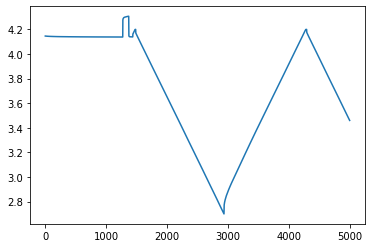

In [53]:
plt.plot(cell.raw_data.head(5000)['voltage'])

In [62]:
cell.structured_data['cycle_index']


0             0
1             0
2             0
3             0
4             0
           ... 
2863995    1513
2863996    1513
2863997    1513
2863998    1513
2863999    1513
Name: cycle_index, Length: 2864000, dtype: int32

In [67]:
cycle_index = []
time_c =[]
for i,c in enumerate(cell.structured_data['cycle_index']):
    if c not in cycle_index:
        cycle_index.append(c)
        time_c.append(i)
    

In [77]:
time_c

[0,
 1000,
 2000,
 3000,
 4000,
 5000,
 6000,
 7000,
 8000,
 9000,
 10000,
 11000,
 12000,
 13000,
 14000,
 15000,
 16000,
 17000,
 18000,
 19000,
 20000,
 21000,
 22000,
 23000,
 24000,
 25000,
 26000,
 27000,
 28000,
 29000,
 30000,
 31000,
 32000,
 33000,
 34000,
 35000,
 36000,
 37000,
 38000,
 39000,
 40000,
 41000,
 42000,
 43000,
 44000,
 45000,
 46000,
 47000,
 48000,
 49000,
 50000,
 51000,
 52000,
 53000,
 54000,
 55000,
 56000,
 57000,
 58000,
 59000,
 60000,
 61000,
 62000,
 63000,
 64000,
 65000,
 66000,
 67000,
 68000,
 69000,
 70000,
 71000,
 72000,
 73000,
 74000,
 75000,
 76000,
 77000,
 78000,
 79000,
 80000,
 81000,
 82000,
 83000,
 84000,
 85000,
 86000,
 87000,
 88000,
 89000,
 90000,
 91000,
 92000,
 93000,
 94000,
 95000,
 96000,
 97000,
 98000,
 99000,
 100000,
 101000,
 102000,
 103000,
 104000,
 105000,
 106000,
 107000,
 108000,
 109000,
 110000,
 111000,
 112000,
 113000,
 114000,
 115000,
 116000,
 117000,
 118000,
 119000,
 120000,
 121000,
 122000,
 12300

Text(0.5, 0, 'Time')

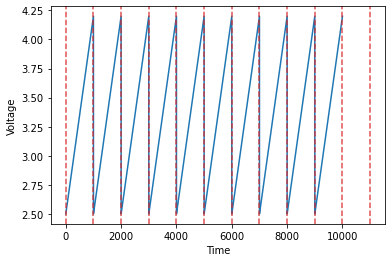

In [83]:
plt.plot(cell.structured_data.head(10000)['voltage'])
for t in time_c:
    plt.axvline(t, linestyle='--',color='C3', alpha=0.8)
    if t > 10000:
        break
plt.ylabel('Voltage')
plt.xlabel('Time')

In [87]:
cell.structured_data.iloc[-2000:]['voltage'].dropna()

2862001    3.465450
2862002    3.479265
2862003    3.489516
2862004    3.498118
2862005    3.505805
             ...   
2863073    3.782738
2863074    3.785545
2863075    3.788277
2863076    3.791022
2863077    3.793859
Name: voltage, Length: 353, dtype: float32

(1500000.0, 1510000.0)

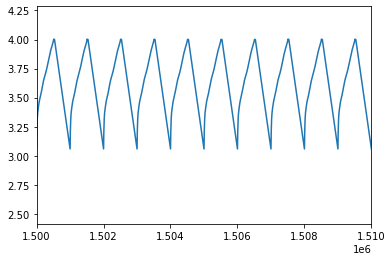

In [98]:
plt.plot(cell.structured_data['voltage'].dropna())
plt.xlim([1.5e6,1.51e6])

Text(0.5, 0, 'Time')

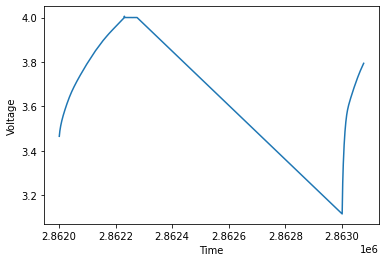

In [88]:
plt.plot(cell.structured_data.iloc[-2000:]['voltage'].dropna())
# for t in time_c:
#     if t > t[-2000]:
#         plt.axvline(t, linestyle='--',color='C3', alpha=0.8)
#         break
plt.ylabel('Voltage')
plt.xlabel('Time')

In [109]:
cell

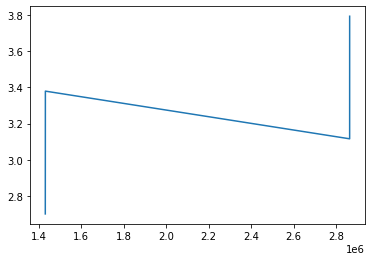

In [113]:
max_cycle_index = max(cell.structured_data['cycle_index'])
clean_cell = bye_cycle.clean_cycle_data(cell, max_cycle_index)
plt.plot(clean_cell['voltage'])

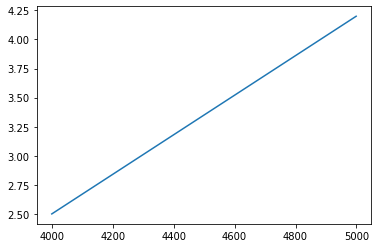

In [64]:
plt.plot(cell.structured_data.iloc[4000:5000]['voltage'])

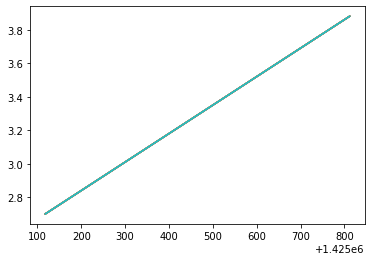

In [47]:
for i in range(10):
    clean_cell = bye_cycle.clean_cycle_data(cell, 1500)
    plt.plot(clean_cell['voltage'])

In [100]:
train_features.shape

(23103, 20, 100, 3)

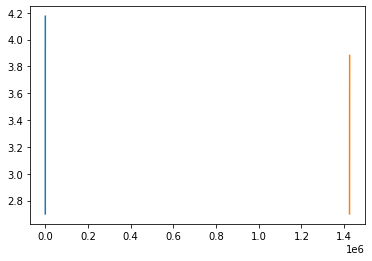

In [104]:
d = train_features[0]
plt.plot(d[0,:,0], label='interpol')
plt.plot(clean_cell['voltage'], label='raw dat')

In [8]:
val_features, val_labels = prep_ml_data(val_dat)

Generating features and labels. Skipping cells with cycles lower than 50.


100%|██████████| 33/33 [00:00<00:00, 52.75it/s] 


In [9]:
test_features, test_labels = prep_ml_data(test_dat)

Generating features and labels. Skipping cells with cycles lower than 50.


100%|██████████| 5/5 [00:00<00:00, 139.60it/s]


In [10]:
def standardize(inputs):
    fstd = np.std(inputs, axis=0)
    fmean = np.mean(inputs, axis=0)
    std_features = (inputs - fmean) / fstd
    return std_features
std_train_features = standardize(train_features)
std_test_features = standardize(test_features)
std_val_features = standardize(val_features)

In [11]:
from dataclasses import dataclass
@dataclass
class Config:
    vocab_size: int
    example_number: int
    batch_size: int
    buffer_size: int
    rnn_units: int
    hidden_dim: int
    embedding_dim: int
    reg_strength: float
    lr: float
    drop_rate: float
        
config = Config(vocab_size=21, # include gap
                example_number=len(train_labels), 
                batch_size=512, 
                buffer_size=10000,
                rnn_units=64,
                hidden_dim=64,
                embedding_dim=32,
                reg_strength=0,
                lr=1e-3,
                drop_rate=0.1
               )

In [12]:
# [:,:,:2]
np.random.seed(0)
i = np.arange(len(train_features))
np.random.shuffle(i)
train_data = tf.data.Dataset.from_tensor_slices((std_train_features[i], train_labels[i])).batch(config.batch_size)
i = np.arange(len(val_features))
val_data = tf.data.Dataset.from_tensor_slices((std_val_features[i], val_labels[i])).batch(config.batch_size)
i = np.arange(len(test_features))
test_data = tf.data.Dataset.from_tensor_slices((std_test_features[i], test_labels[i])).batch(config.batch_size)
N = len(dat)
C = std_train_features.shape[1]
T = std_train_features.shape[2]
L = std_train_features.shape[-1]

2022-06-22 15:06:48.478875: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-22 15:06:48.480503: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-22 15:06:48.482104: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-22 15:06:48.483631: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-22 15:06:48.485203: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from S

In [13]:
std_train_features.shape

(23103, 20, 100, 3)

In [14]:
def build_model(C, T, L, cycle_numbers=20):
    inputs = tf.keras.Input(shape=(C, T, L))
    print(f'input: {inputs.shape}')
    conv_1d_layer = tf.keras.layers.Conv1D(16, 100)
    blstm_layer = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16))
    x = tf.keras.layers.TimeDistributed(conv_1d_layer, input_shape=(5, 3))(inputs)
    x = tf.keras.layers.TimeDistributed(tf.keras.layers.Flatten())(x)
#     x = tf.keras.layers.Reshape((100, 64))(x)
    print(f'output CNN 1: {x.shape}')
#     conv_1d_layer = tf.keras.layers.Conv1D(64, 5, input_shape=(100,64))
#     x = tf.keras.layers.TimeDistributed(conv_1d_layer, input_shape=(100,))(x)
    print(x.shape)
    x = tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(32, return_sequences=False))(x)
    x = tf.keras.layers.Dense(16, activation='relu')(x)
#     e = tf.keras.layers.Embedding(input_dim=config.vocab_size, 
#                                     output_dim=config.embedding_dim,
#                                     mask_zero=True)(inputs)
    yhat = tf.keras.layers.Dense(cycle_numbers)(x)
    model = tf.keras.Model(inputs=[inputs], outputs=yhat)
    return model
tf.keras.backend.clear_session()
model = build_model(C, T, L)
opt = tf.optimizers.Adam(1e-3)
model.compile(
  opt,
  loss='mean_squared_error')
model.summary()

input: (None, 20, 100, 3)
output CNN 1: (None, 20, 16)
(None, 20, 16)
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 20, 100, 3)]      0         
                                                                 
 time_distributed (TimeDistr  (None, 20, 1, 16)        4816      
 ibuted)                                                         
                                                                 
 time_distributed_1 (TimeDis  (None, 20, 16)           0         
 tributed)                                                       
                                                                 
 bidirectional_1 (Bidirectio  (None, 64)               12544     
 nal)                                                            
                                                                 
 dense (Dense)               (None, 16)                10

In [15]:
result = model.fit(
    train_data, 
    validation_data=val_data, 
    callbacks=[tf.keras.callbacks.ReduceLROnPlateau(
            monitor="val_loss", factor=0.9, patience=5, min_lr=1e-5
        ), tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', restore_best_weights=True, patience=10)],
# #         tf.keras.callbacks.LambdaCallback(
# #         on_epoch_begin=lambda epochs,logs: print('lr =',lr_decayed_fn(opt.iterations).numpy())
# #         ),
#         ,
    epochs=150)

Epoch 1/150


2022-06-22 15:07:00.677405: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8100
2022-06-22 15:07:01.122992: W tensorflow/stream_executor/gpu/asm_compiler.cc:111] *** WARNING *** You are using ptxas 10.0.145, which is older than 11.1. ptxas before 11.1 is known to miscompile XLA code, leading to incorrect results or invalid-address errors.

You may not need to update to CUDA 11.1; cherry-picking the ptxas binary is often sufficient.


46/46 [==============================] - 8s 58ms/step - loss: 2.9812 - val_loss: 1.9436 - lr: 0.0010
Epoch 2/150
46/46 [==============================] - 1s 22ms/step - loss: 0.8556 - val_loss: 0.8452 - lr: 0.0010
Epoch 3/150
46/46 [==============================] - 1s 22ms/step - loss: 0.3016 - val_loss: 0.5764 - lr: 0.0010
Epoch 4/150
46/46 [==============================] - 1s 22ms/step - loss: 0.1986 - val_loss: 0.5052 - lr: 0.0010
Epoch 5/150
46/46 [==============================] - 1s 22ms/step - loss: 0.1692 - val_loss: 0.5101 - lr: 0.0010
Epoch 6/150
46/46 [==============================] - 1s 22ms/step - loss: 0.1568 - val_loss: 0.5504 - lr: 0.0010
Epoch 7/150
46/46 [==============================] - 1s 22ms/step - loss: 0.1480 - val_loss: 0.5538 - lr: 0.0010
Epoch 8/150
46/46 [==============================] - 1s 22ms/step - loss: 0.1422 - val_loss: 0.5592 - lr: 0.0010
Epoch 9/150
46/46 [==============================] - 1s 22ms/step - loss: 0.1378 - val_loss: 0.5702 - lr: 0.

Text(0.5, 0, 'Epochs')

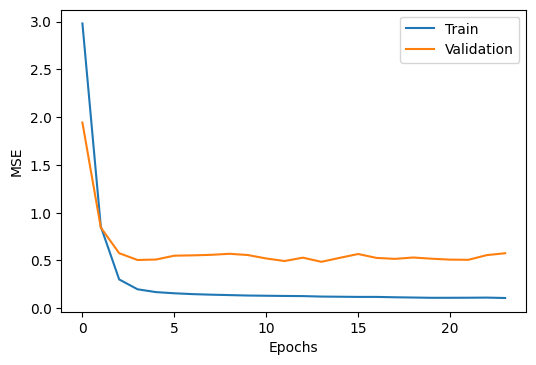

In [16]:
plt.figure(dpi=100)
plt.plot(result.history['loss'], color='C0', label='Train')
plt.plot(result.history['val_loss'], color='C1', label='Validation')
plt.legend()
plt.ylabel('MSE')
plt.xlabel('Epochs')